In [49]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit
from collections import defaultdict
import seaborn as sns


#oadeji01
df = pd.read_excel('c:\\Users\\olubu\\OneDrive - Tufts\\Bunmi - NavehLab-01\\Raman_Bunmi\\Master_Data\\Data_Master_Sheet1.xlsx', sheet_name = "Master")
df['exp'] = df['exp'].astype(str)

In [71]:
df#.iloc[:, 6:]

,exp,sample,trt_time,orient,spectra_num,details,details1,752.901,754.044,755.187,...,1727.14,1728.02,1728.9,1729.78,1730.66,1731.54,1732.42,1733.29,1734.17,1735.05
0,20250616,Ctrl,20mins,Orth,1,0616-Ctrl-20mins-Orth,Ctrl_20mins_Orth,-0.004580,0.014198,0.033234,...,0.063764,0.060871,0.058869,0.058241,0.058690,0.060554,0.064038,0.069348,0.076688,0.086265
1,20250616,Ctrl,20mins,Orth,2,0616-Ctrl-20mins-Orth,Ctrl_20mins_Orth,-0.002485,0.054030,0.099156,...,0.089793,0.091843,0.094528,0.097768,0.101272,0.104856,0.108352,0.111590,0.114402,0.116619
2,20250616,Ctrl,20mins,Orth,3,0616-Ctrl-20mins-Orth,Ctrl_20mins_Orth,-0.006735,0.049518,0.097465,...,0.305150,0.310110,0.314895,0.319764,0.324469,0.329269,0.334224,0.339393,0.344836,0.350614
3,20250616,Ctrl,20mins,Orth,4,0616-Ctrl-20mins-Orth,Ctrl_20mins_Orth,0.016831,0.032360,0.041923,...,0.140087,0.142750,0.144948,0.146399,0.147567,0.148977,0.150814,0.153261,0.156503,0.160724
4,20250616,Ctrl,20mins,Orth,5,0616-Ctrl-20mins-Orth,Ctrl_20mins_Orth,-0.002913,0.041236,0.079787,...,0.222366,0.224526,0.226351,0.227929,0.229314,0.230770,0.232435,0.234444,0.236937,0.240051
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
873,20250609,Trt,60mins,Para,5,0609-Trt-60mins-Para,Trt_60mins_Para,0.025701,0.019553,0.014295,...,0.153886,0.153877,0.152938,0.150287,0.146837,0.142780,0.138306,0.133605,0.128870,0.124290
874,20250609,Trt,60mins,Para,7,0609-Trt-60mins-Para,Trt_60mins_Para,-0.007358,0.022695,0.046221,...,0.316235,0.309218,0.304731,0.303583,0.304322,0.306906,0.311292,0.317438,0.325301,0.334838
875,20250609,Trt,60mins,Para,9,0609-Trt-60mins-Para,Trt_60mins_Para,0.133186,0.152916,0.159233,...,0.181936,0.182247,0.186264,0.191120,0.198225,0.207921,0.220552,0.236461,0.255989,0.279480
876,20250609,Trt,60mins,Para,11,0609-Trt-60mins-Para,Trt_60mins_Para,0.030676,0.015587,0.007095,...,0.191811,0.196527,0.201630,0.207425,0.213069,0.218280,0.222780,0.226290,0.228528,0.229216


In [80]:
df['exp']+'_'+df['details1']

0      20250616_Ctrl_20mins_Orth
1      20250616_Ctrl_20mins_Orth
2      20250616_Ctrl_20mins_Orth
3      20250616_Ctrl_20mins_Orth
4      20250616_Ctrl_20mins_Orth
                 ...            
873     20250609_Trt_60mins_Para
874     20250609_Trt_60mins_Para
875     20250609_Trt_60mins_Para
876     20250609_Trt_60mins_Para
877     20250609_Trt_60mins_Para
Length: 878, dtype: object

In [72]:
# --- Peak models ---
def gaussian(x, amp, cen, wid):
    return amp * np.exp(-(x - cen) ** 2 / (2 * wid ** 2))

def lorentzian(x, amp, cen, wid):
    return amp * (wid**2 / ((x - cen)**2 + wid**2))

# --- Peak fitting function ---
def fit_peak(x, y, peak_pos, window=5, model="gaussian", max_width=np.inf):
    # Subset spectrum around the suggested peak
    mask = (x >= peak_pos - window) & (x <= peak_pos + window)
    x_region, y_region = x[mask], y[mask]

    if len(x_region) < 5:  # too few points to fit
        return None

    # Initial guess
    amp_guess = np.max(y_region)
    cen_guess = x_region[np.argmax(y_region)]
    wid_guess = (x_region[-1] - x_region[0]) / 4

    if model == "gaussian":
        func = gaussian
    else:
        func = lorentzian

    try:
        popt, _ = curve_fit(func, x_region, y_region, p0=[amp_guess, cen_guess, wid_guess],
                            bounds = (
                                [0, peak_pos - window, 0],             # lower bounds
                                    [np.inf, peak_pos + window, max_width] # upper bounds (width limited)
                            ))
        amp, cen, wid = popt

        # Area and FWHM formulas
        if model == "gaussian":
            fwhm = 2.3548 * wid
            area = amp * wid * np.sqrt(2 * np.pi)
        else:  # Lorentzian
            fwhm = 2 * wid
            area = np.pi * amp * wid

        return {"peak_pos": peak_pos, "fit_pos": cen, "amp": amp, "fwhm": fwhm, "area": area}

    except RuntimeError:
        return None

# --- Main function ---
def analyze_spectra(df, peak_positions, model="gaussian"):
    results = []
    x = df.iloc[:, 7:].columns.astype(float).values

    # Average spectra by group
   # grouped = df.drop(['exp', 'spectra_num'], axis=1).groupby("details").mean(numeric_only=True)
    dff = df.iloc[:, 6:].set_index(['details1', 'exp'])

    for peak in peak_positions:
        for group, spectrum in dff.iterrows():
        #grouped.iterrows():
            y = spectrum.values
            fit = fit_peak(x, y, peak, model=model)
            if fit:
                fit["group"] = group
                results.append(fit)

                # Plot
                '''plt.figure(figsize=(6, 4))
                plt.plot(x, y, label=f"{group} spectrum")
                plt.axvline(peak, color="gray", linestyle="--", lw=0.5, label="suggested peak")

                # Overlay fitted peak
                if model == "gaussian":
                    fit_curve = gaussian(x, fit["amp"], fit["fit_pos"], fit["fwhm"]/2.3548)
                else:
                    fit_curve = lorentzian(x, fit["amp"], fit["fit_pos"], fit["fwhm"]/2)
                plt.plot(x, fit_curve, "r--", label=f"Fitted {model}")

                plt.title(f"Peak fit near {peak} cm⁻¹ ({group})")
                plt.xlabel("Raman Shift (cm⁻¹)")
                plt.ylabel("Intensity (a.u.)")
                plt.legend()
                plt.show()'''

    return pd.DataFrame(results)



In [78]:
df#.iloc[:, 6:].set_index(['details1', 'exp'])

,exp,sample,trt_time,orient,spectra_num,details,details1,752.901,754.044,755.187,...,1727.14,1728.02,1728.9,1729.78,1730.66,1731.54,1732.42,1733.29,1734.17,1735.05
0,20250616,Ctrl,20mins,Orth,1,0616-Ctrl-20mins-Orth,Ctrl_20mins_Orth,-0.004580,0.014198,0.033234,...,0.063764,0.060871,0.058869,0.058241,0.058690,0.060554,0.064038,0.069348,0.076688,0.086265
1,20250616,Ctrl,20mins,Orth,2,0616-Ctrl-20mins-Orth,Ctrl_20mins_Orth,-0.002485,0.054030,0.099156,...,0.089793,0.091843,0.094528,0.097768,0.101272,0.104856,0.108352,0.111590,0.114402,0.116619
2,20250616,Ctrl,20mins,Orth,3,0616-Ctrl-20mins-Orth,Ctrl_20mins_Orth,-0.006735,0.049518,0.097465,...,0.305150,0.310110,0.314895,0.319764,0.324469,0.329269,0.334224,0.339393,0.344836,0.350614
3,20250616,Ctrl,20mins,Orth,4,0616-Ctrl-20mins-Orth,Ctrl_20mins_Orth,0.016831,0.032360,0.041923,...,0.140087,0.142750,0.144948,0.146399,0.147567,0.148977,0.150814,0.153261,0.156503,0.160724
4,20250616,Ctrl,20mins,Orth,5,0616-Ctrl-20mins-Orth,Ctrl_20mins_Orth,-0.002913,0.041236,0.079787,...,0.222366,0.224526,0.226351,0.227929,0.229314,0.230770,0.232435,0.234444,0.236937,0.240051
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
873,20250609,Trt,60mins,Para,5,0609-Trt-60mins-Para,Trt_60mins_Para,0.025701,0.019553,0.014295,...,0.153886,0.153877,0.152938,0.150287,0.146837,0.142780,0.138306,0.133605,0.128870,0.124290
874,20250609,Trt,60mins,Para,7,0609-Trt-60mins-Para,Trt_60mins_Para,-0.007358,0.022695,0.046221,...,0.316235,0.309218,0.304731,0.303583,0.304322,0.306906,0.311292,0.317438,0.325301,0.334838
875,20250609,Trt,60mins,Para,9,0609-Trt-60mins-Para,Trt_60mins_Para,0.133186,0.152916,0.159233,...,0.181936,0.182247,0.186264,0.191120,0.198225,0.207921,0.220552,0.236461,0.255989,0.279480
876,20250609,Trt,60mins,Para,11,0609-Trt-60mins-Para,Trt_60mins_Para,0.030676,0.015587,0.007095,...,0.191811,0.196527,0.201630,0.207425,0.213069,0.218280,0.222780,0.226290,0.228528,0.229216


In [73]:
#With sum plot

def plot_spectra(df, peak_positions, model="gaussian"):
    x = df.iloc[:, 7:].columns.astype(float).values
    grouped = df.drop(['spectra_num'], axis=1).groupby(["details1", 'exp']).mean(numeric_only=True)#.reset_index()

    for group, spectrum in grouped.iterrows():
        y = spectrum.values
        fits_for_group = []
        peak_curves = []

        plt.figure(figsize=(10, 5))
        plt.plot(x, y, label=f"{group} spectrum", color="black")

        # --- Step 1: local peak fits (same as before) ---
        for peak in peak_positions:
            fit = fit_peak(x, y, peak, model=model, max_width=30)
            if fit:
                fit["group"] = group
                fits_for_group.append(fit)

                # overlay fitted curve
                if model == "gaussian":
                    fit_curve = gaussian(x, fit["amp"], fit["fit_pos"], fit["fwhm"]/2.3548)
                else:  # lorentzian
                    fit_curve = lorentzian(x, fit["amp"], fit["fit_pos"], fit["fwhm"]/2)

                peak_curves.append(fit_curve)
                plt.plot(x, fit_curve, "--", label=f"Fit @ {fit['fit_pos']:.1f} cm⁻¹")
                plt.axvline(peak, color="gray", linestyle=":", lw=0.8)

        # --- Step 2: global composite fit (NEW) ---
        if fits_for_group:
            from scipy.optimize import curve_fit

            def sum_of_gauss_lin(x, *params):
                n = len(fits_for_group)
                y_fit = np.zeros_like(x)
                for i in range(n):
                    a, c, w = params[3*i:3*i+3]
                    y_fit += gaussian(x, a, c, w)
                # add linear baseline
                b0, b1 = params[-2], params[-1]
                return y_fit + (b0 + b1*x)

            # initial guesses from local fits
            p0, lb, ub = [], [], []
            for fit in fits_for_group:
                a0 = fit["amp"]
                c0 = fit["fit_pos"]
                w0 = fit["fwhm"]/2.3548 if model == "gaussian" else fit["fwhm"]/2
                p0 += [a0, c0, w0]
                lb += [0, c0-5, 0.2]       # tighter bounds
                ub += [np.inf, c0+5, 100]

            # baseline params
            p0 += [0, 0]
            lb += [-np.inf, -np.inf]
            ub += [np.inf, np.inf]

            try:
                popt, _ = curve_fit(sum_of_gauss_lin, x, y, p0=p0, bounds=(lb, ub), maxfev=20000)
                y_sum_refined = sum_of_gauss_lin(x, *popt)
                plt.plot(x, y_sum_refined, "r-", linewidth=2, label="Global composite fit", alpha = .6)

                # optional residuals metric
                residuals = y - y_sum_refined
                ss_res = np.sum(residuals**2)
                ss_tot = np.sum((y - np.mean(y))**2)
                print(f"{group} R² of global fit: {1 - ss_res/ss_tot:.4f}")

            except RuntimeError:
                print(f"Global fit failed for {group}")

        plt.title(f"Peak fits for {group}")
        plt.xlabel("Raman Shift (cm⁻¹)")
        plt.ylabel("Intensity (a.u.)")
        plt.xticks(np.arange(750, 1800, 100))
        plt.legend(fontsize=8, bbox_to_anchor=(1, 1))
        plt.tight_layout()
        plt.show()


In [76]:
results

('Ctrl_20mins_Orth', '20250429') R² of global fit: 0.9937


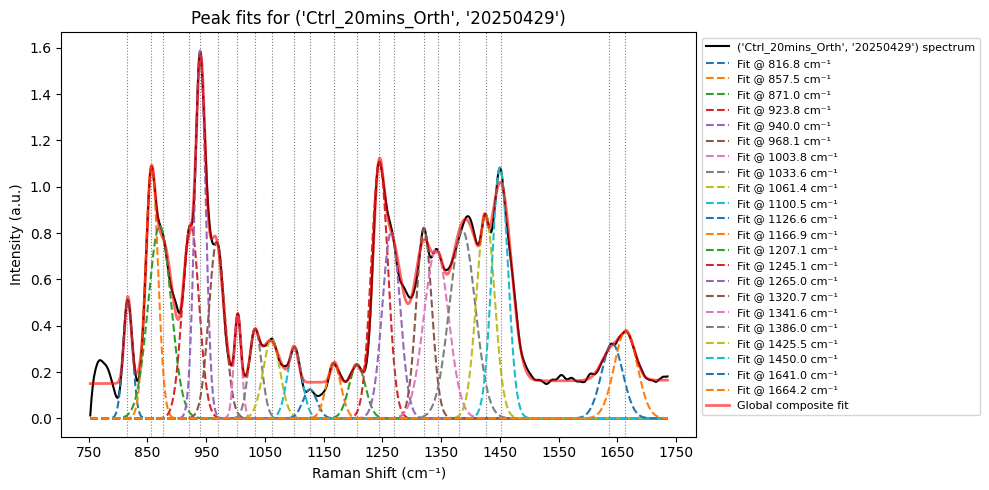

('Ctrl_20mins_Orth', '20250501') R² of global fit: 0.9962


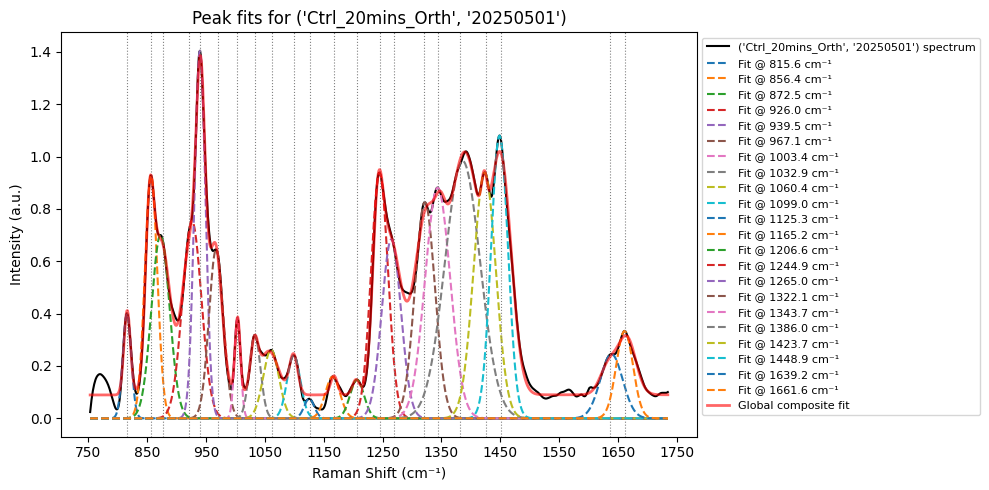

('Ctrl_20mins_Orth', '20250609') R² of global fit: 0.9942


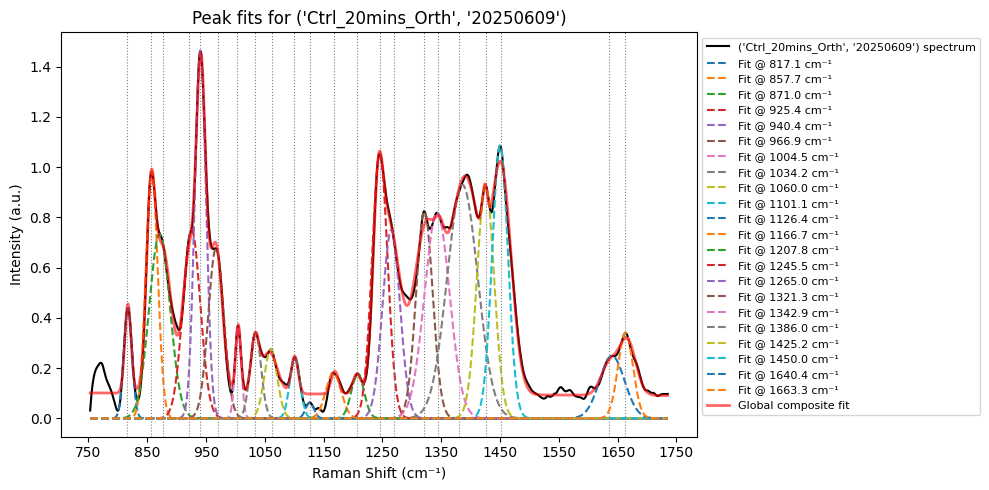

('Ctrl_20mins_Orth', '20250612') R² of global fit: 0.9956


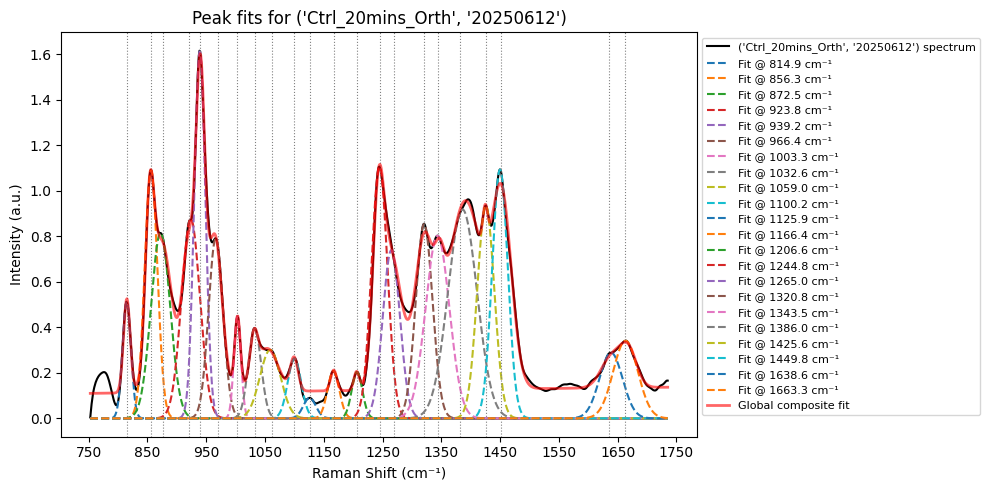

('Ctrl_20mins_Orth', '20250616') R² of global fit: 0.9908


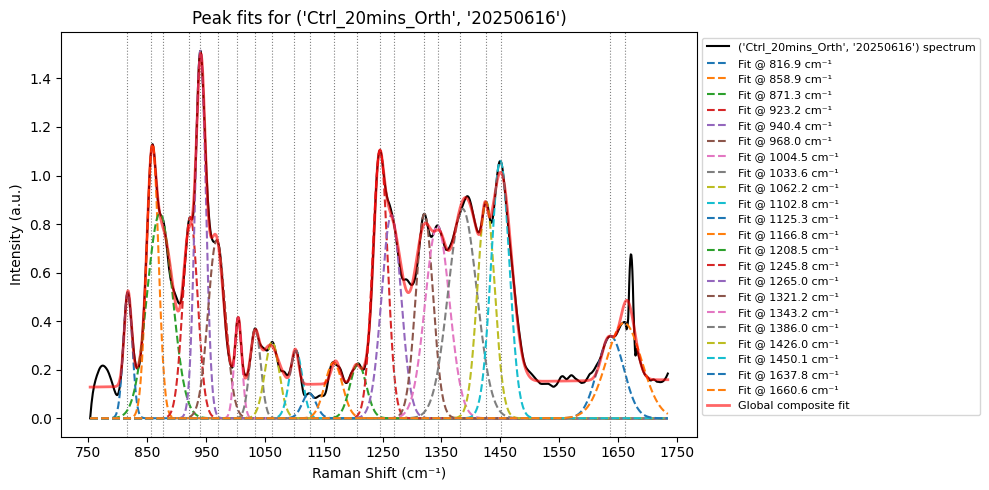

('Ctrl_20mins_Para', '20250429') R² of global fit: 0.9952


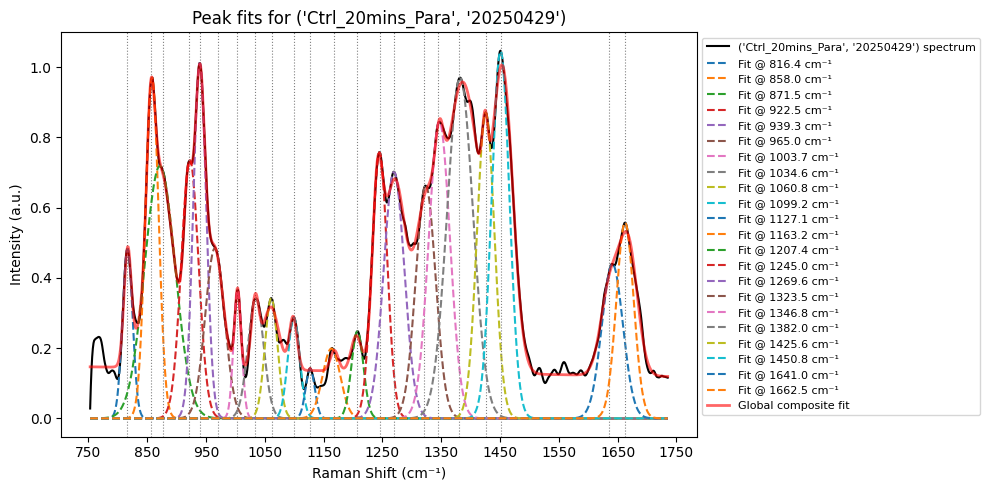

('Ctrl_20mins_Para', '20250501') R² of global fit: 0.9965


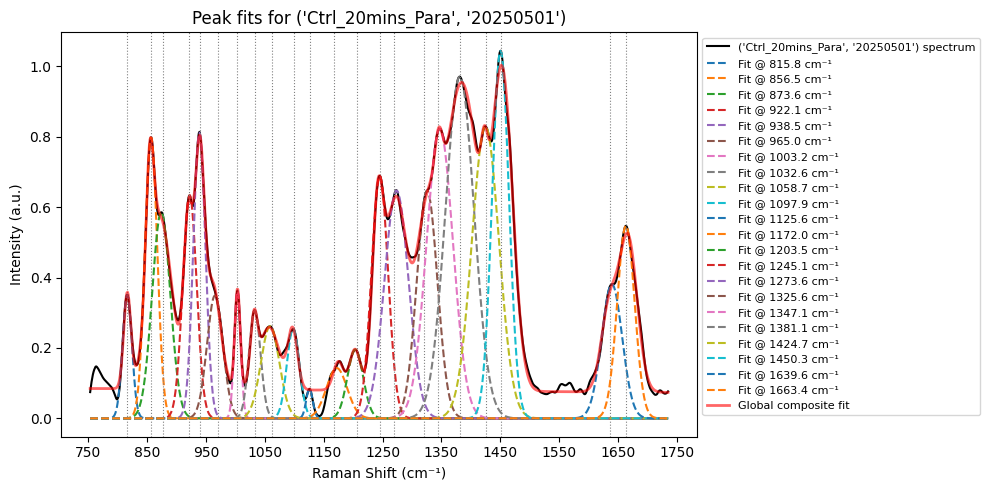

('Ctrl_20mins_Para', '20250609') R² of global fit: 0.9968


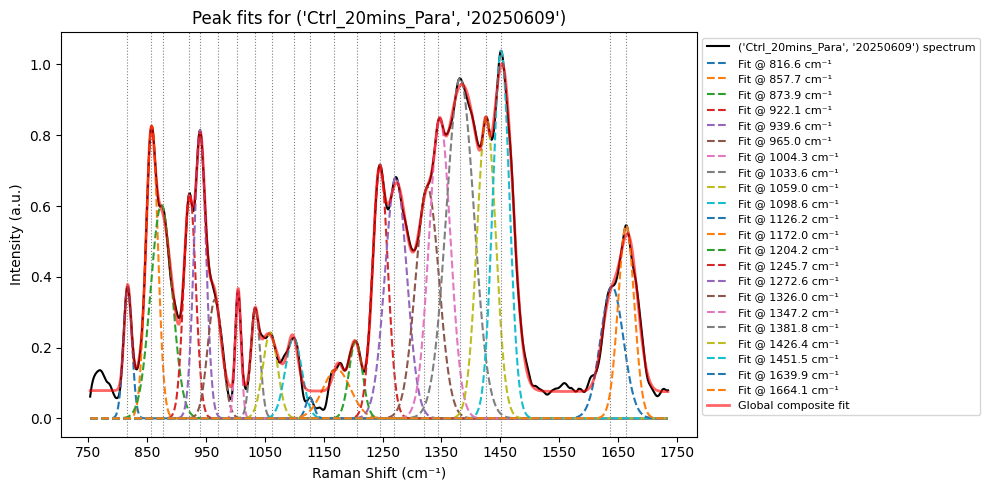

('Ctrl_20mins_Para', '20250612') R² of global fit: 0.9962


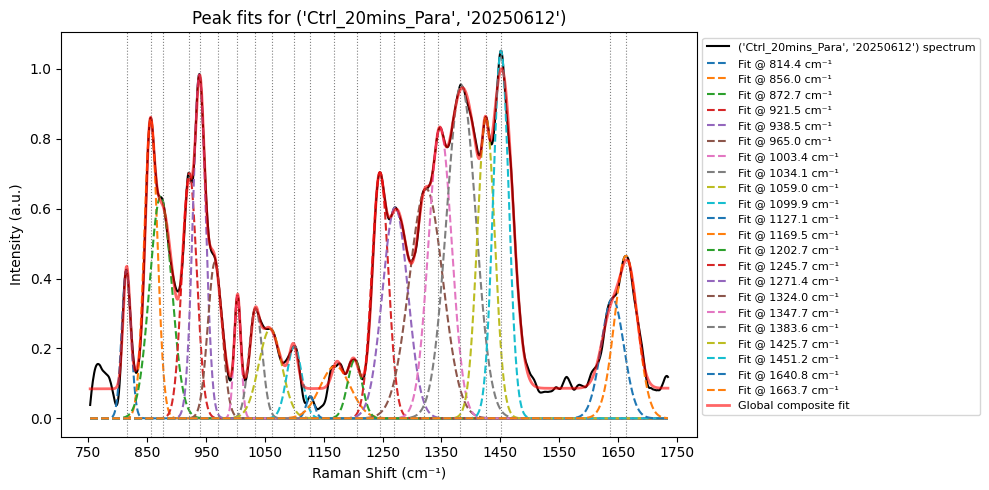

('Ctrl_20mins_Para', '20250616') R² of global fit: 0.9971


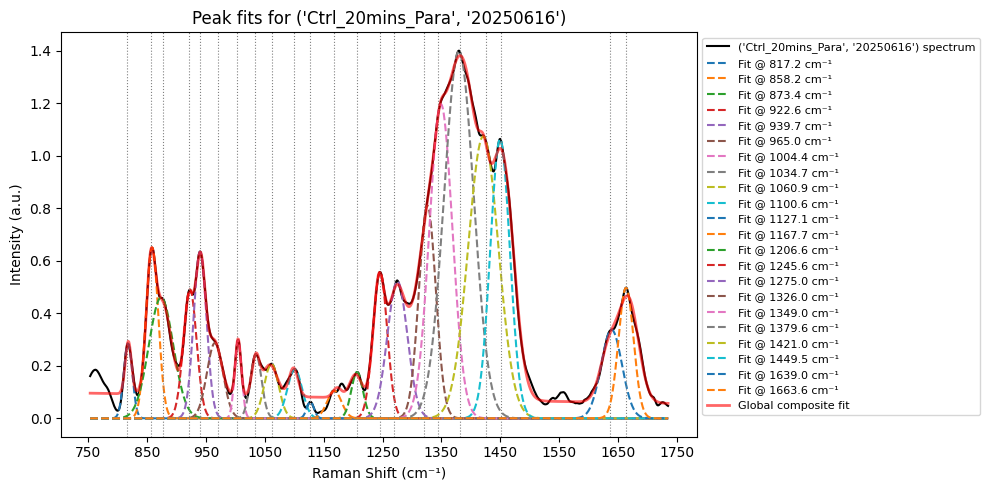

('Ctrl_24h_Orth', '20250429') R² of global fit: 0.9948


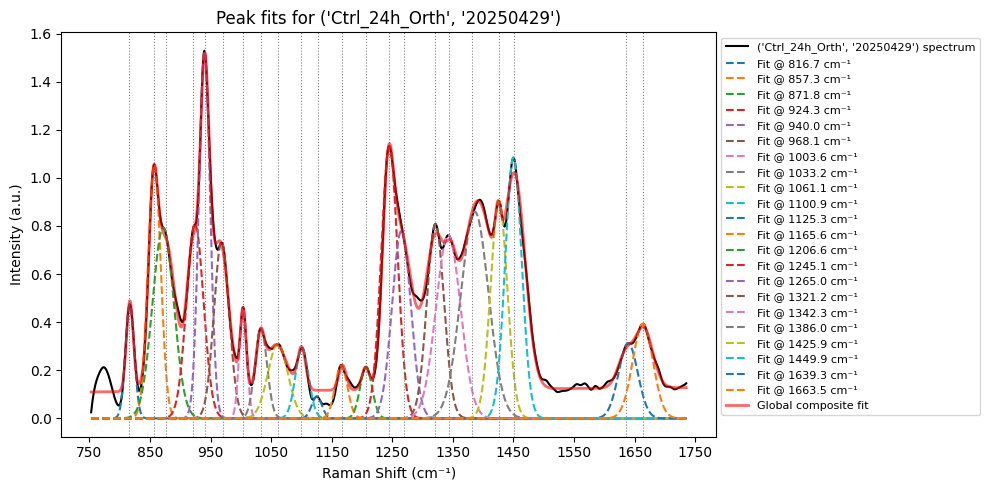

('Ctrl_24h_Orth', '20250501') R² of global fit: 0.9956


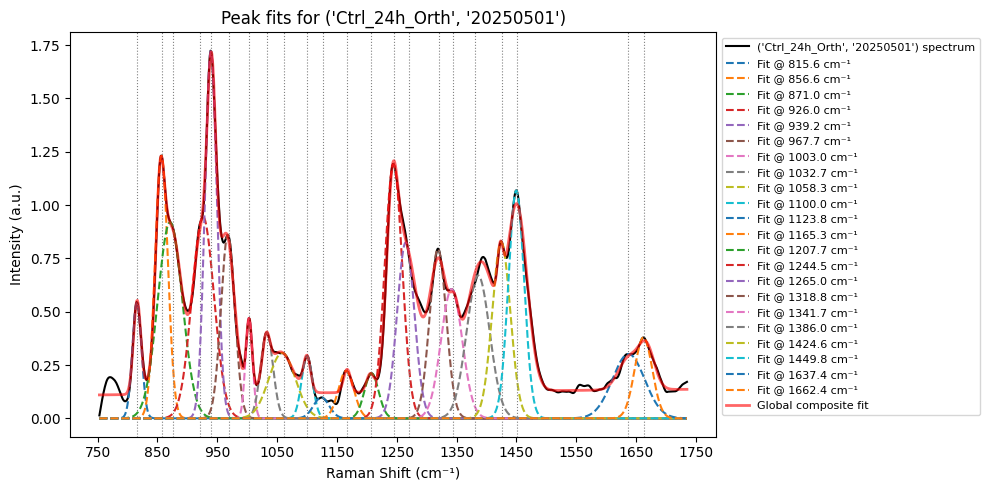

('Ctrl_24h_Orth', '20250609') R² of global fit: 0.9957


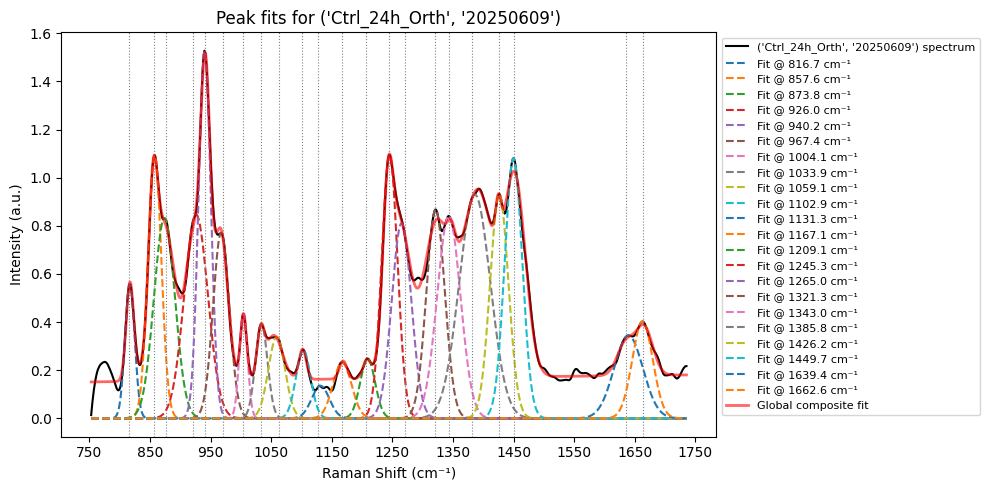

('Ctrl_24h_Orth', '20250612') R² of global fit: 0.9954


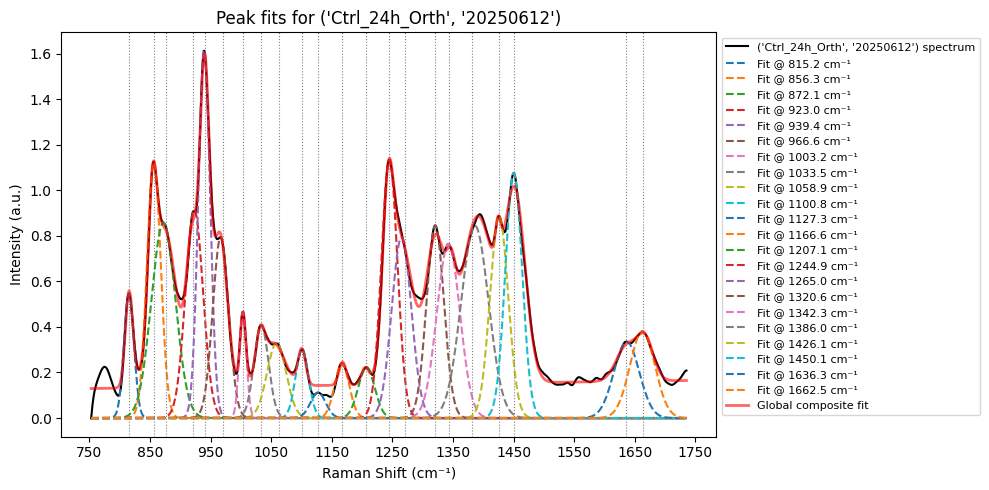

('Ctrl_24h_Orth', '20250616') R² of global fit: 0.9962


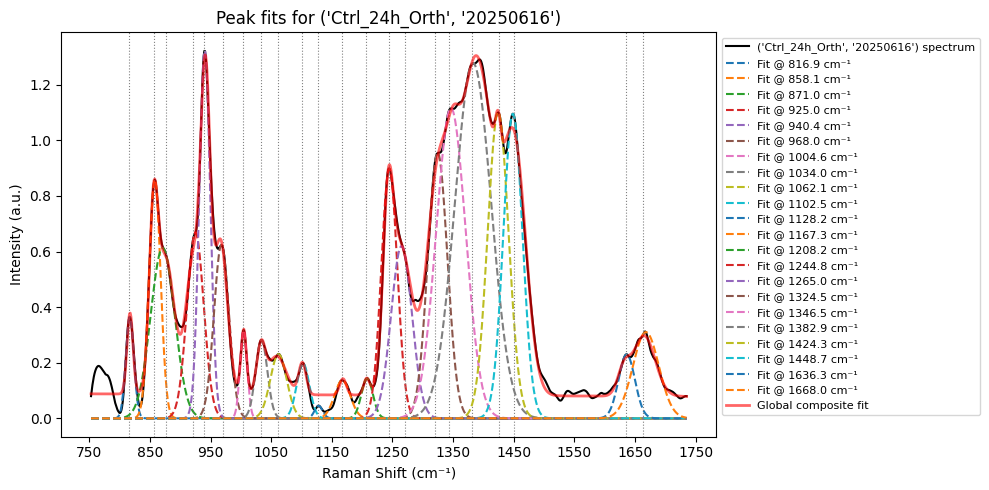

('Ctrl_24h_Para', '20250429') R² of global fit: 0.9955


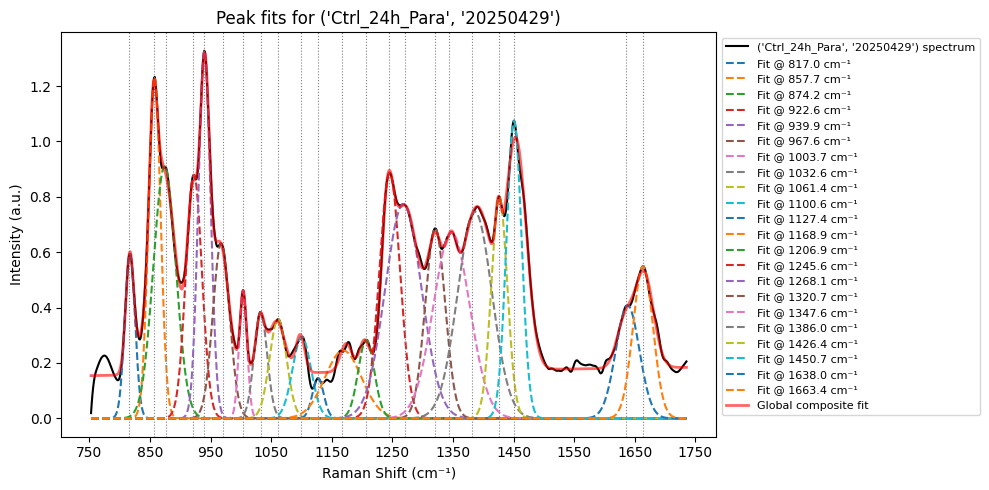

('Ctrl_24h_Para', '20250501') R² of global fit: 0.9972


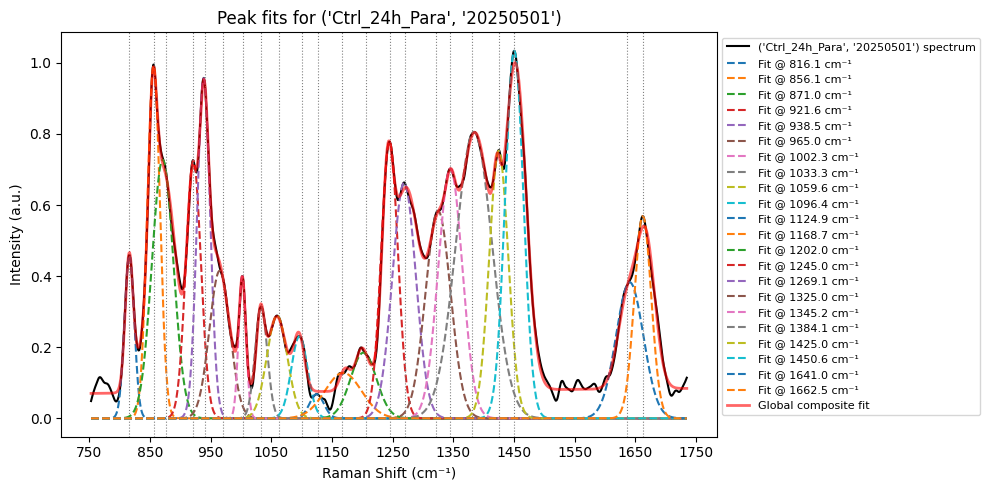

('Ctrl_24h_Para', '20250609') R² of global fit: 0.9959


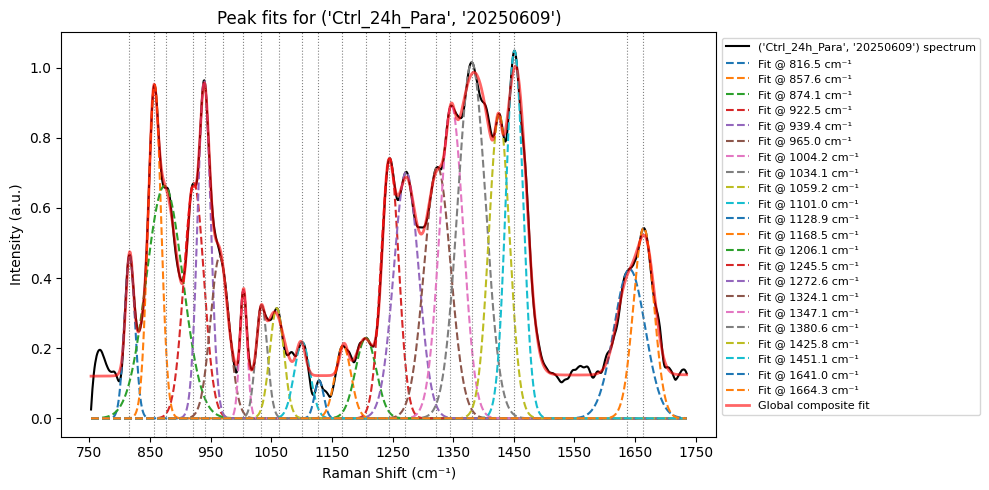

('Ctrl_24h_Para', '20250612') R² of global fit: 0.9969


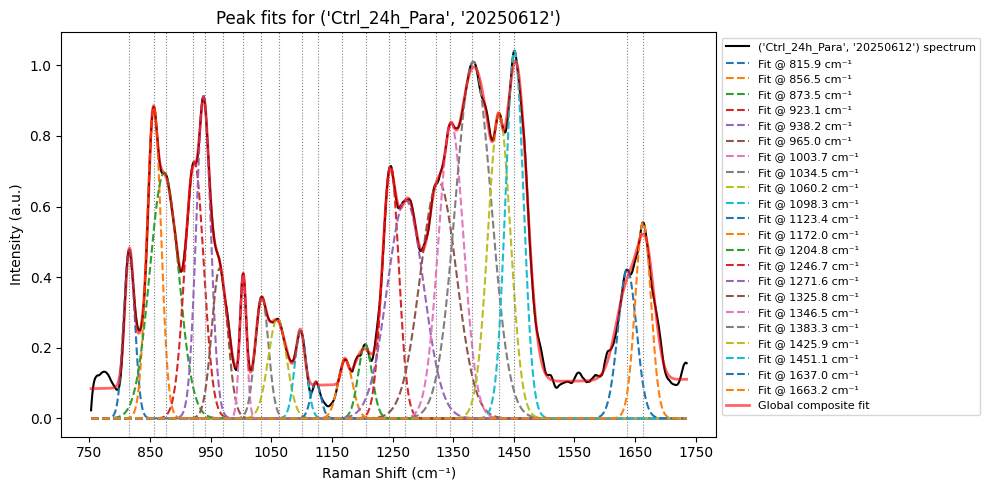

('Ctrl_24h_Para', '20250616') R² of global fit: 0.9957


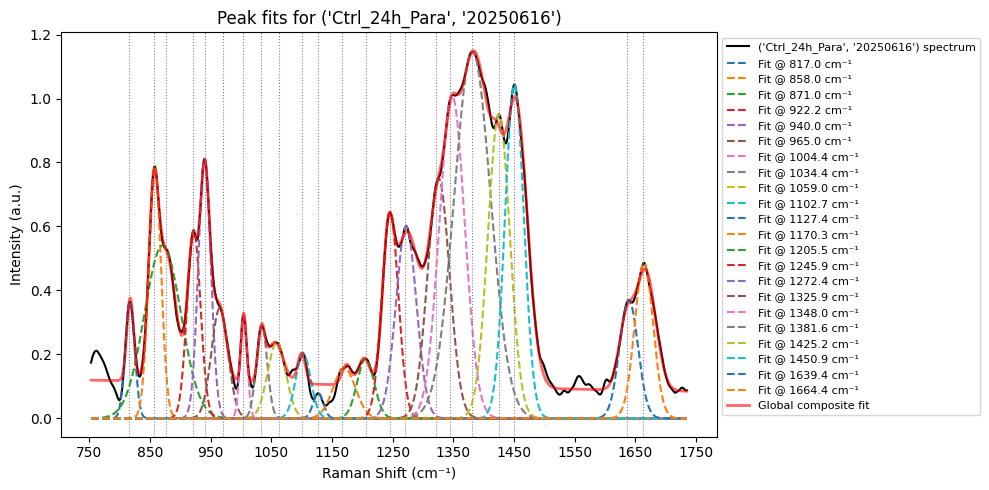

('Ctrl_2mins_Orth', '20250429') R² of global fit: 0.9940


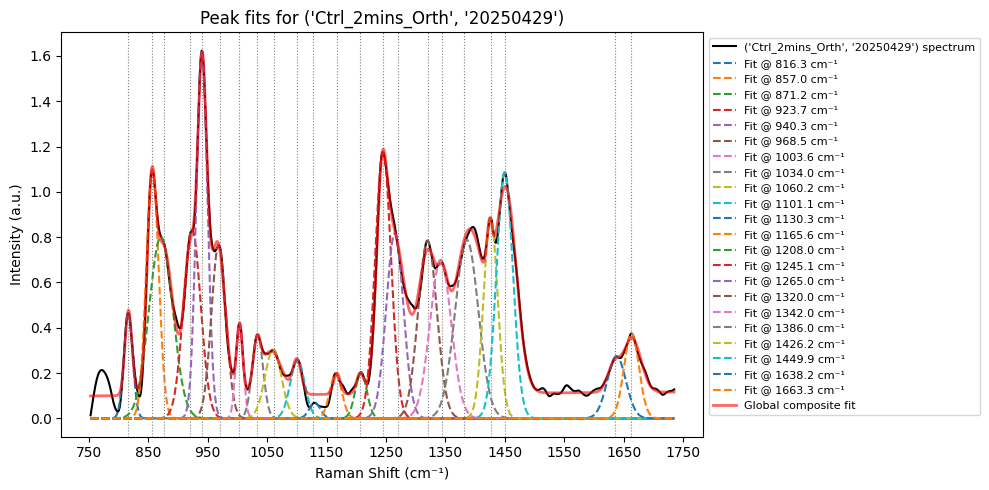

('Ctrl_2mins_Orth', '20250501') R² of global fit: 0.9971


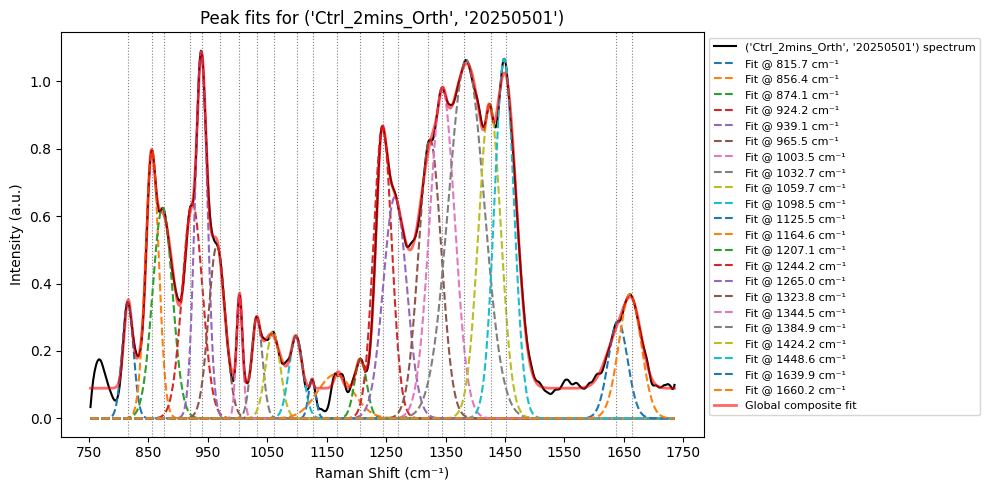

('Ctrl_2mins_Orth', '20250609') R² of global fit: 0.9980


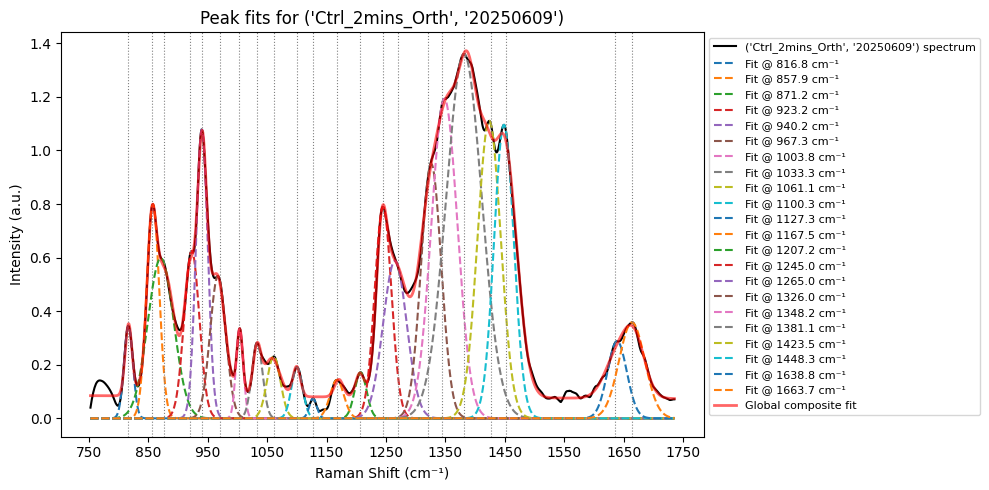

('Ctrl_2mins_Orth', '20250612') R² of global fit: 0.9960


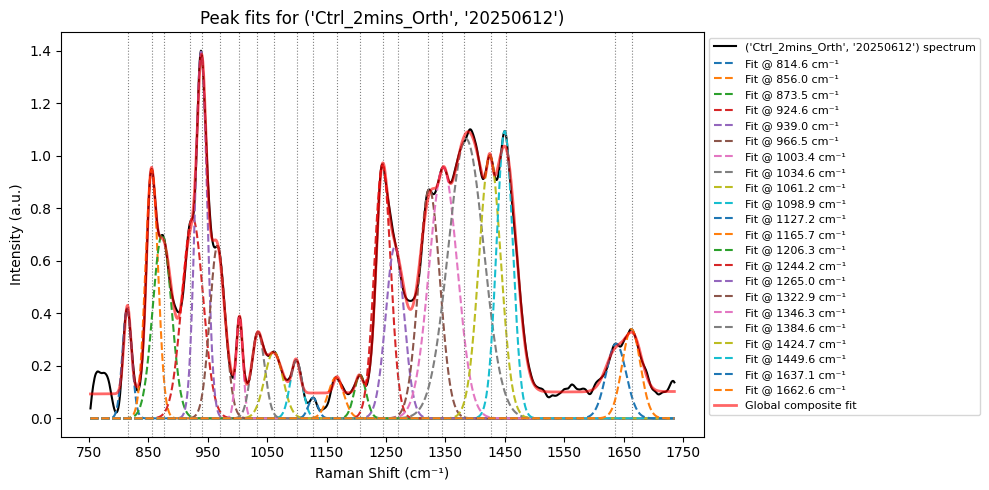

('Ctrl_2mins_Orth', '20250616') R² of global fit: 0.9958


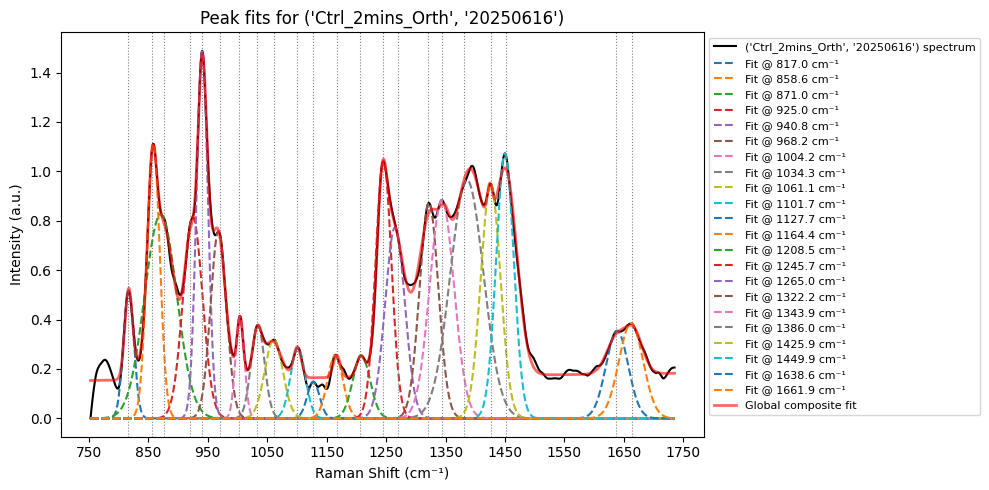

('Ctrl_2mins_Para', '20250429') R² of global fit: 0.9942


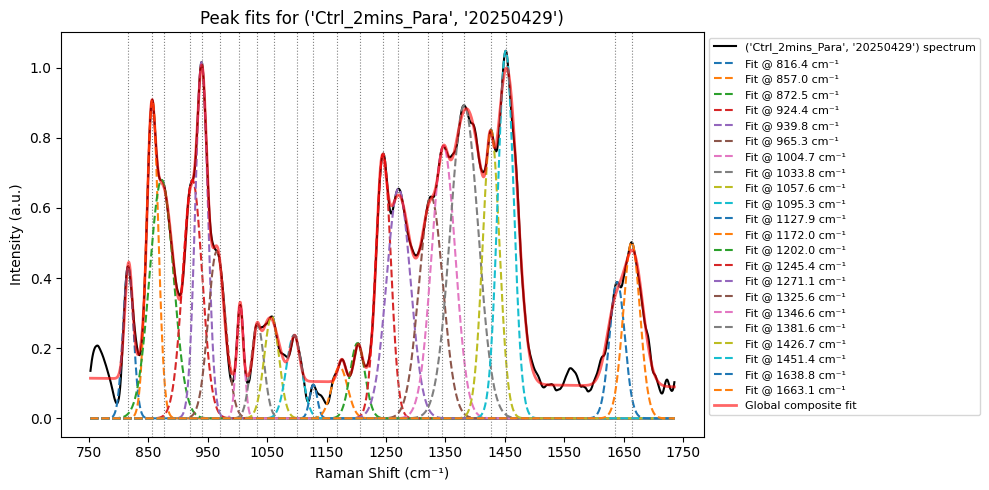

('Ctrl_2mins_Para', '20250501') R² of global fit: 0.9970


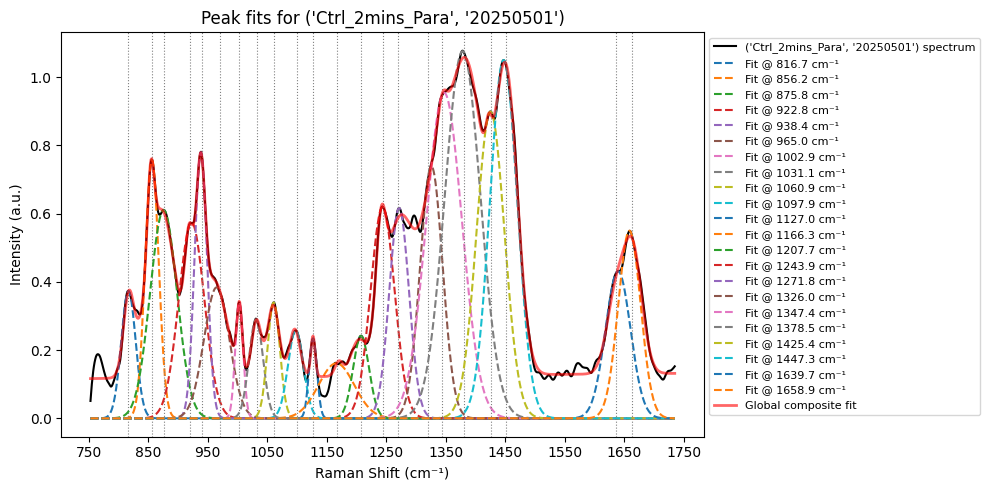

('Ctrl_2mins_Para', '20250609') R² of global fit: 0.9974


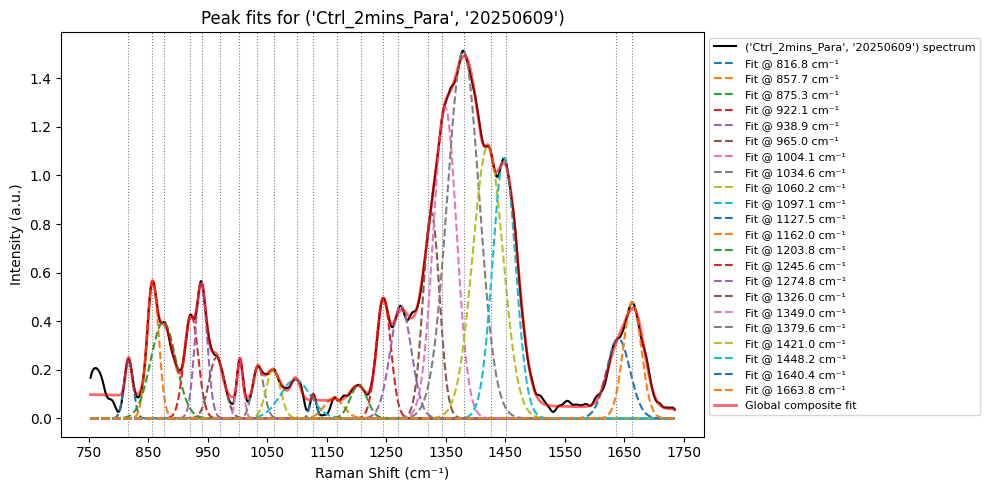

('Ctrl_2mins_Para', '20250612') R² of global fit: 0.9971


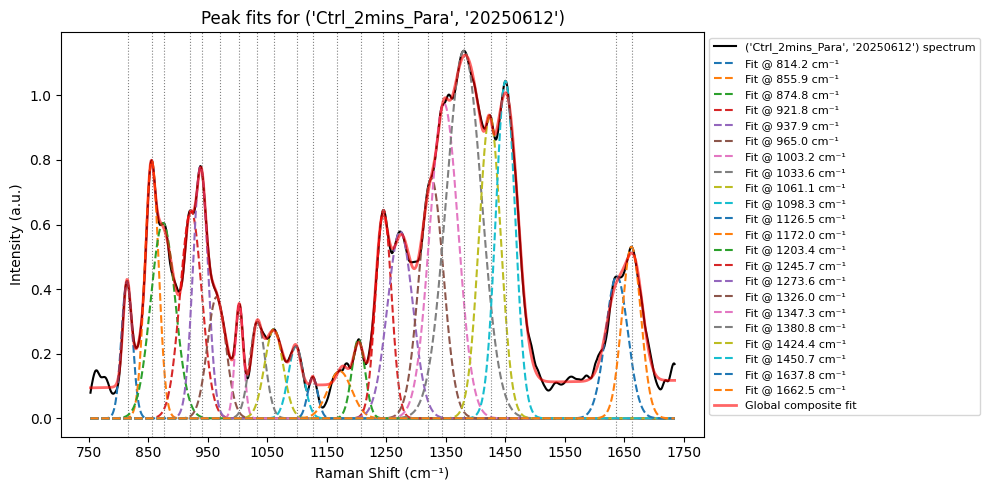

('Ctrl_2mins_Para', '20250616') R² of global fit: 0.9979


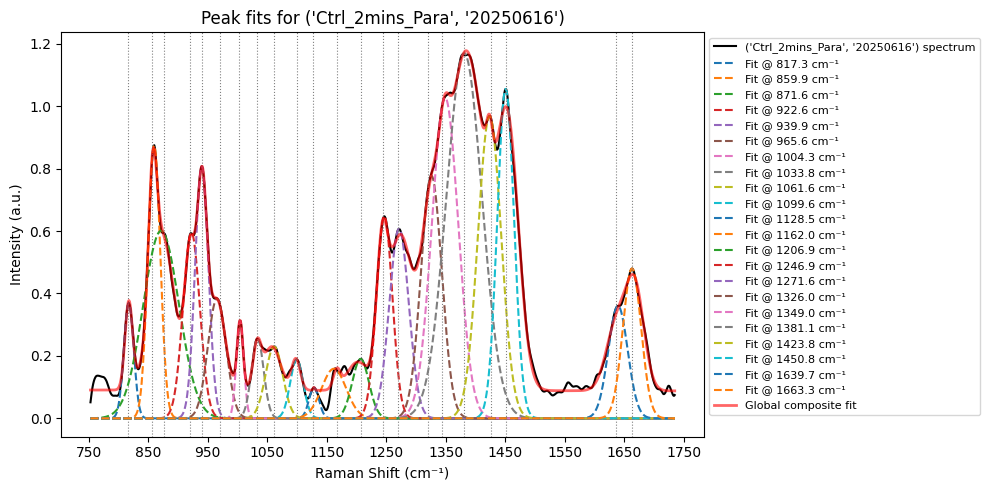

('Ctrl_40mins_Orth', '20250429') R² of global fit: 0.9943


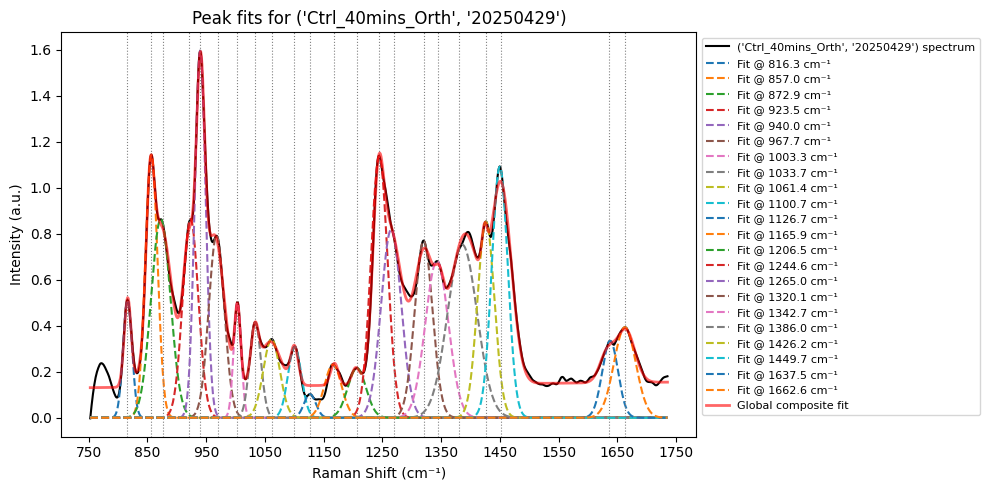

('Ctrl_40mins_Orth', '20250501') R² of global fit: 0.9963


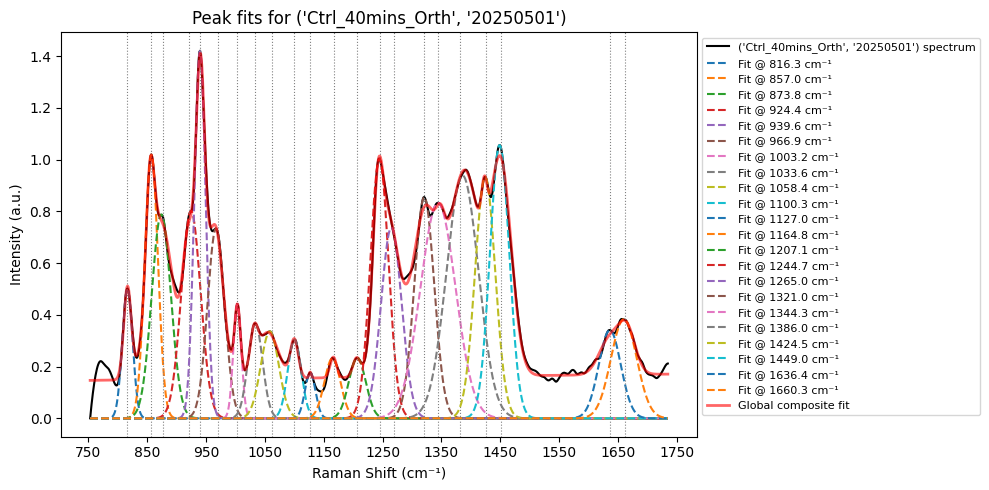

('Ctrl_40mins_Orth', '20250609') R² of global fit: 0.9971


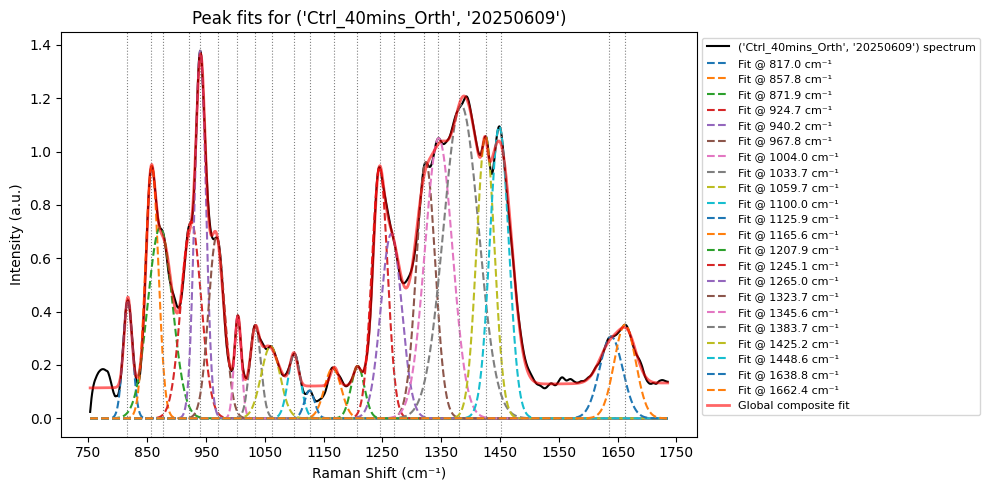

('Ctrl_40mins_Orth', '20250612') R² of global fit: 0.9951


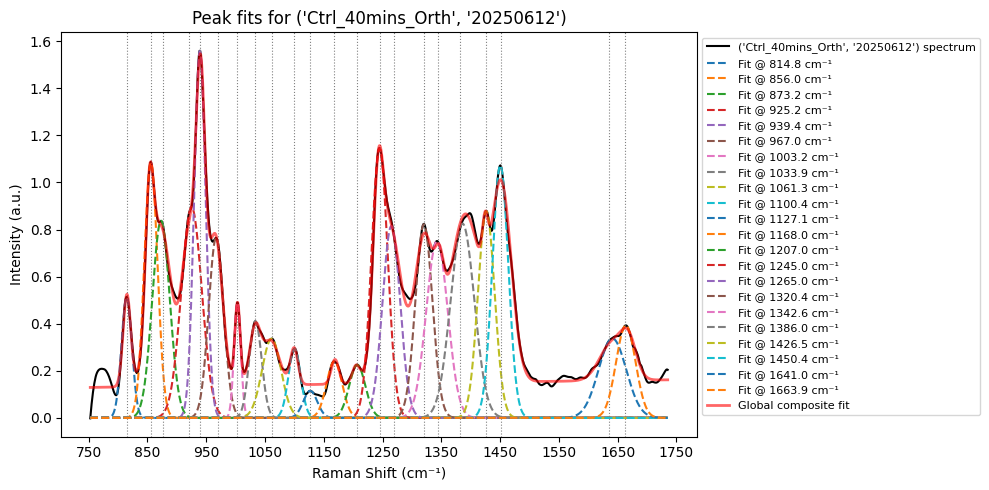

('Ctrl_40mins_Orth', '20250616') R² of global fit: 0.9947


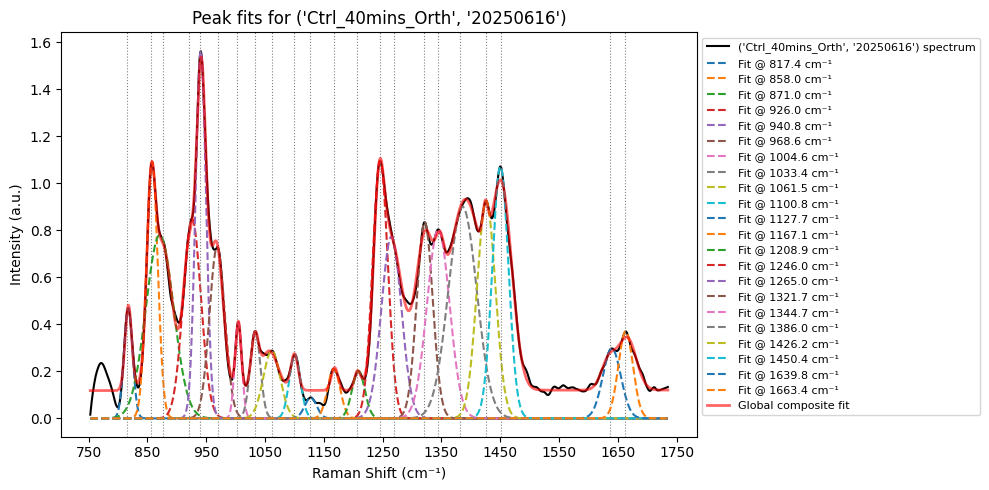

('Ctrl_40mins_Para', '20250429') R² of global fit: 0.9947


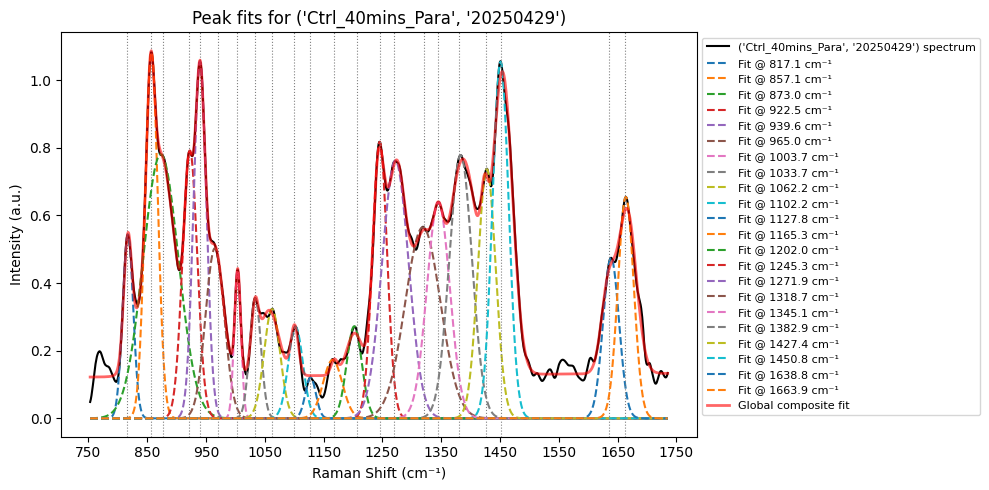

('Ctrl_40mins_Para', '20250501') R² of global fit: 0.9972


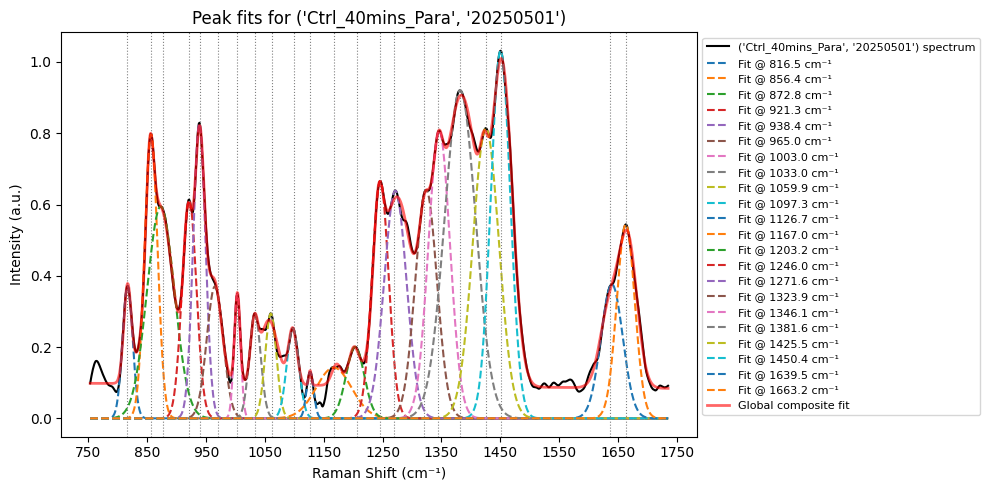

('Ctrl_40mins_Para', '20250609') R² of global fit: 0.9974


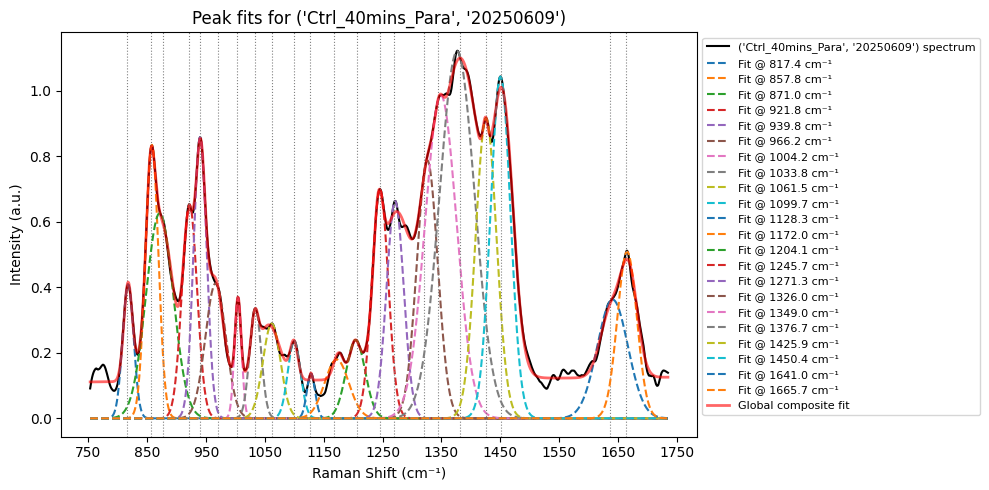

('Ctrl_40mins_Para', '20250612') R² of global fit: 0.9966


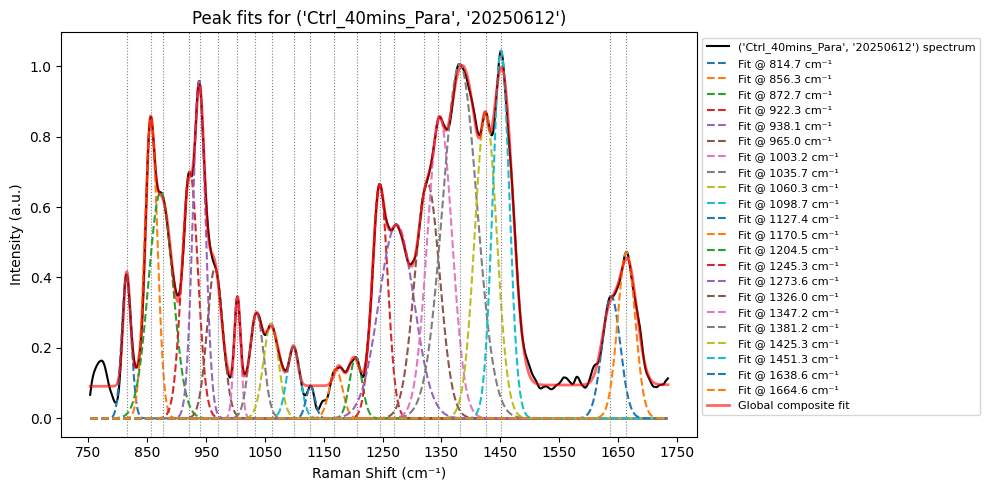

('Ctrl_40mins_Para', '20250616') R² of global fit: 0.9954


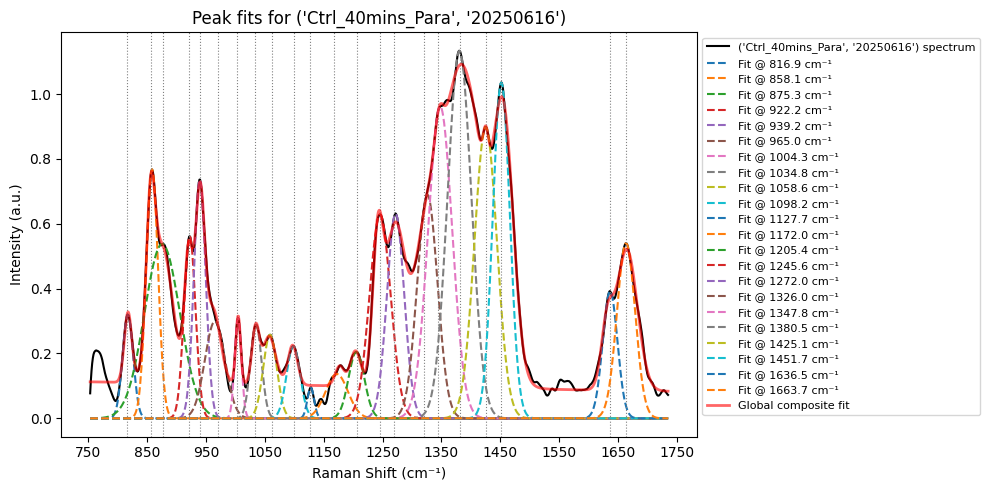

('Ctrl_60mins_Orth', '20250429') R² of global fit: 0.9948


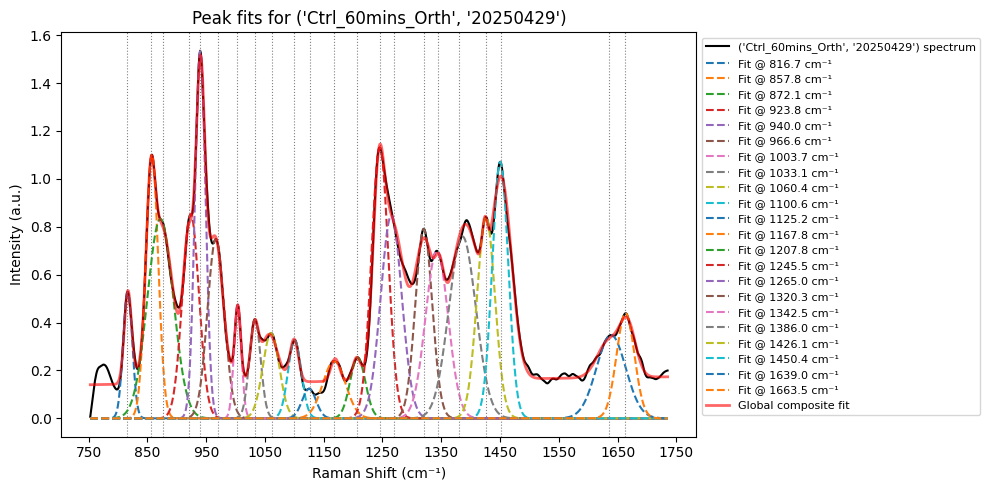

('Ctrl_60mins_Orth', '20250501') R² of global fit: 0.9946


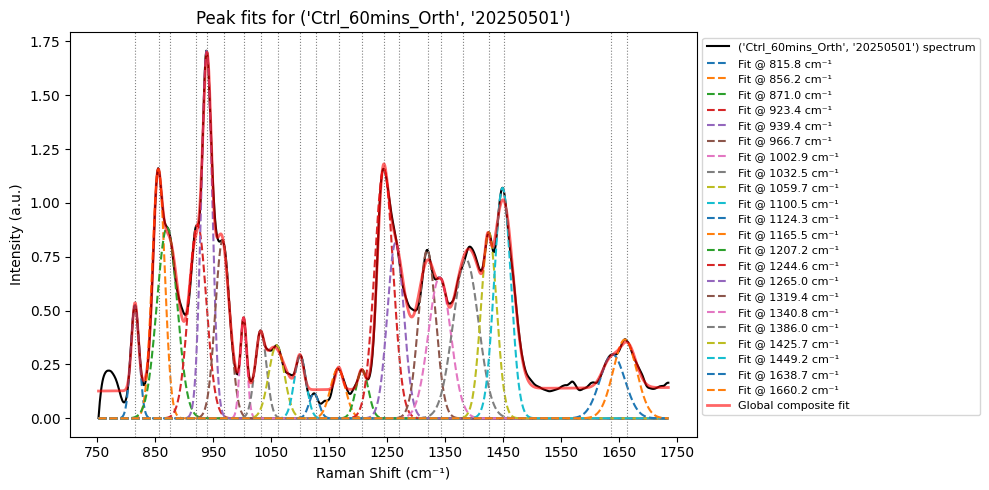

('Ctrl_60mins_Orth', '20250609') R² of global fit: 0.9950


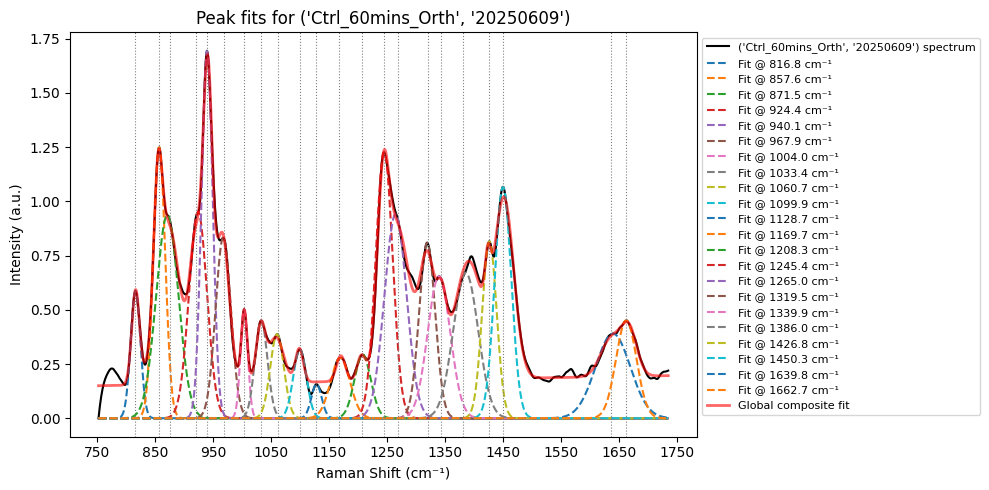

('Ctrl_60mins_Orth', '20250612') R² of global fit: 0.9955


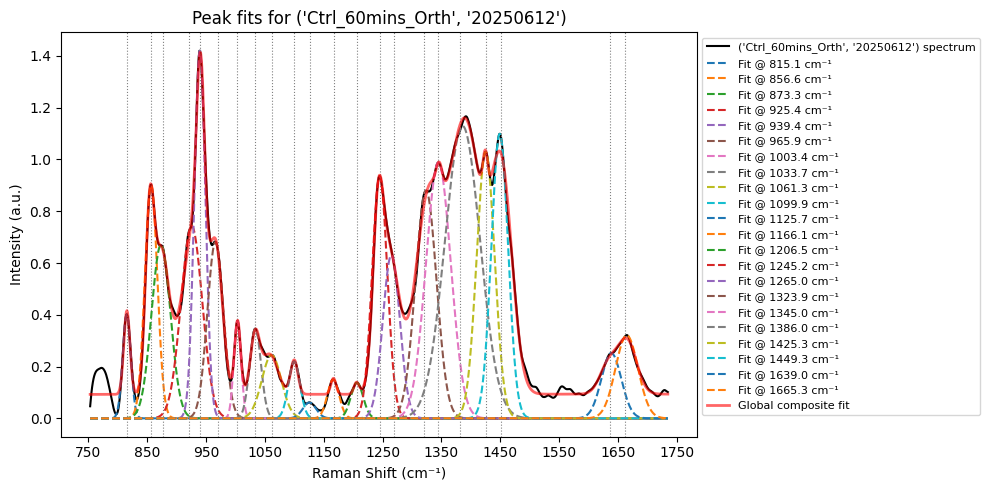

('Ctrl_60mins_Orth', '20250616') R² of global fit: 0.9960


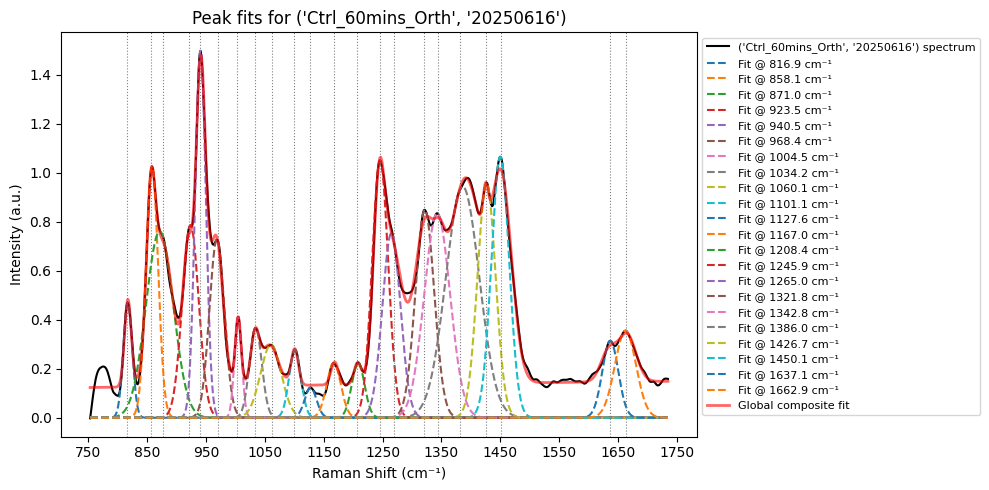

('Ctrl_60mins_Para', '20250429') R² of global fit: 0.9963


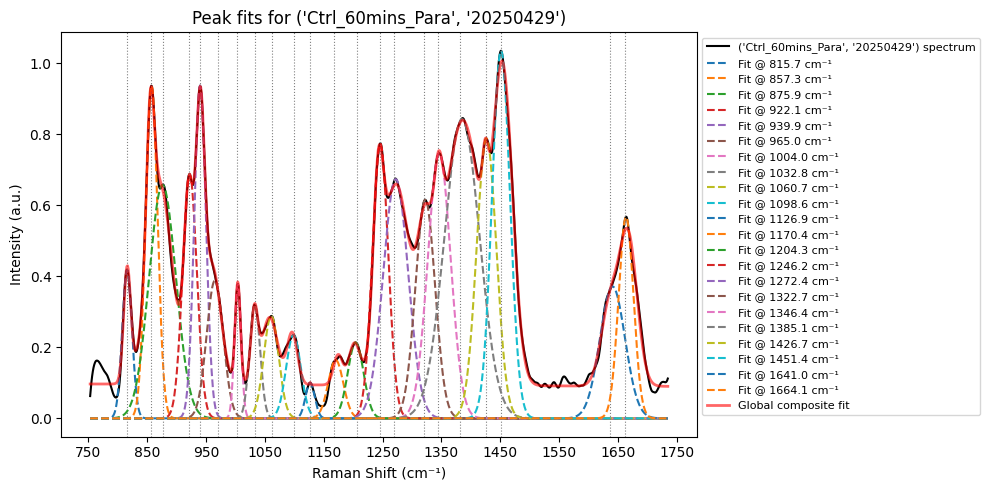

('Ctrl_60mins_Para', '20250501') R² of global fit: 0.9964


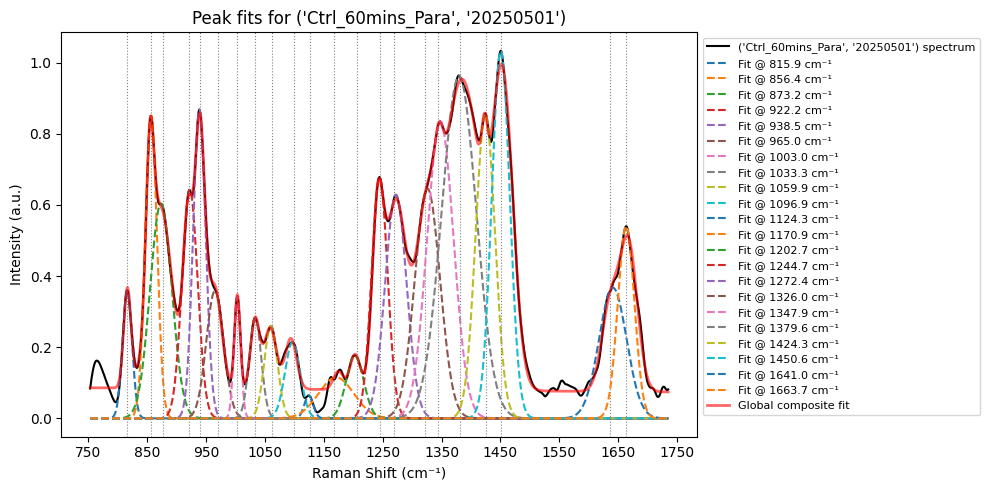

('Ctrl_60mins_Para', '20250609') R² of global fit: 0.9956


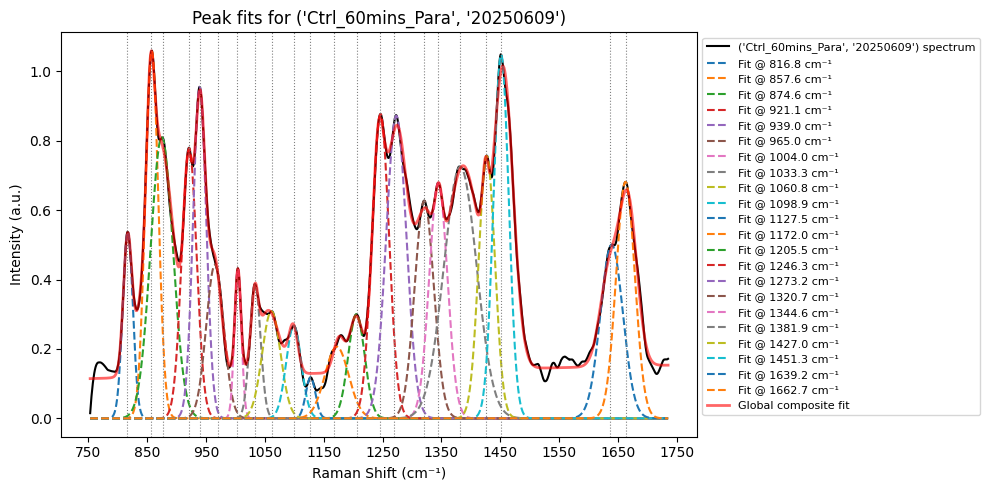

('Ctrl_60mins_Para', '20250612') R² of global fit: 0.9967


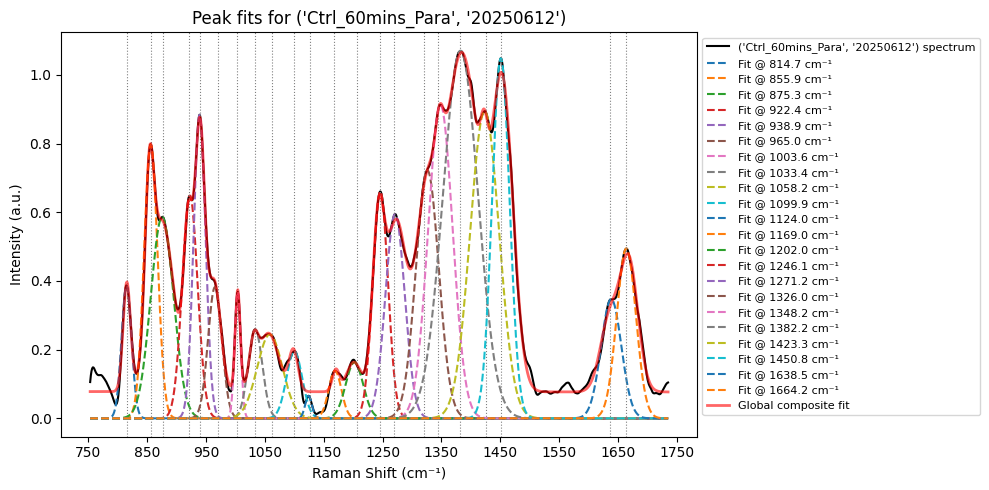

('Ctrl_60mins_Para', '20250616') R² of global fit: 0.9967


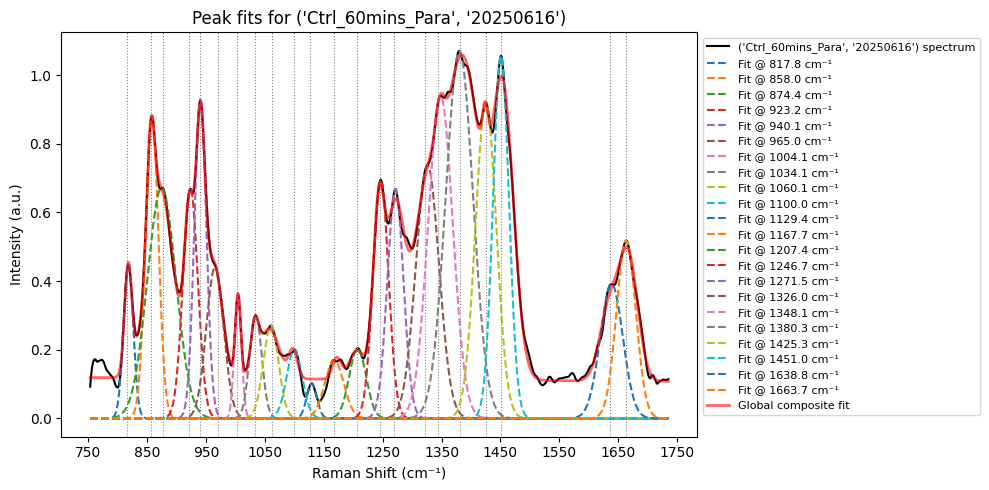

('Trt_20mins24h_Orth', '20250429') R² of global fit: 0.9961


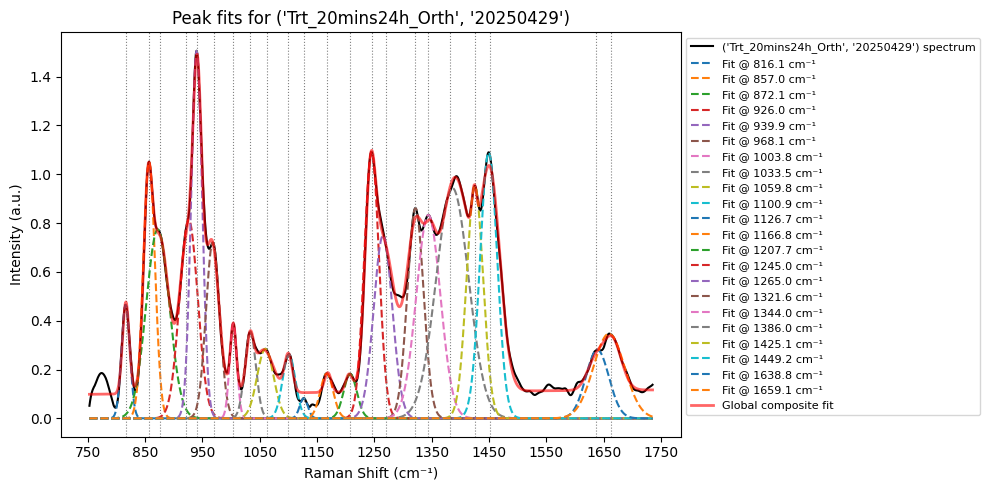

('Trt_20mins24h_Orth', '20250501') R² of global fit: 0.9960


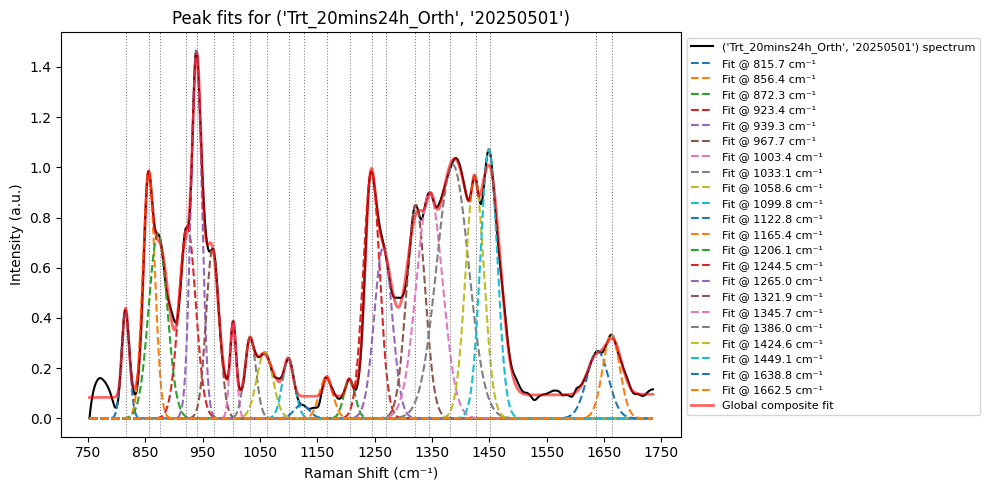

('Trt_20mins24h_Orth', '20250609') R² of global fit: 0.9946


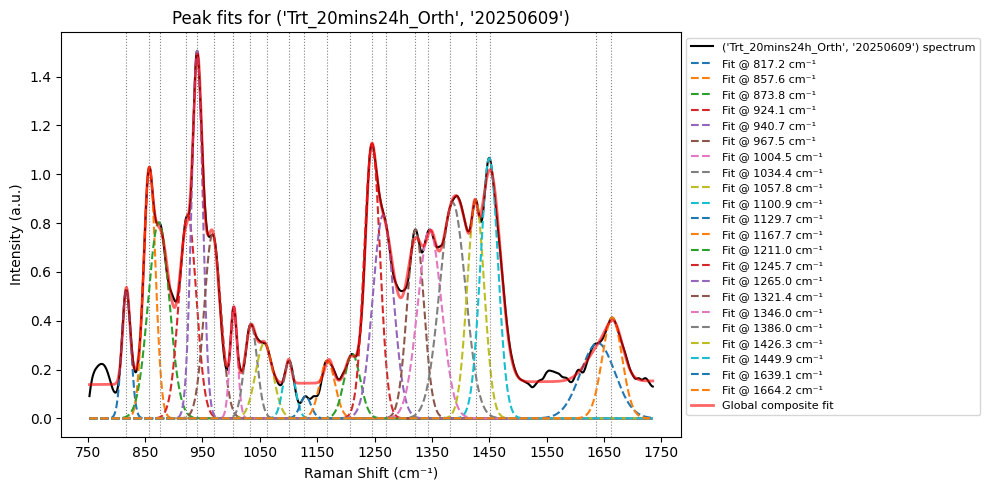

('Trt_20mins24h_Orth', '20250612') R² of global fit: 0.9940


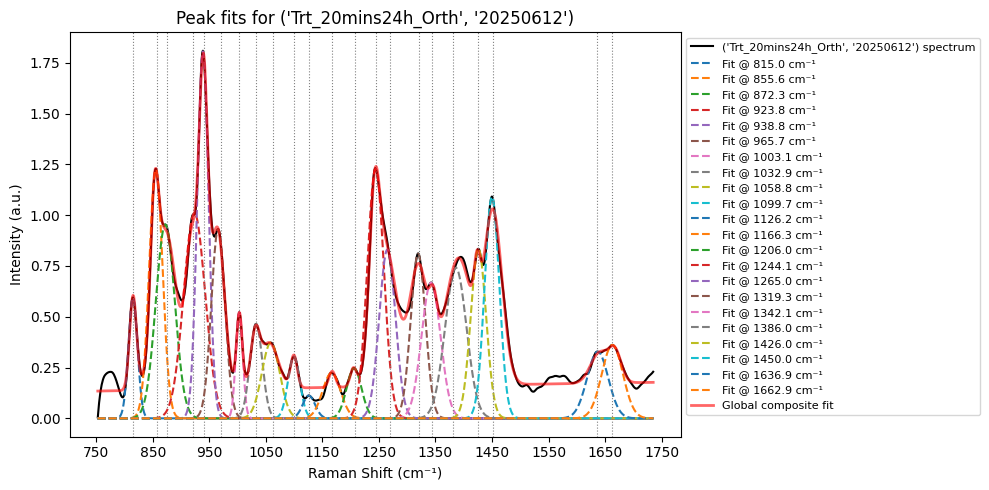

('Trt_20mins24h_Orth', '20250616') R² of global fit: 0.9956


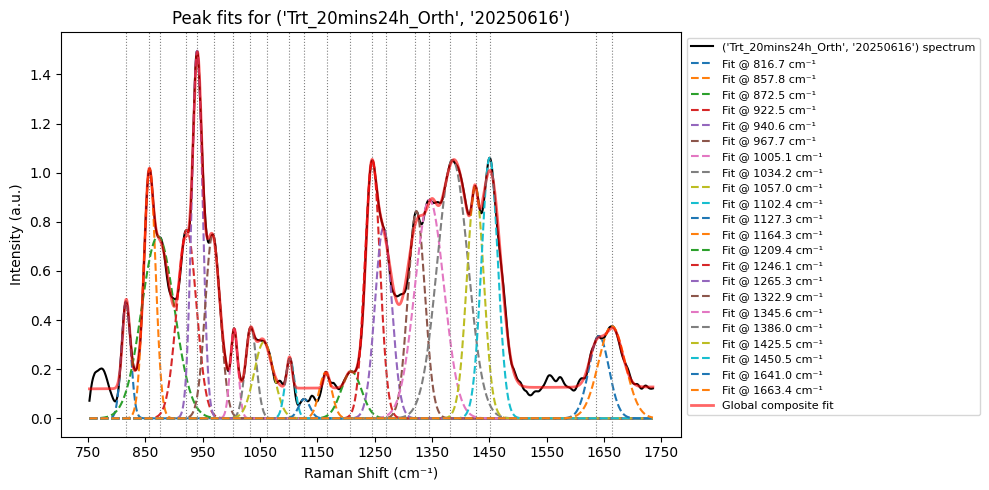

('Trt_20mins24h_Para', '20250429') R² of global fit: 0.9964


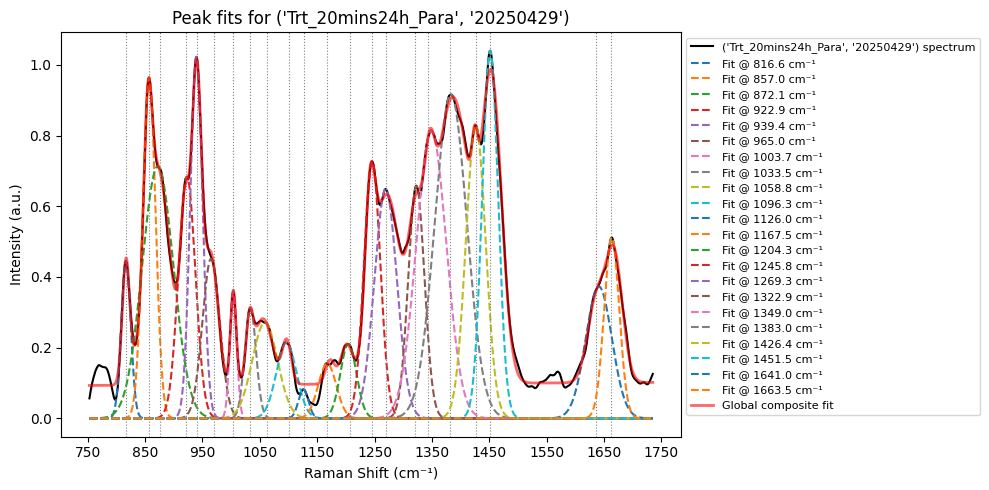

('Trt_20mins24h_Para', '20250501') R² of global fit: 0.9971


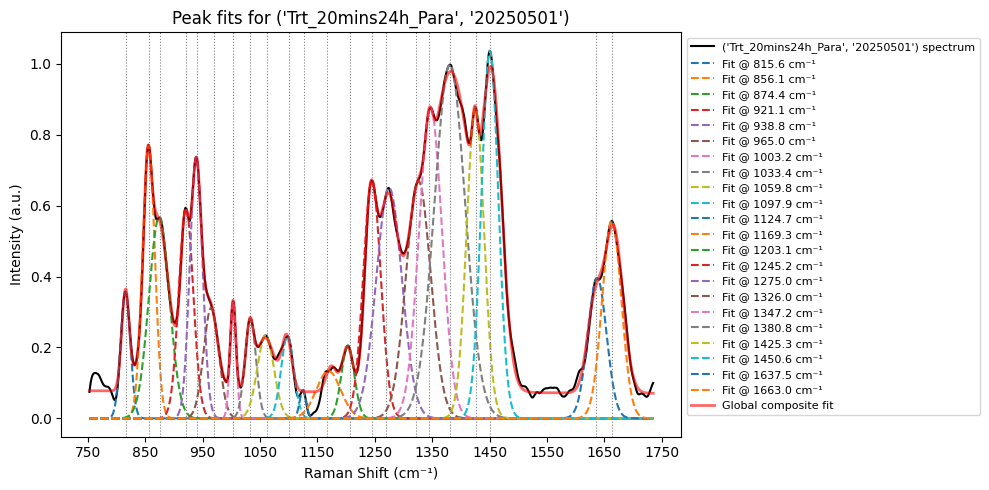

('Trt_20mins24h_Para', '20250609') R² of global fit: 0.9914


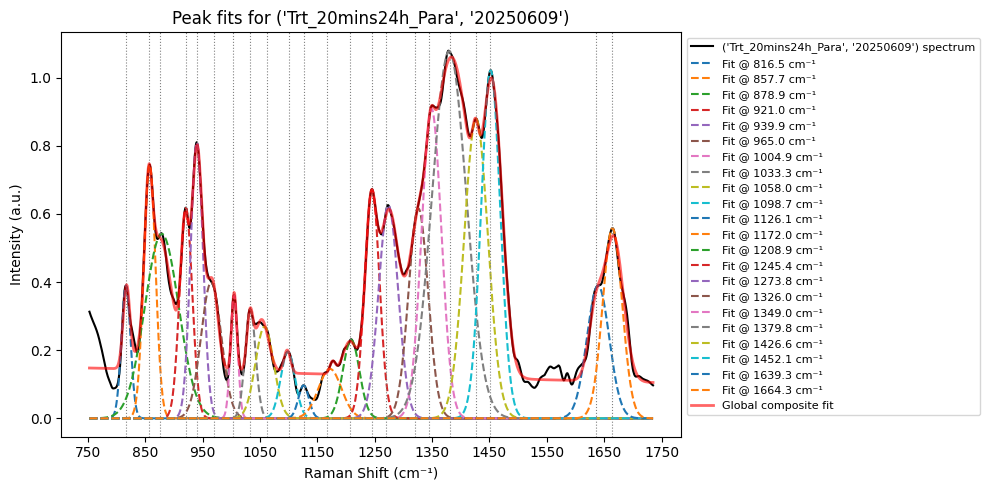

('Trt_20mins24h_Para', '20250612') R² of global fit: 0.9915


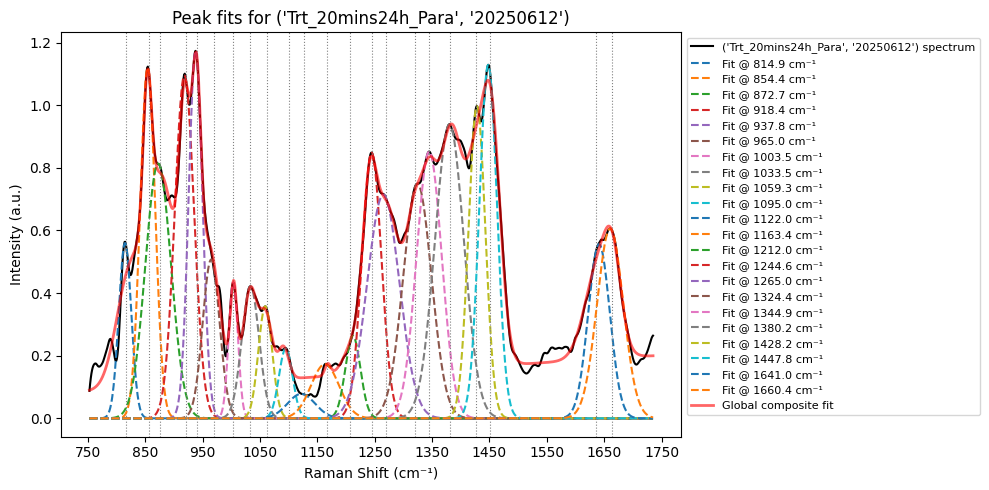

('Trt_20mins24h_Para', '20250616') R² of global fit: 0.9954


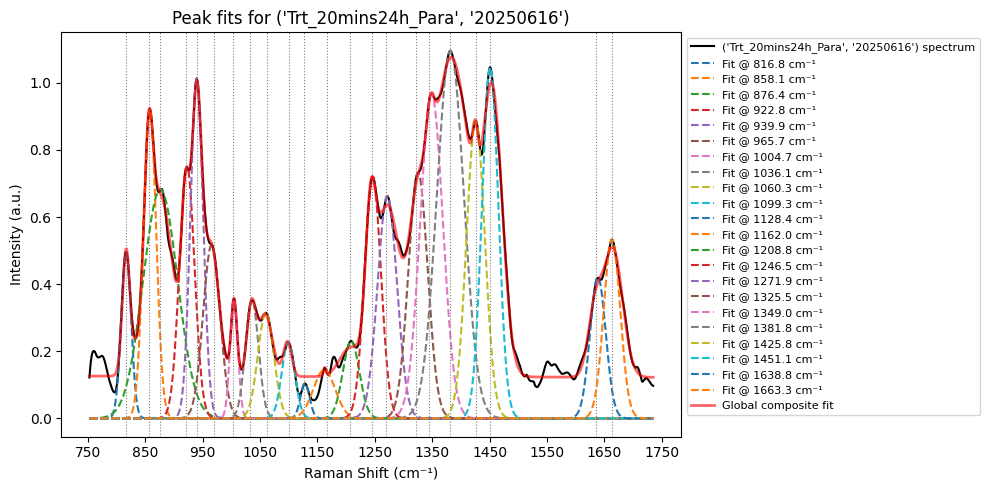

('Trt_20mins_Orth', '20250429') R² of global fit: 0.9956


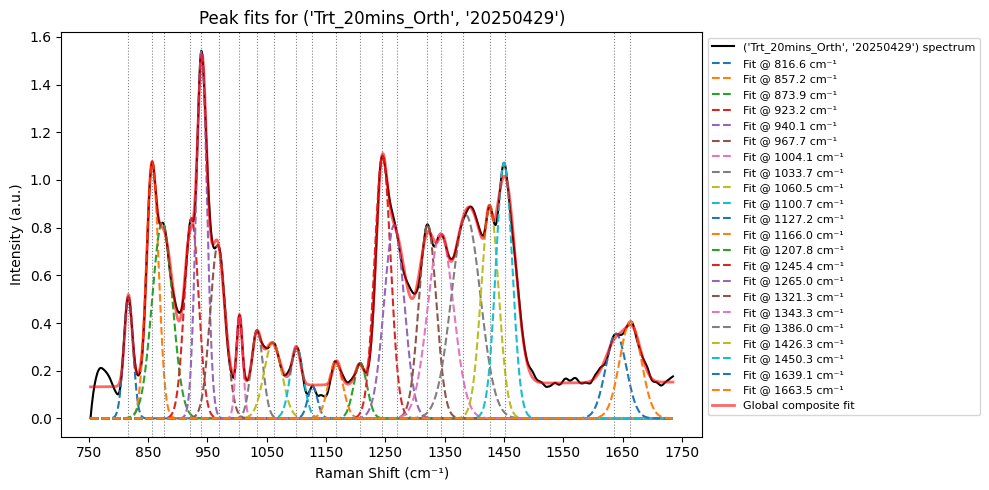

('Trt_20mins_Orth', '20250501') R² of global fit: 0.9963


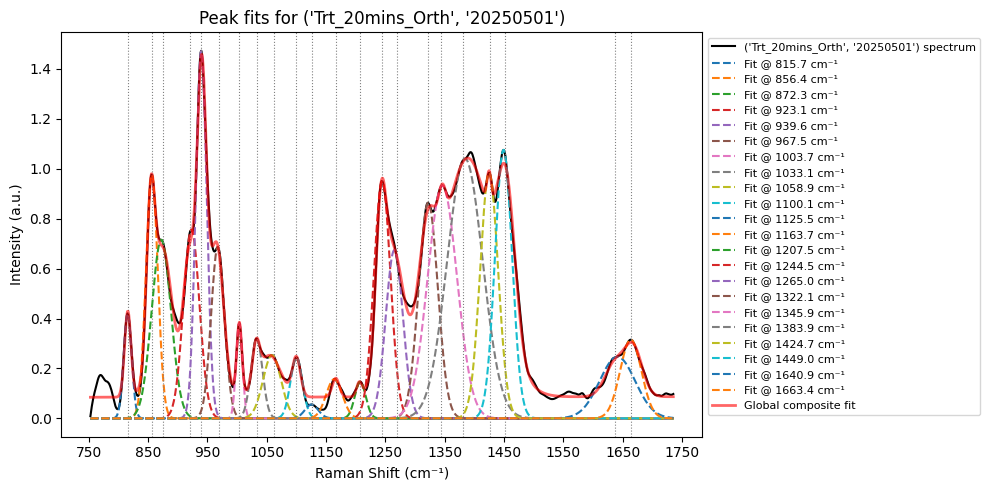

('Trt_20mins_Orth', '20250609') R² of global fit: 0.9947


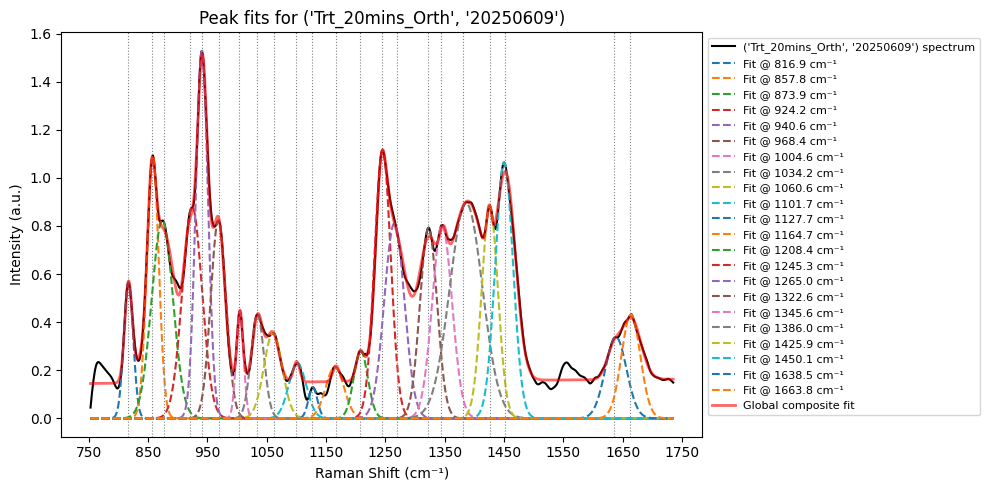

('Trt_20mins_Orth', '20250612') R² of global fit: 0.9948


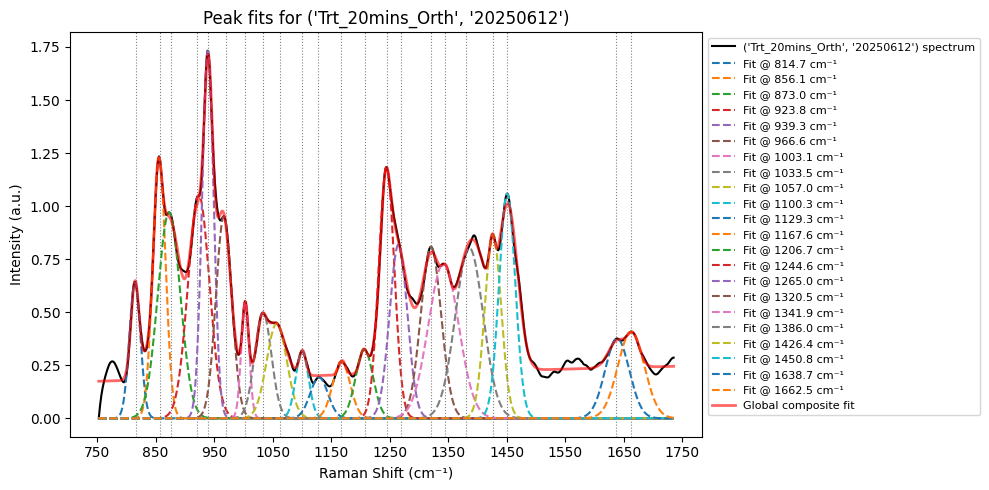

('Trt_20mins_Orth', '20250616') R² of global fit: 0.9947


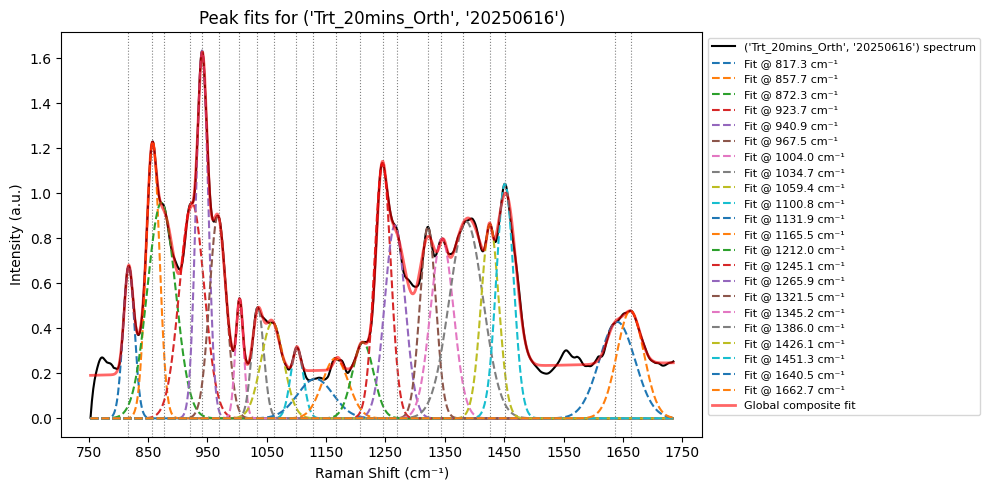

('Trt_20mins_Para', '20250429') R² of global fit: 0.9974


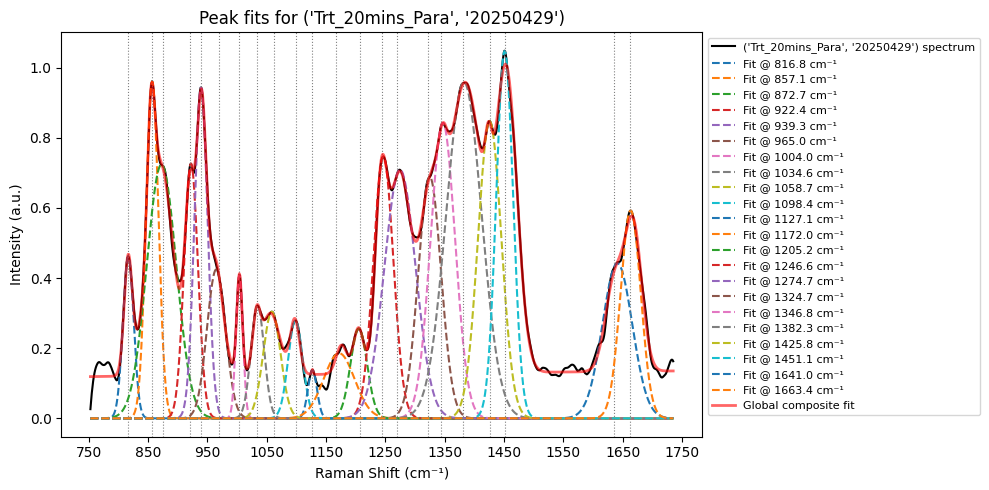

('Trt_20mins_Para', '20250501') R² of global fit: 0.9974


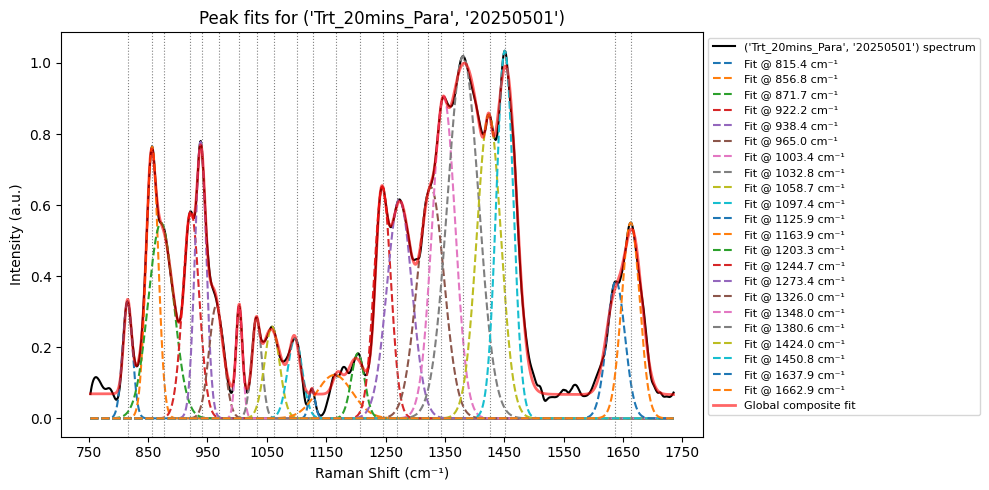

('Trt_20mins_Para', '20250609') R² of global fit: 0.9908


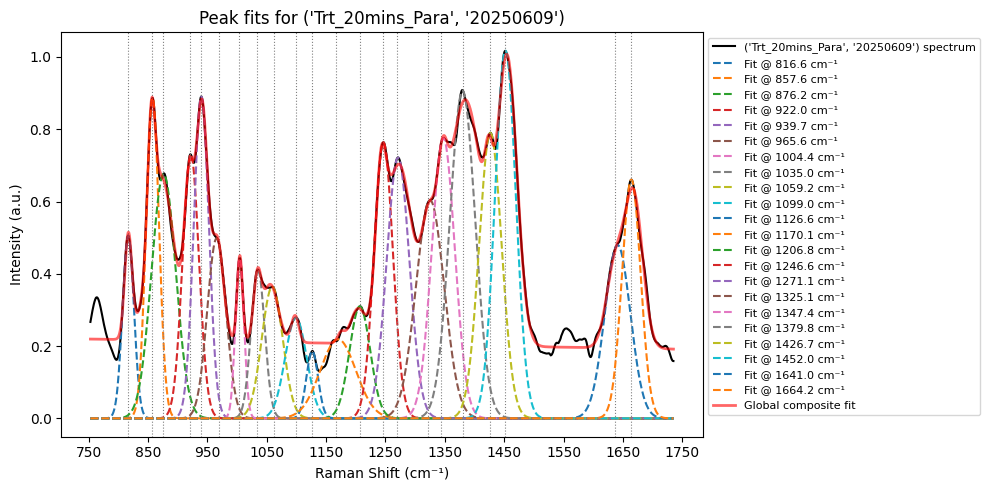

('Trt_20mins_Para', '20250612') R² of global fit: 0.9939


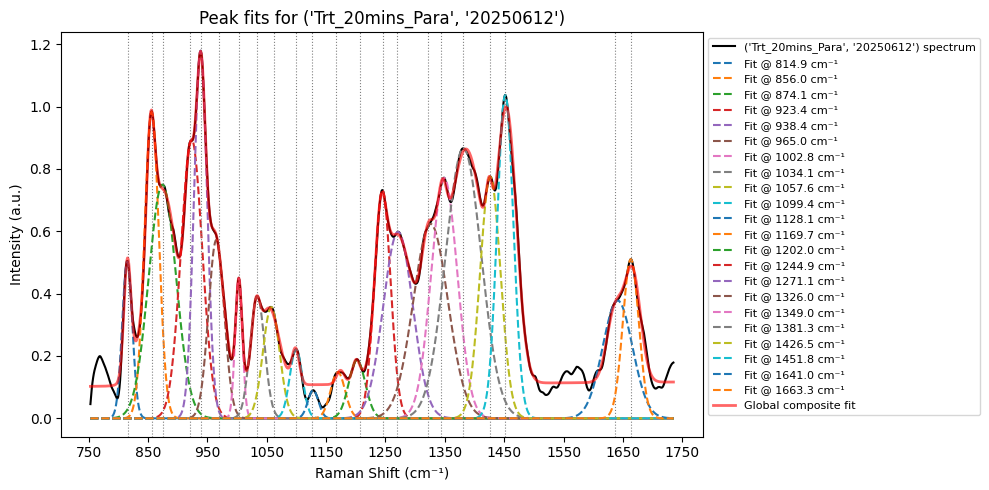

('Trt_20mins_Para', '20250616') R² of global fit: 0.9928


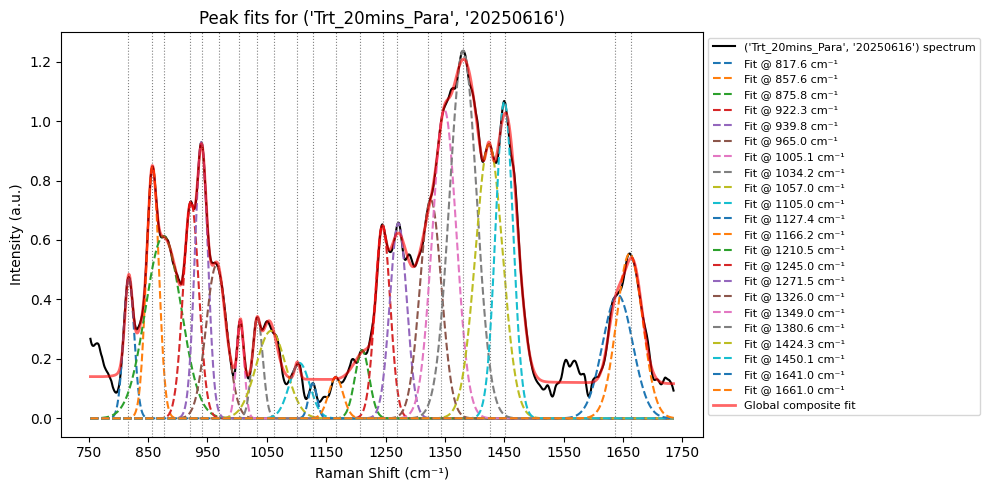

('Trt_24h_Orth', '20250429') R² of global fit: 0.9952


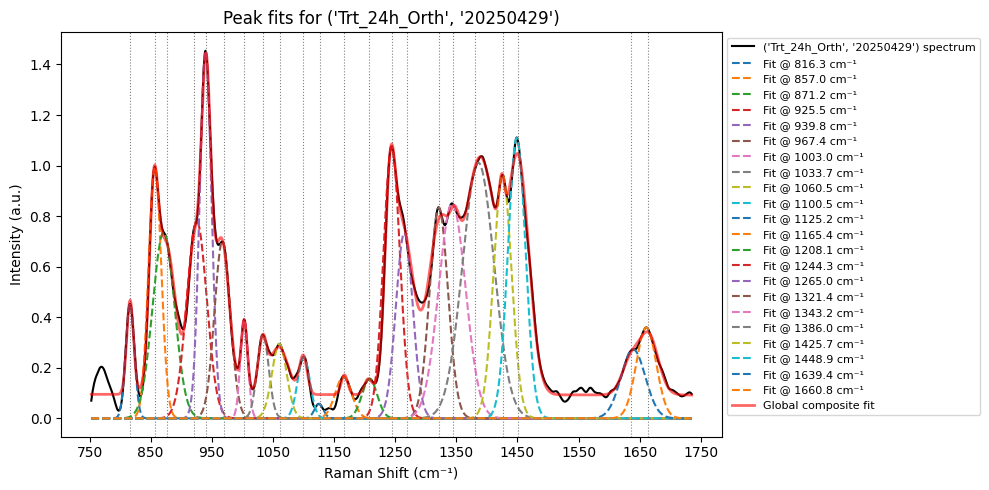

('Trt_24h_Orth', '20250501') R² of global fit: 0.9953


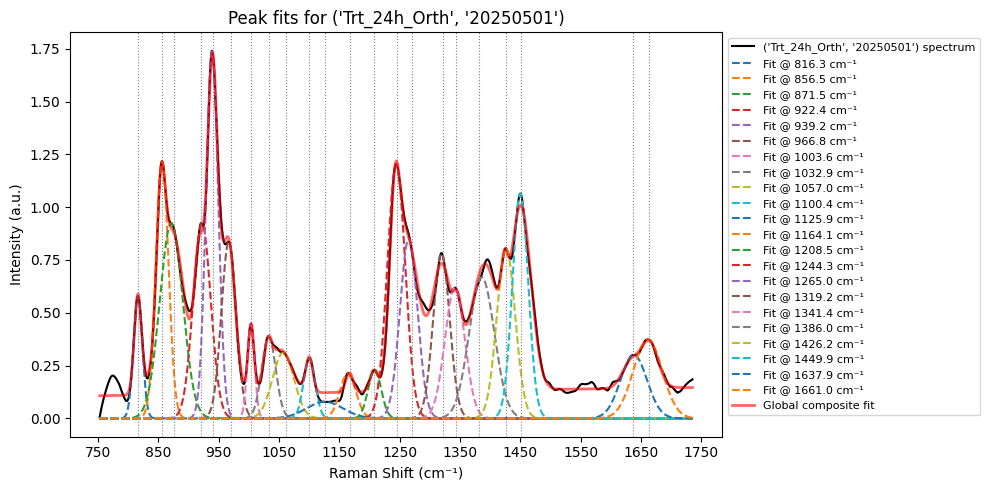

('Trt_24h_Orth', '20250609') R² of global fit: 0.9939


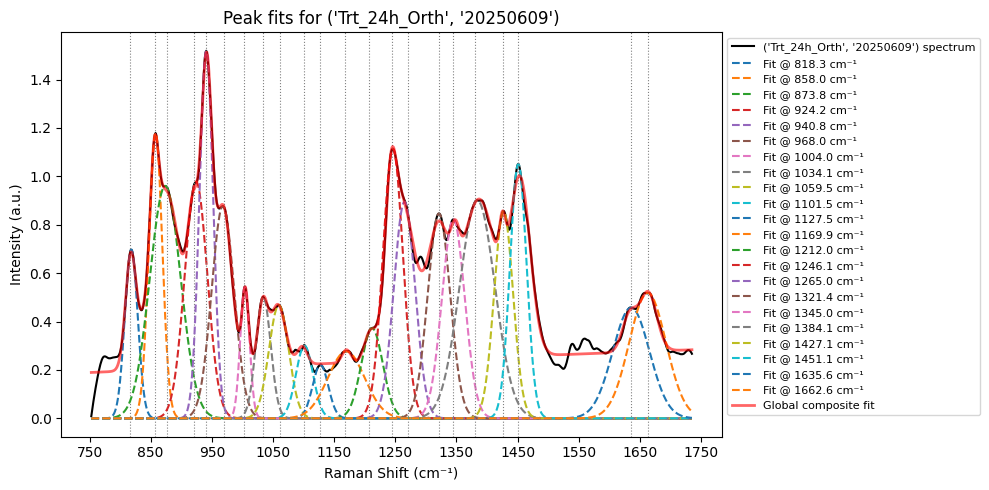

('Trt_24h_Orth', '20250612') R² of global fit: 0.9948


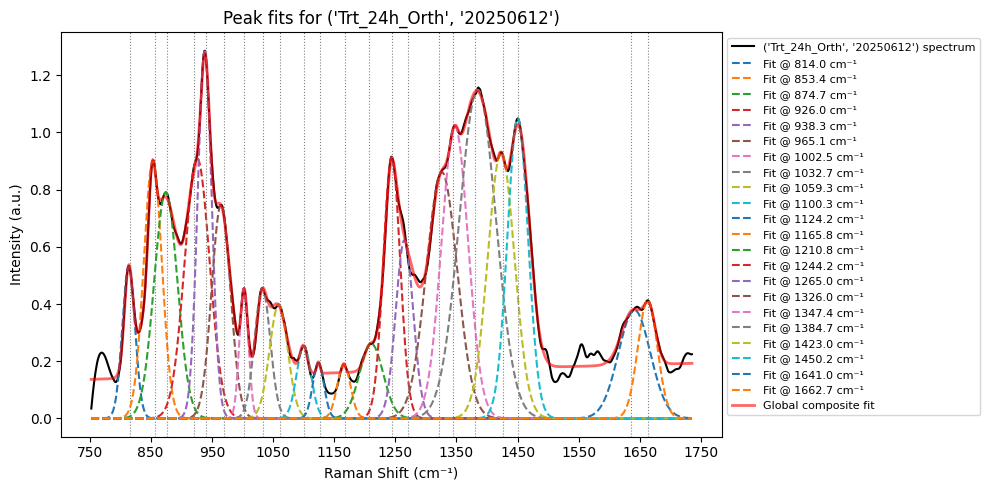

('Trt_24h_Orth', '20250616') R² of global fit: 0.9941


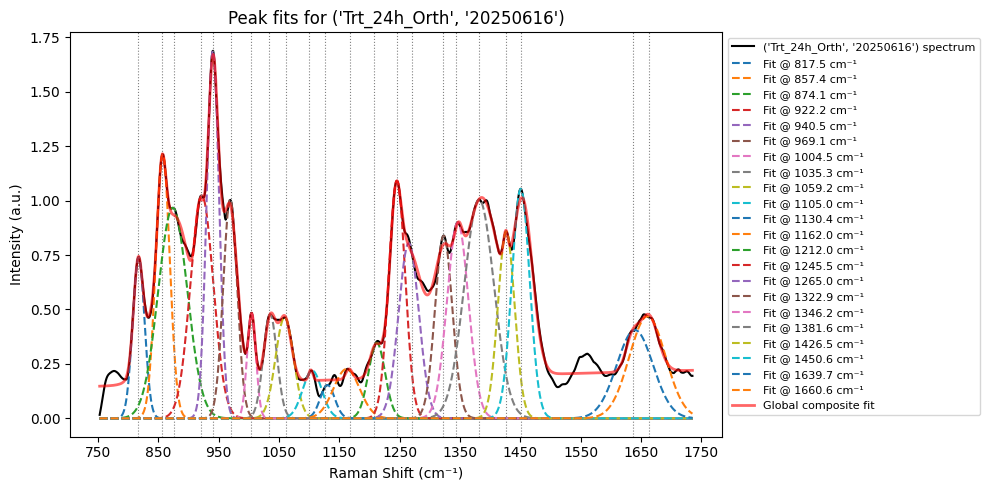

('Trt_24h_Para', '20250429') R² of global fit: 0.9937


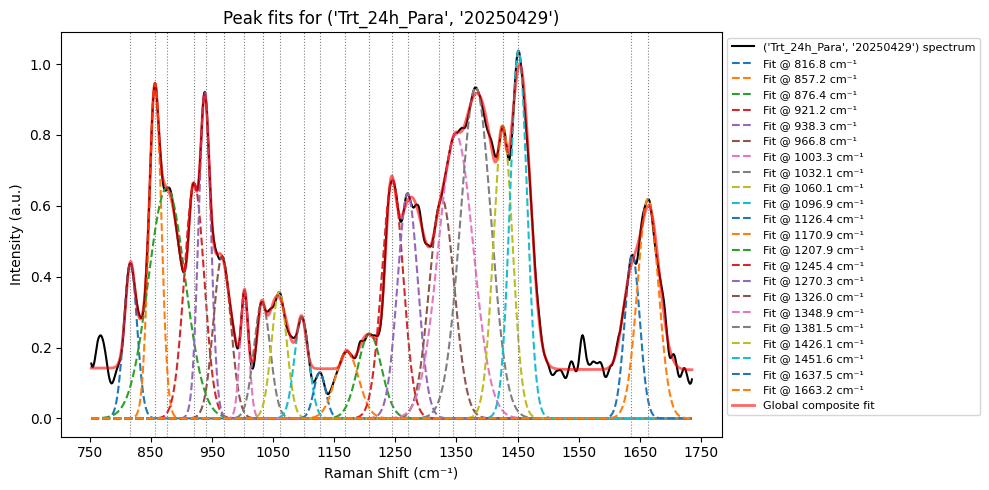

('Trt_24h_Para', '20250501') R² of global fit: 0.9957


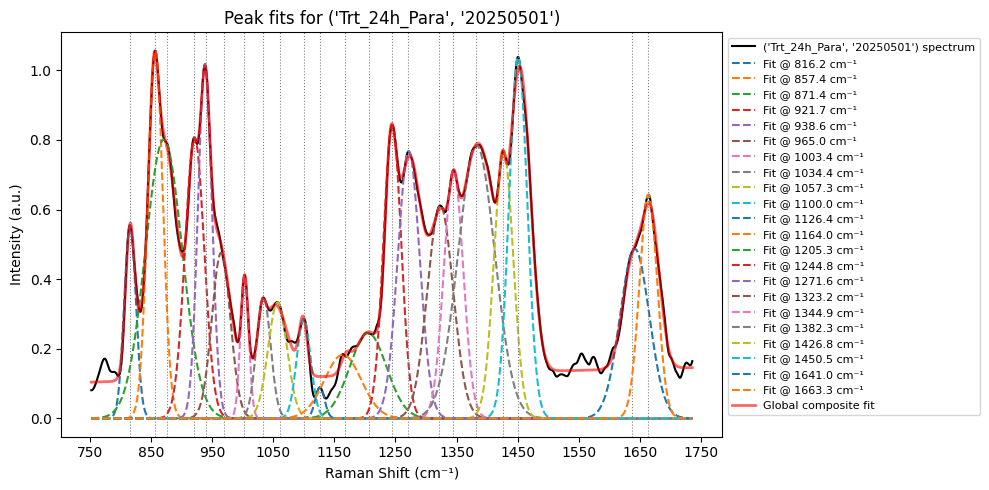

('Trt_24h_Para', '20250609') R² of global fit: 0.9911


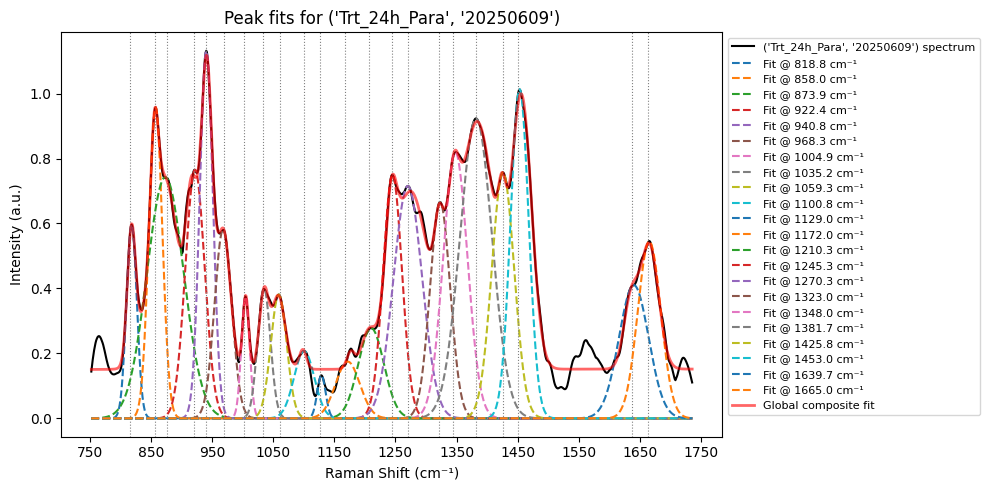

('Trt_24h_Para', '20250612') R² of global fit: 0.9884


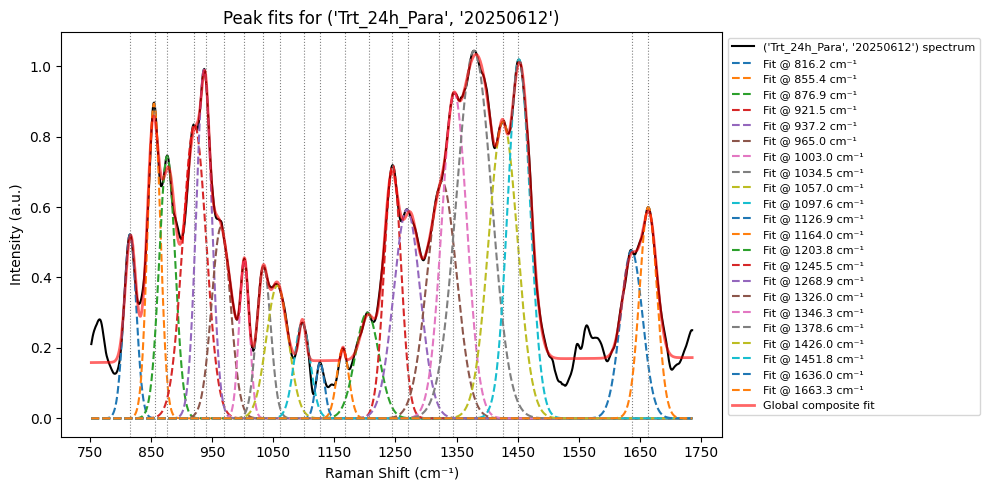

('Trt_24h_Para', '20250616') R² of global fit: 0.9893


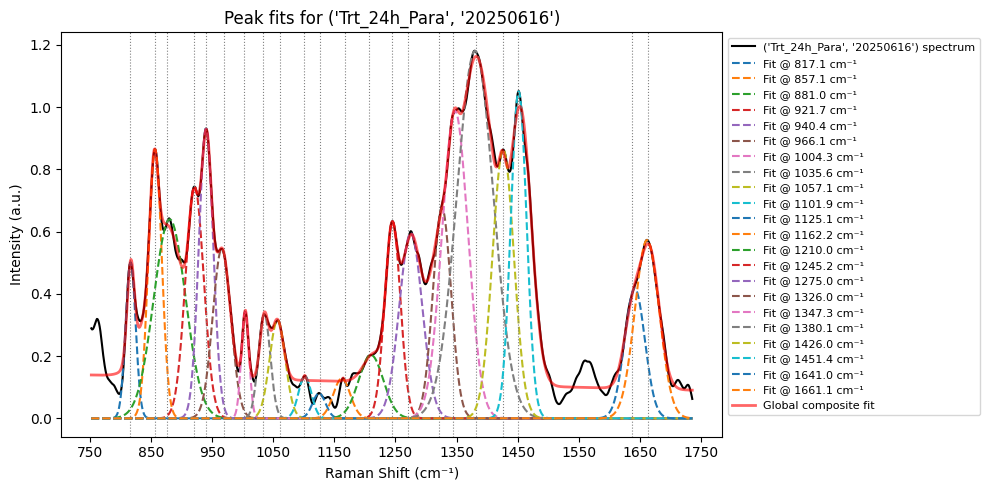

('Trt_2mins24h_Orth', '20250429') R² of global fit: 0.9933


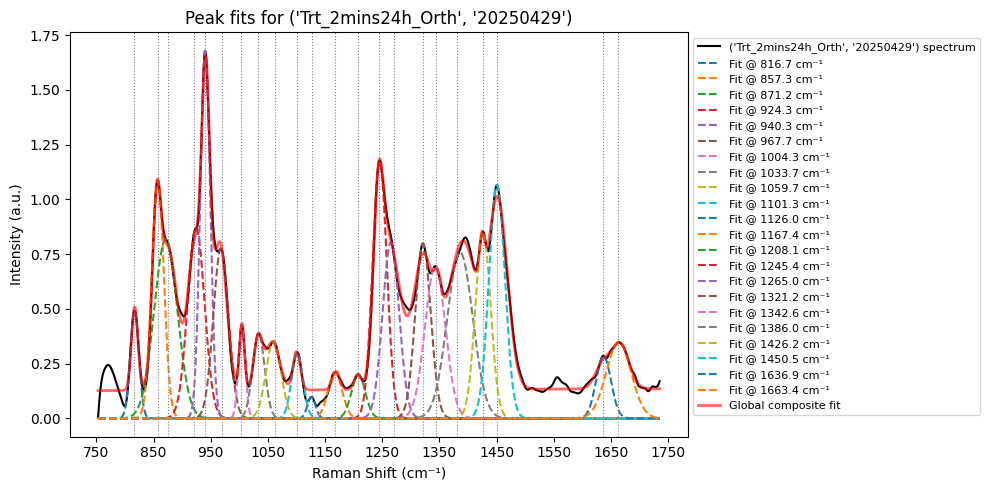

('Trt_2mins24h_Orth', '20250501') R² of global fit: 0.9972


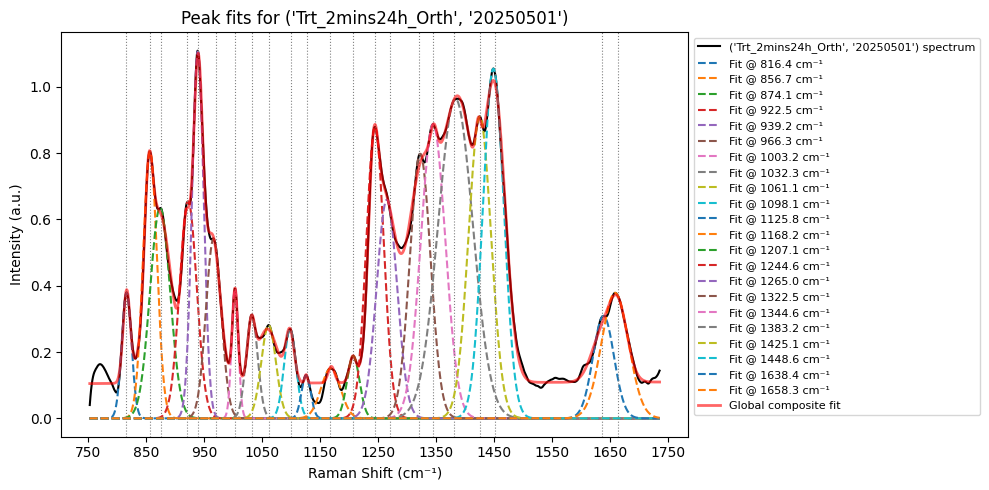

('Trt_2mins24h_Orth', '20250609') R² of global fit: 0.9960


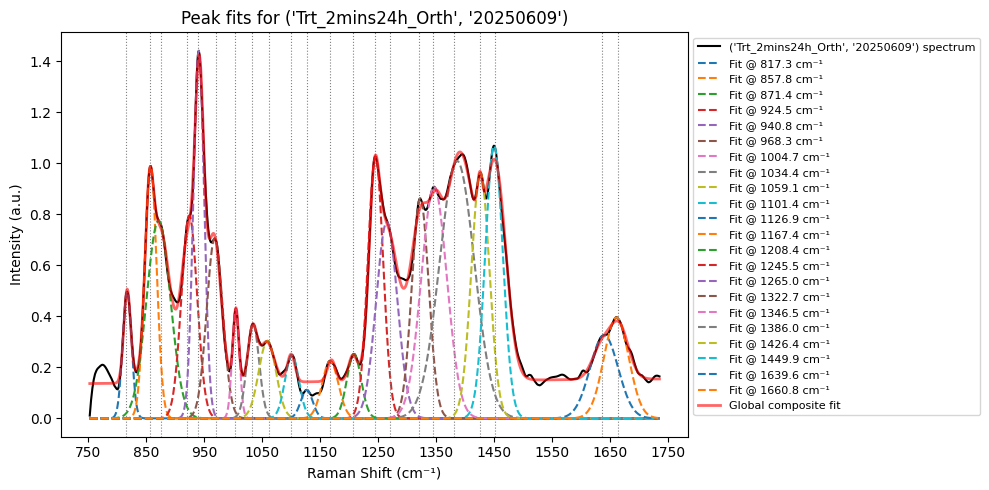

('Trt_2mins24h_Orth', '20250612') R² of global fit: 0.9950


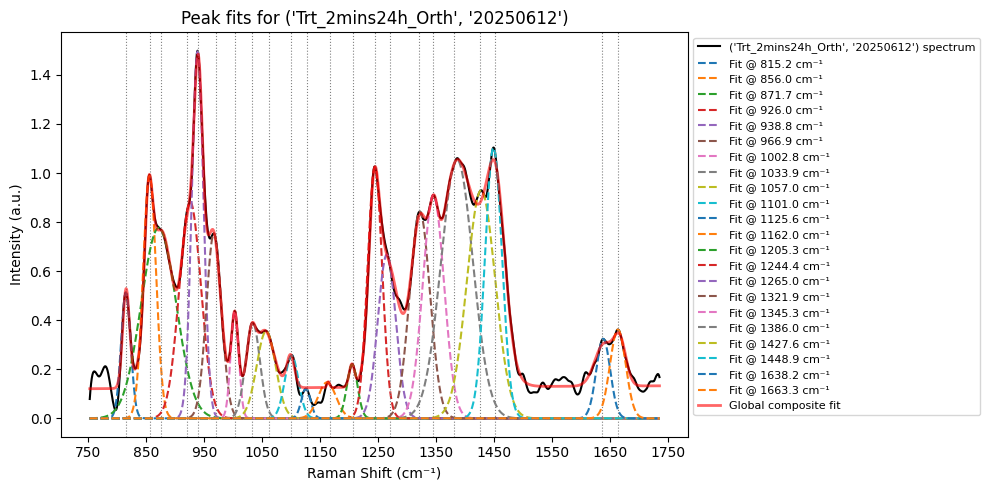

('Trt_2mins24h_Orth', '20250616') R² of global fit: 0.9954


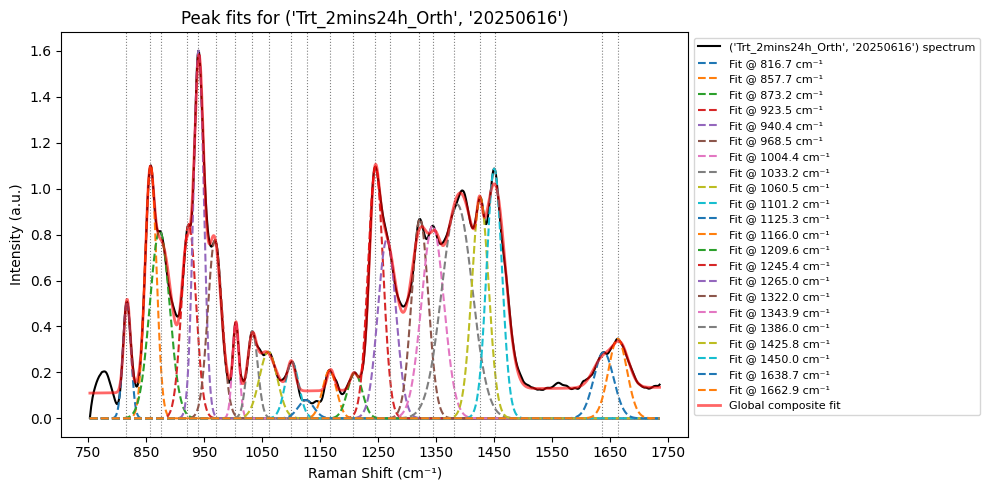

('Trt_2mins24h_Para', '20250429') R² of global fit: 0.9963


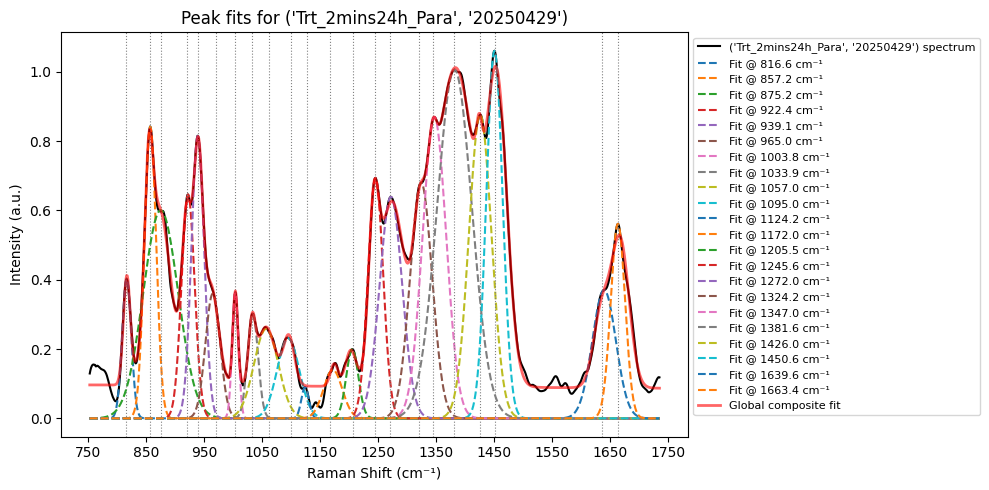

('Trt_2mins24h_Para', '20250501') R² of global fit: 0.9971


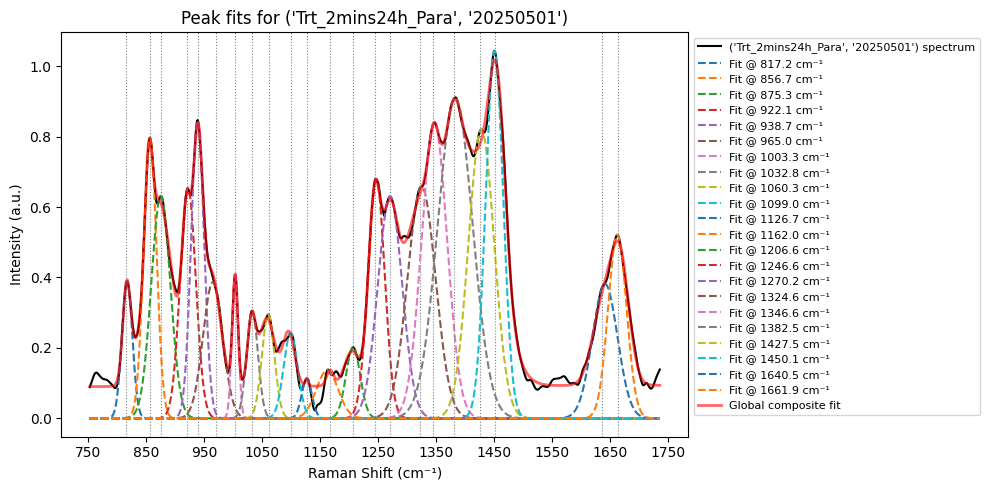

('Trt_2mins24h_Para', '20250609') R² of global fit: 0.9970


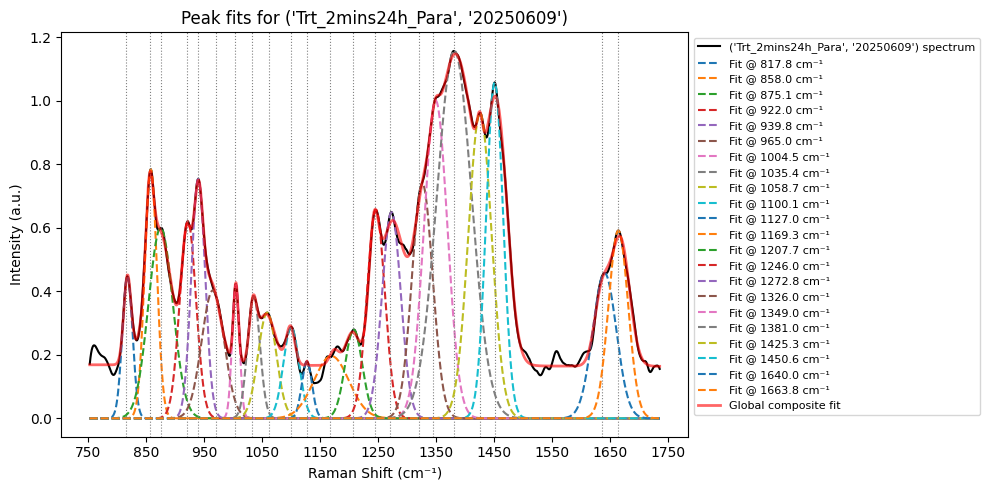

('Trt_2mins24h_Para', '20250612') R² of global fit: 0.9956


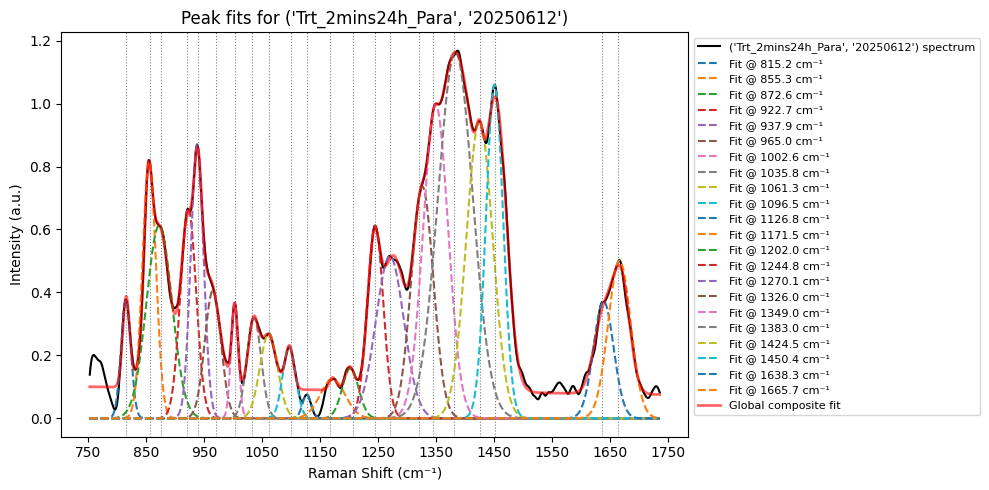

('Trt_2mins24h_Para', '20250616') R² of global fit: 0.9956


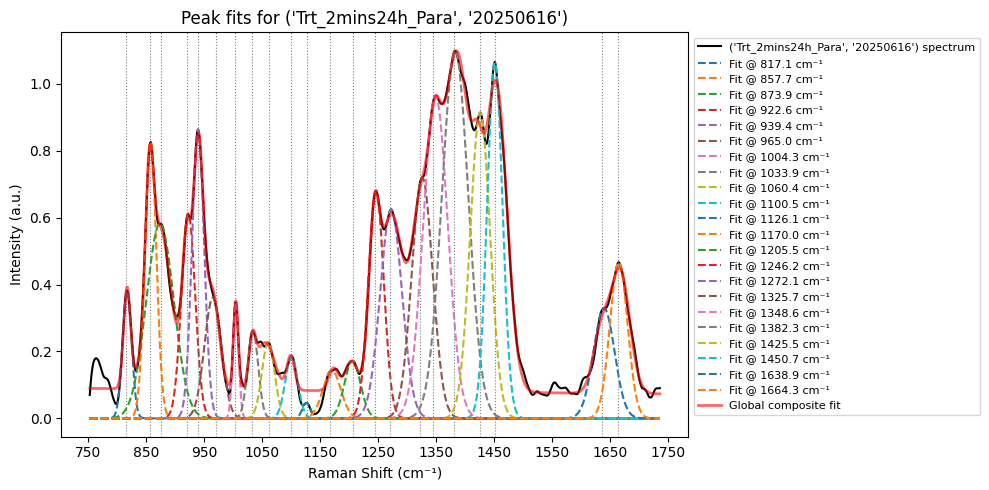

('Trt_2mins_Orth', '20250429') R² of global fit: 0.9938


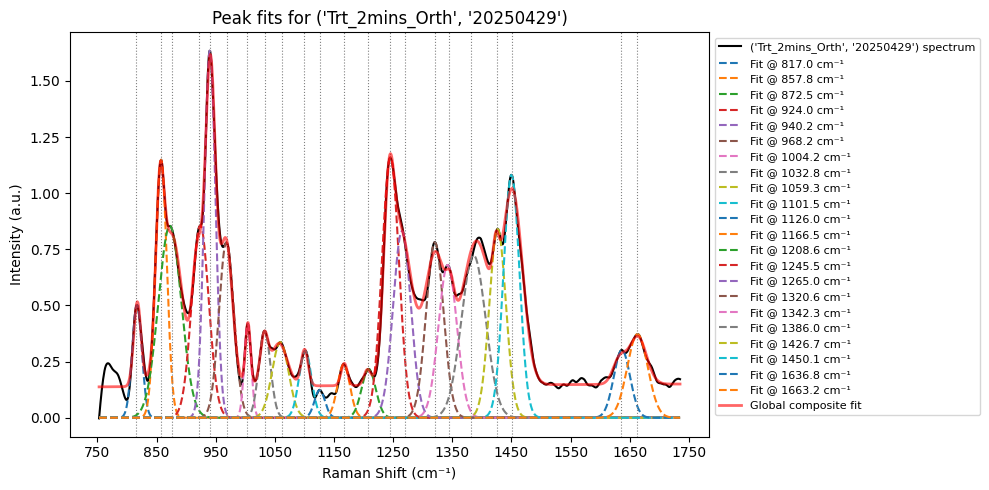

('Trt_2mins_Orth', '20250501') R² of global fit: 0.9969


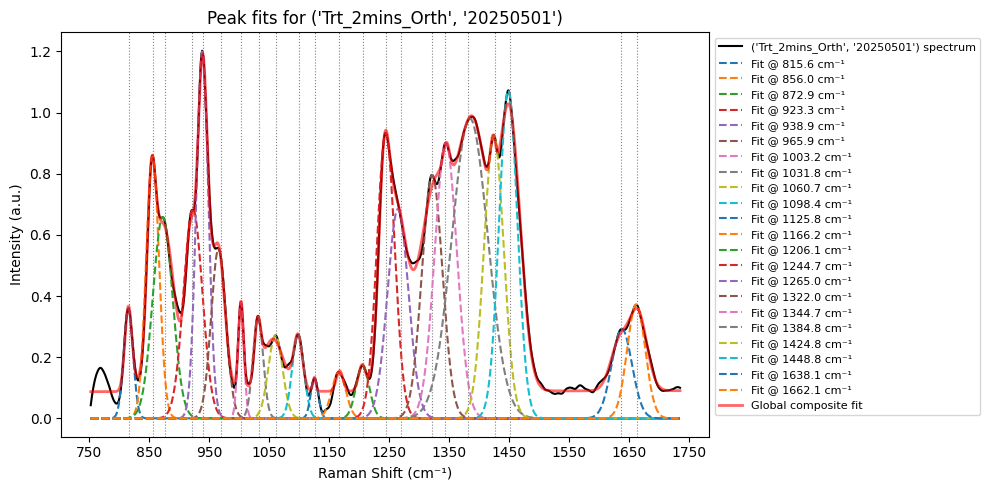

('Trt_2mins_Orth', '20250609') R² of global fit: 0.9968


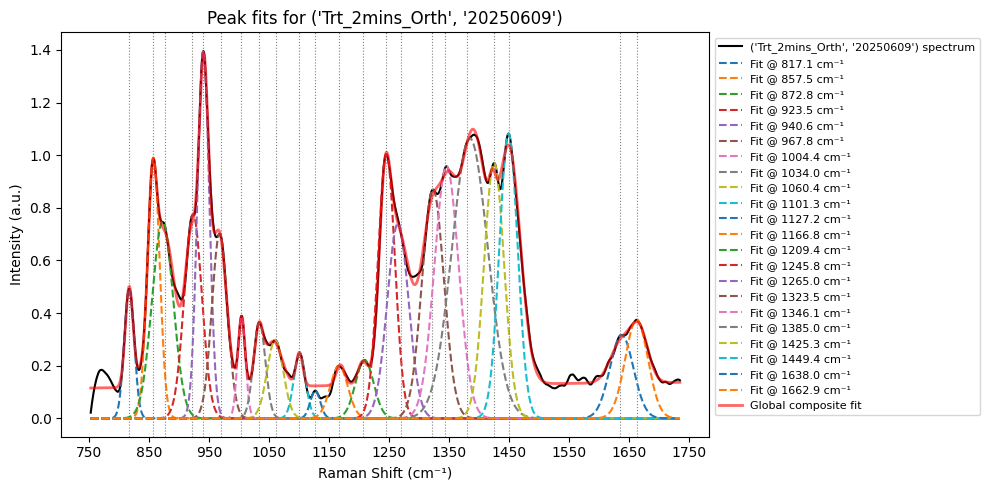

('Trt_2mins_Orth', '20250612') R² of global fit: 0.9951


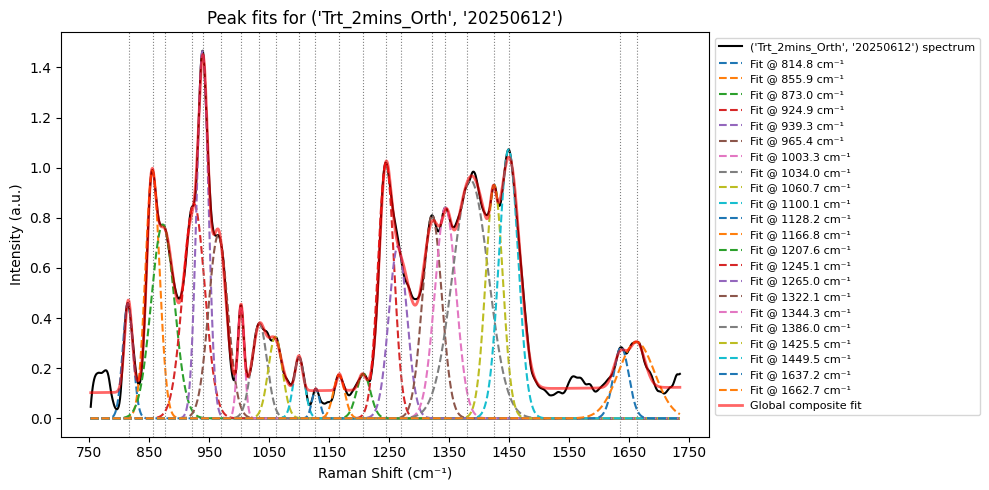

('Trt_2mins_Orth', '20250616') R² of global fit: 0.9959


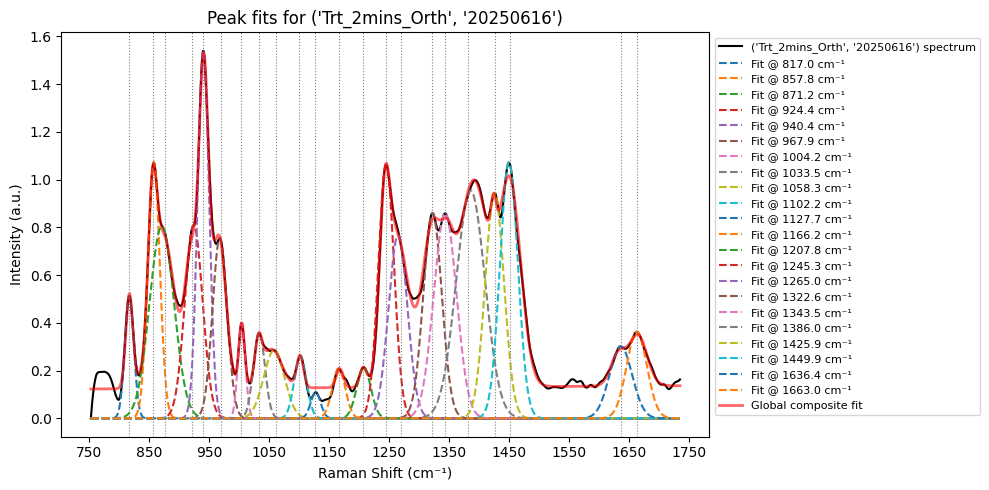

('Trt_2mins_Para', '20250429') R² of global fit: 0.9953


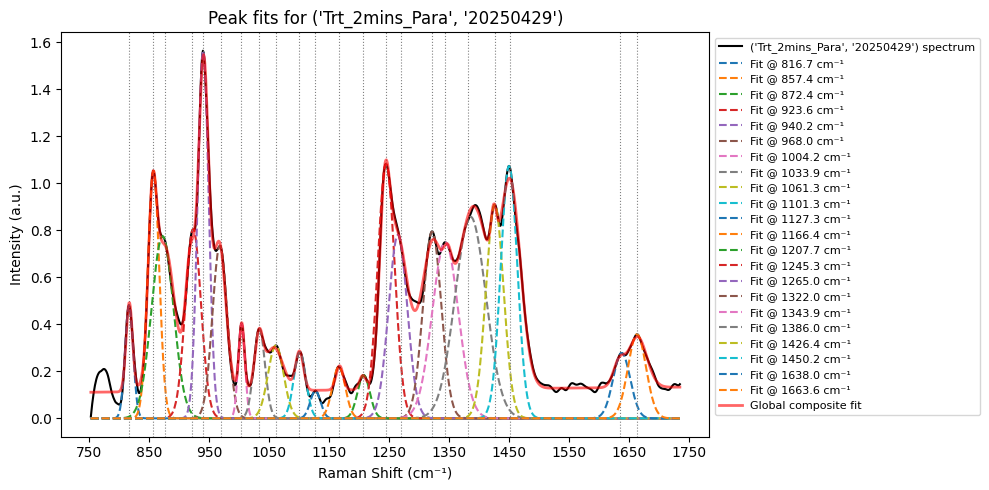

('Trt_2mins_Para', '20250501') R² of global fit: 0.9970


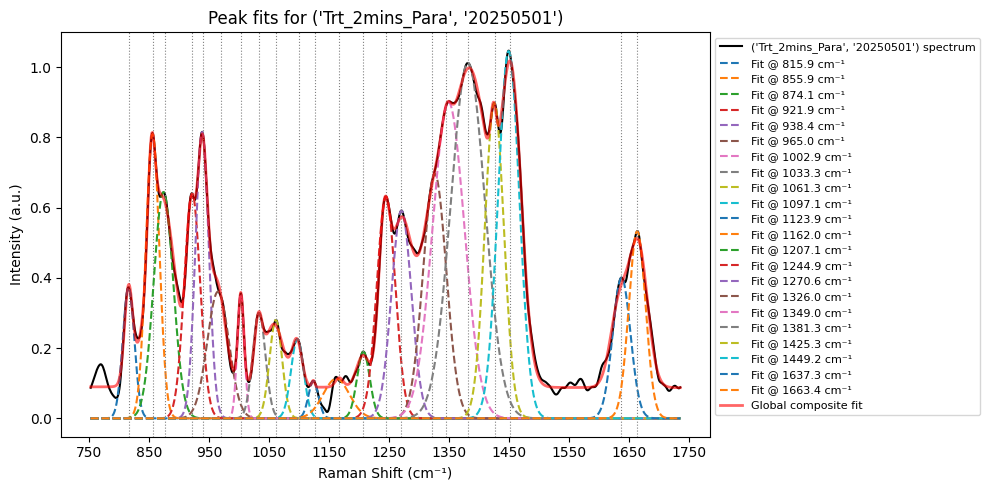

('Trt_2mins_Para', '20250609') R² of global fit: 0.9957


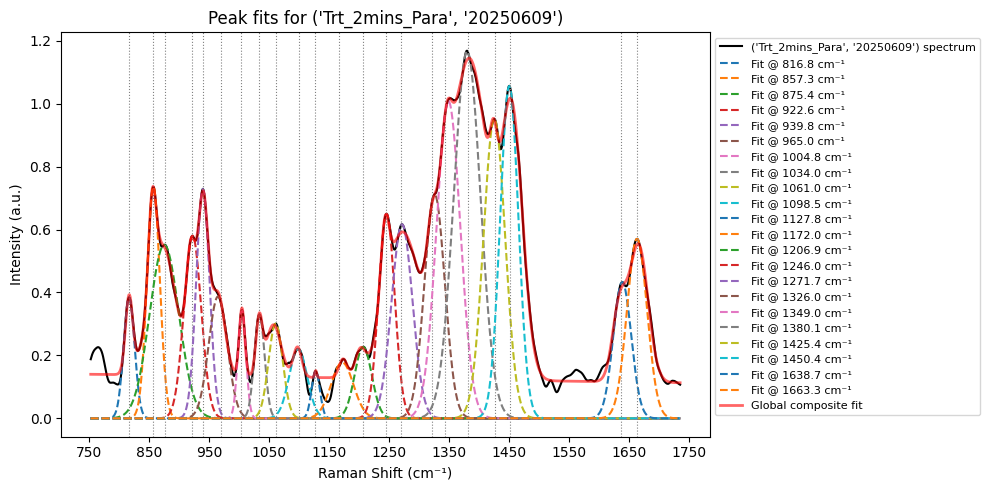

('Trt_2mins_Para', '20250612') R² of global fit: 0.9967


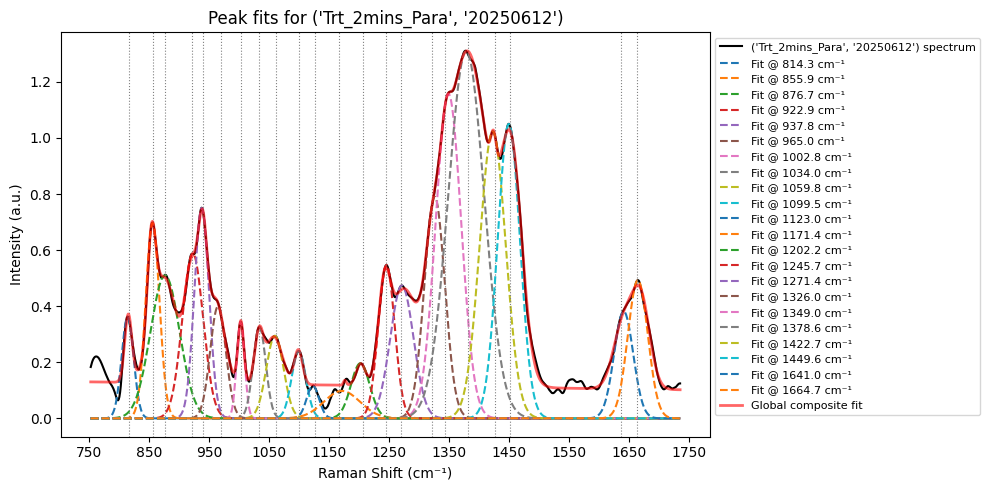

('Trt_2mins_Para', '20250616') R² of global fit: 0.9969


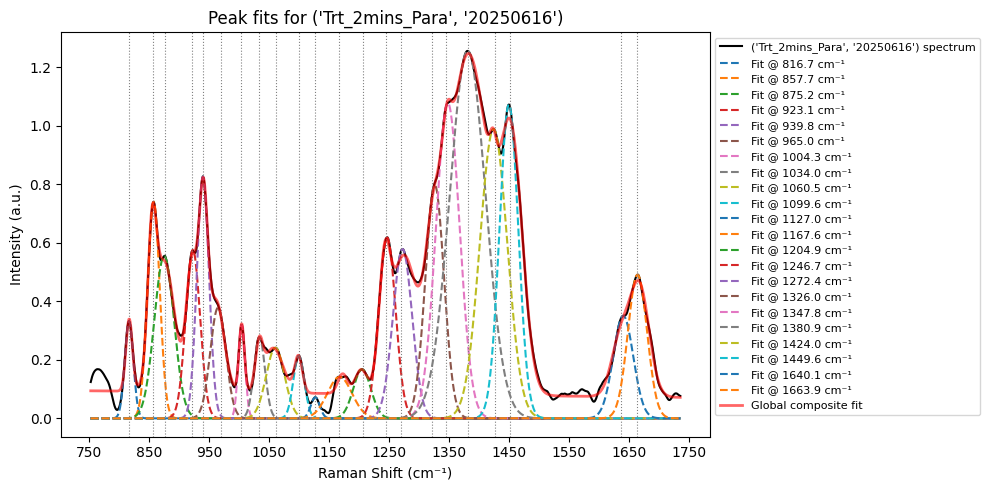

('Trt_40mins24h_Orth', '20250429') R² of global fit: 0.9947


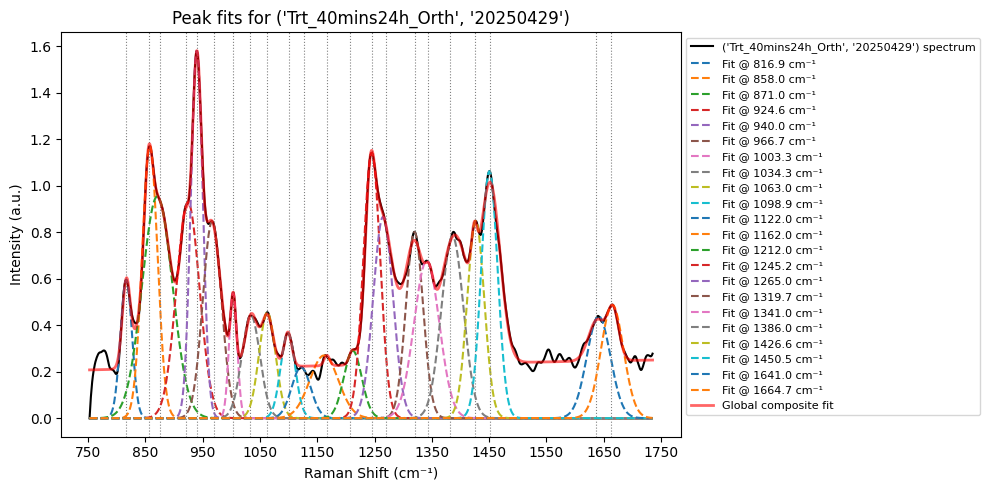

('Trt_40mins24h_Orth', '20250501') R² of global fit: 0.9960


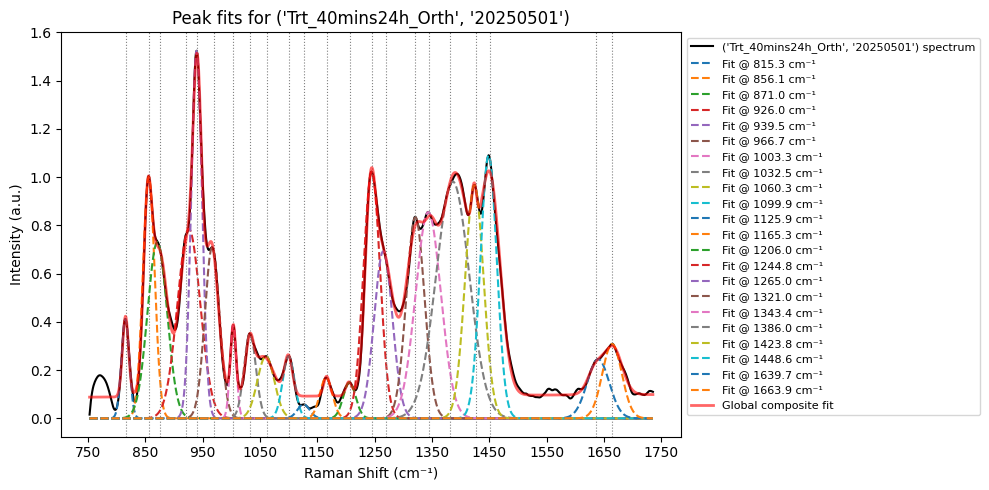

('Trt_40mins24h_Orth', '20250609') R² of global fit: 0.9967


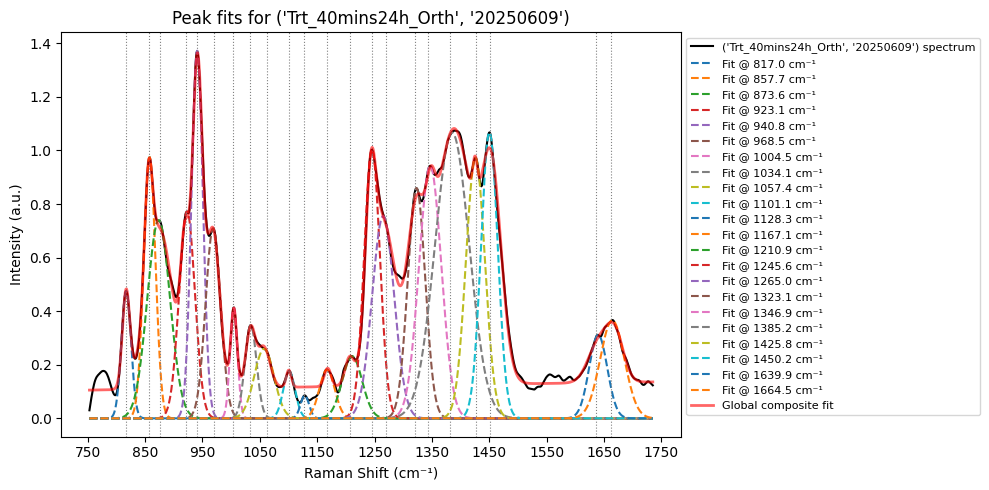

('Trt_40mins24h_Orth', '20250612') R² of global fit: 0.9946


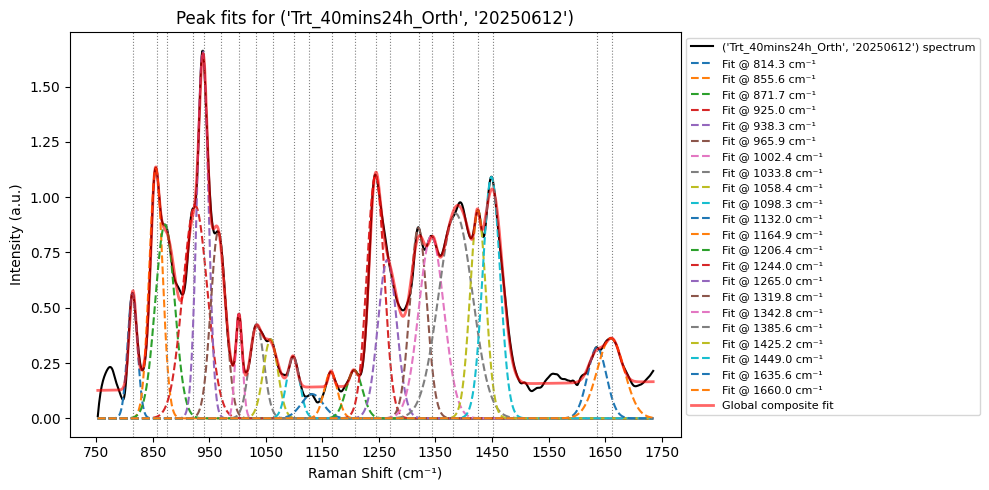

('Trt_40mins24h_Orth', '20250616') R² of global fit: 0.9937


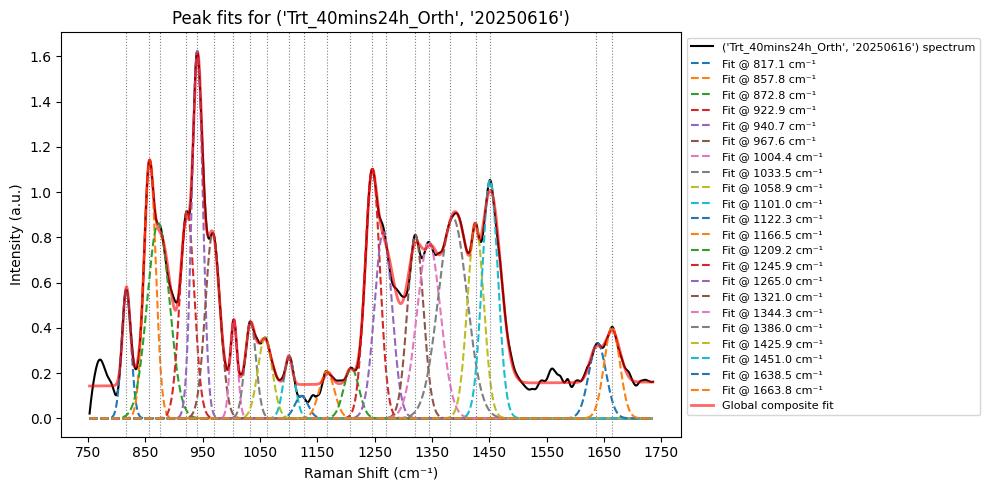

('Trt_40mins24h_Para', '20250429') R² of global fit: 0.9922


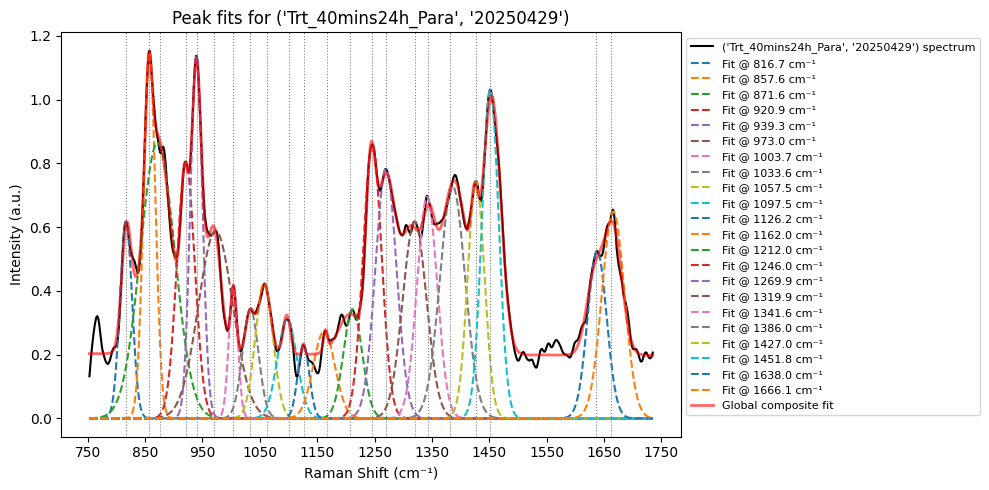

('Trt_40mins24h_Para', '20250501') R² of global fit: 0.9963


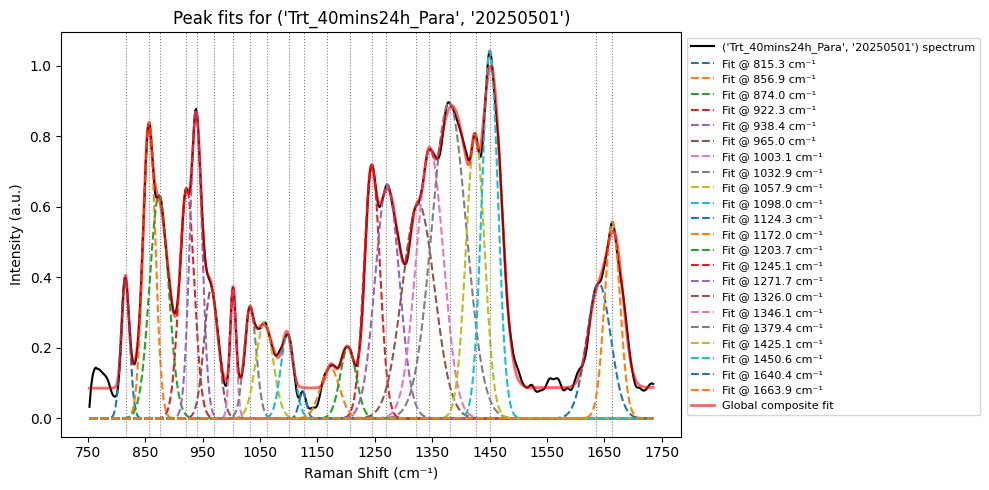

('Trt_40mins24h_Para', '20250609') R² of global fit: 0.9944


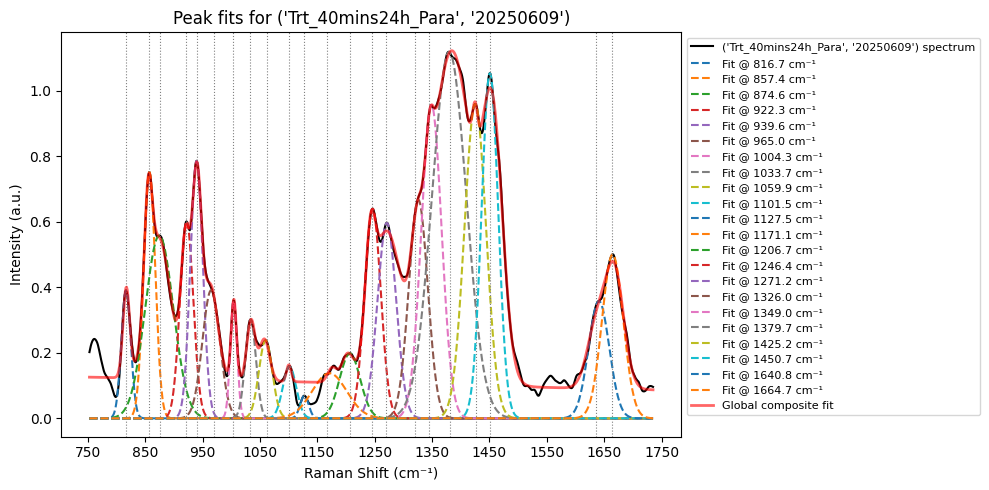

('Trt_40mins24h_Para', '20250612') R² of global fit: 0.9935


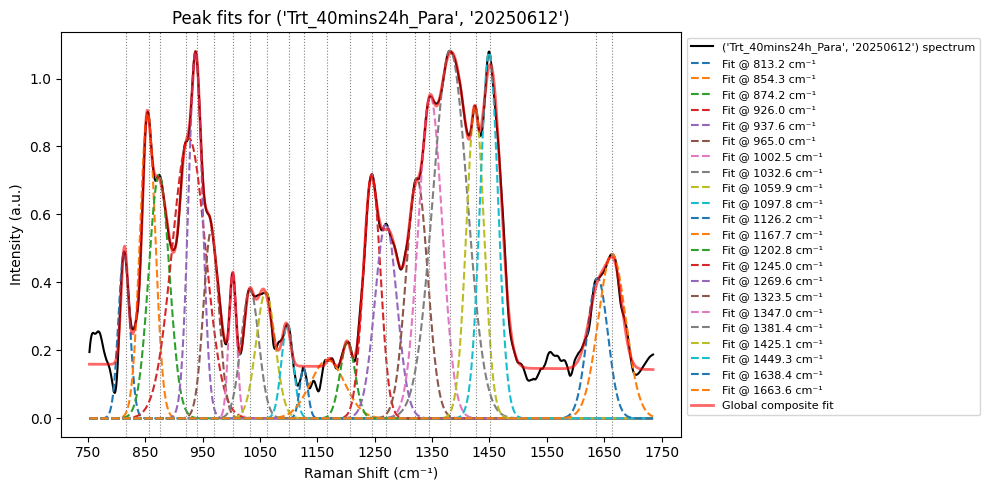

('Trt_40mins24h_Para', '20250616') R² of global fit: 0.9968


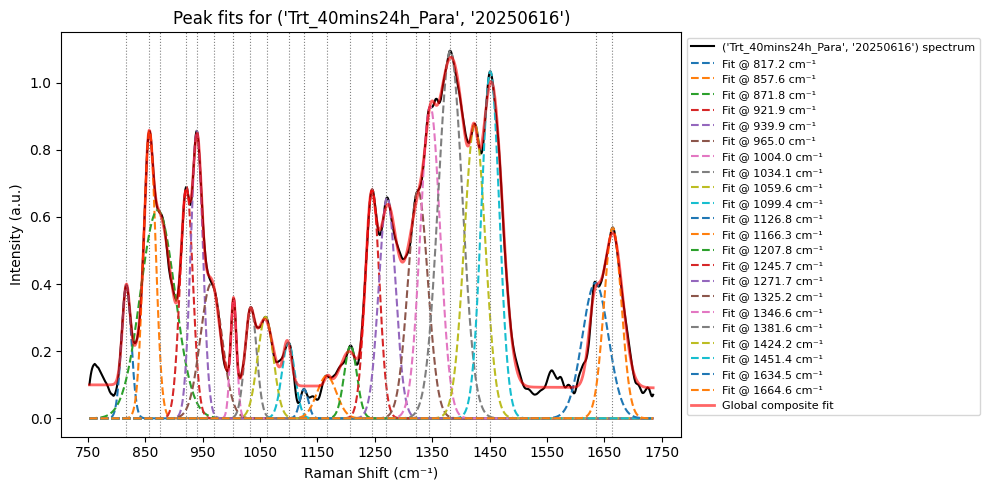

('Trt_40mins_Orth', '20250429') R² of global fit: 0.9949


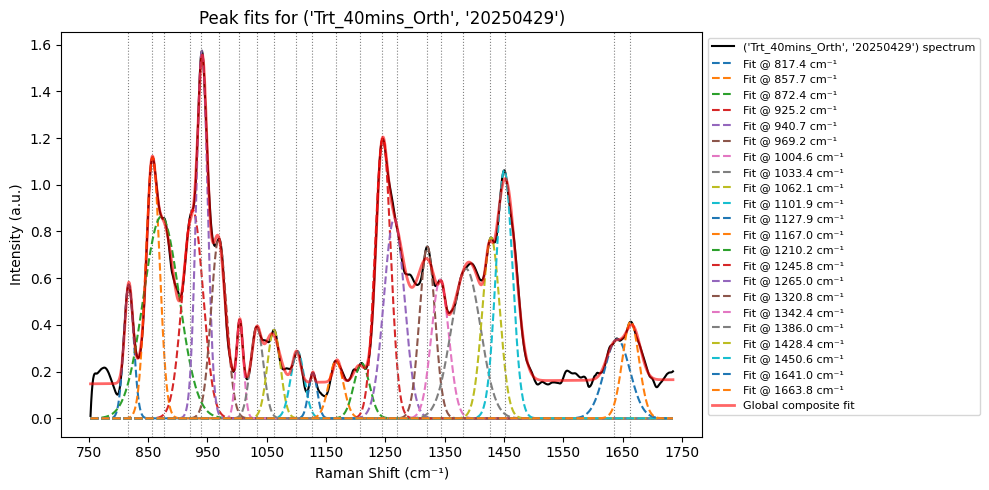

('Trt_40mins_Orth', '20250501') R² of global fit: 0.9965


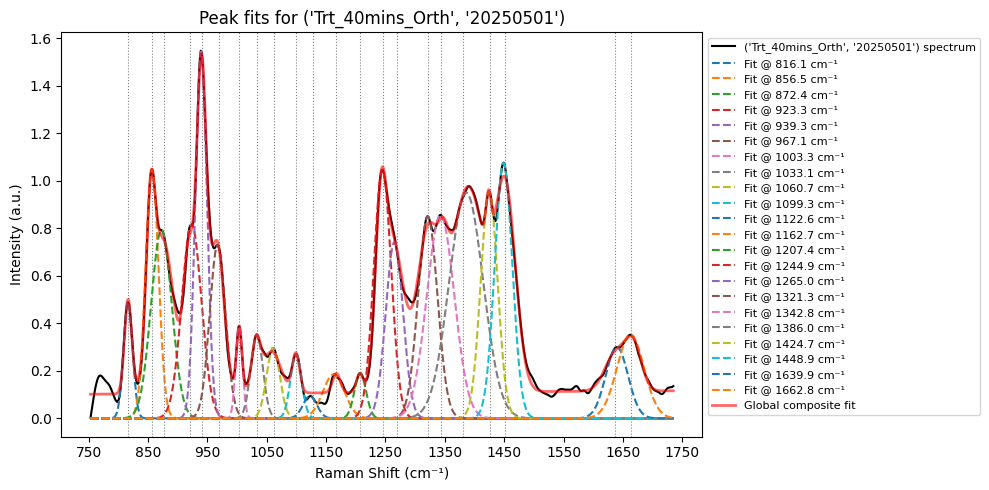

('Trt_40mins_Orth', '20250609') R² of global fit: 0.9926


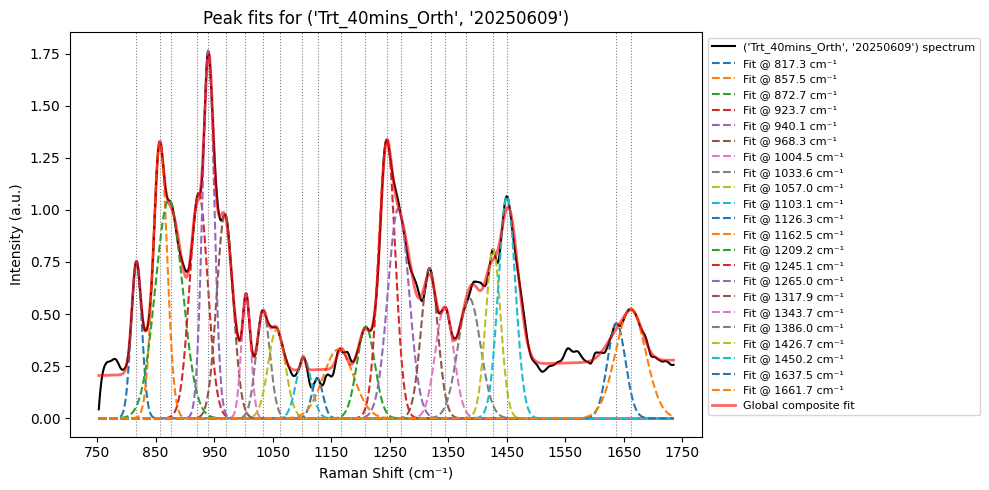

('Trt_40mins_Orth', '20250612') R² of global fit: 0.9954


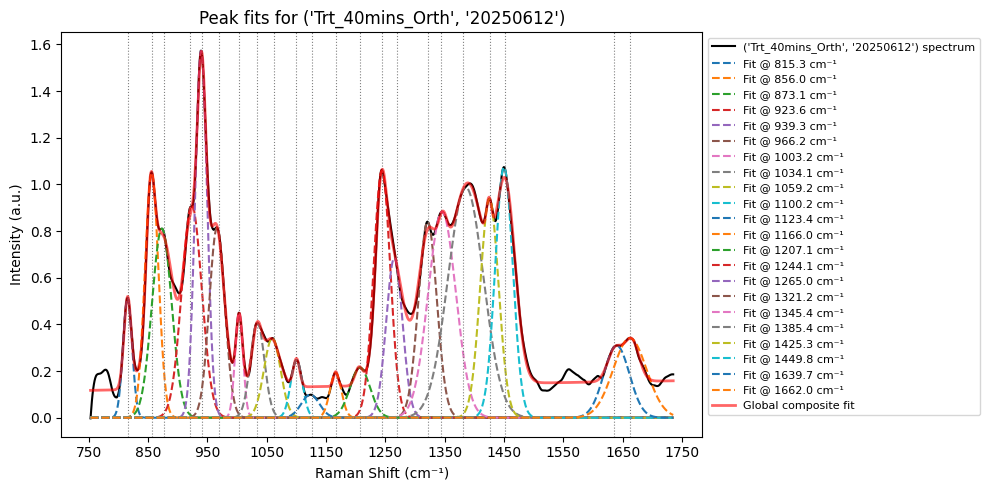

('Trt_40mins_Orth', '20250616') R² of global fit: 0.9949


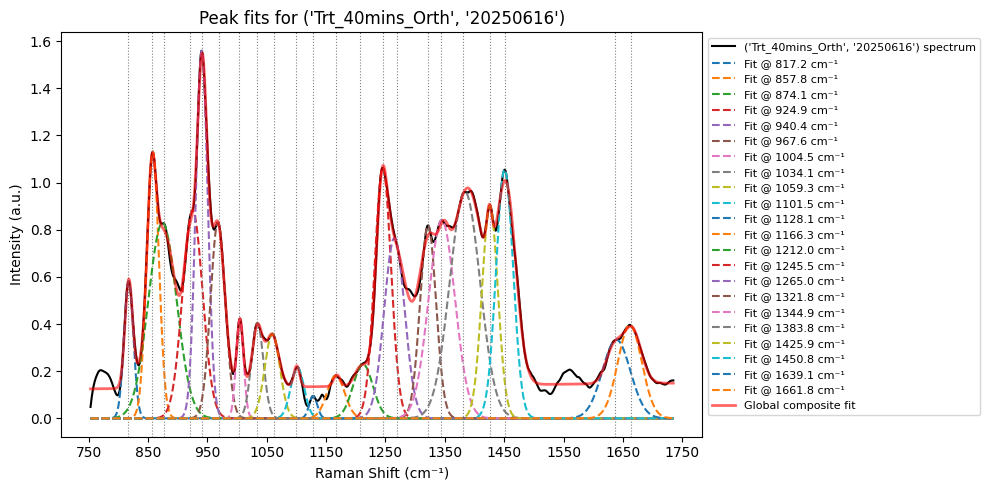

('Trt_40mins_Para', '20250429') R² of global fit: 0.9913


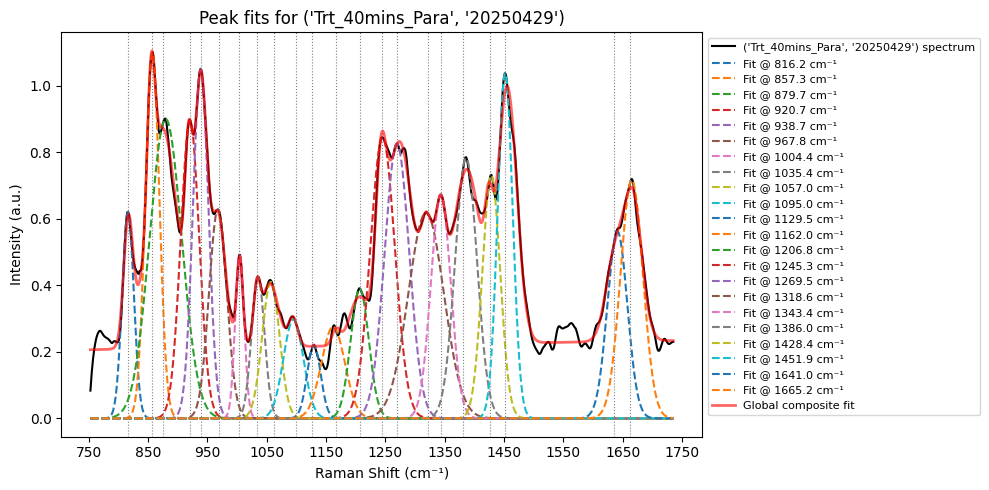

('Trt_40mins_Para', '20250501') R² of global fit: 0.9966


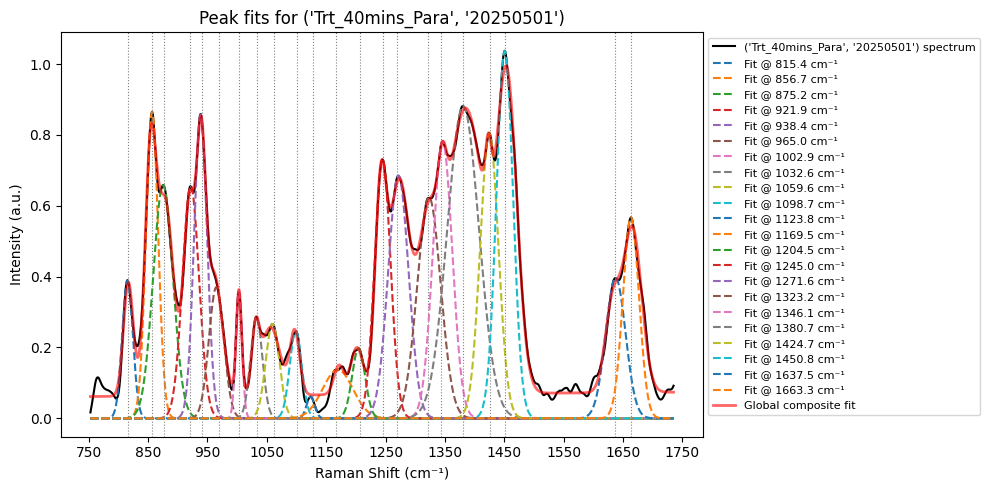

('Trt_40mins_Para', '20250609') R² of global fit: 0.9916


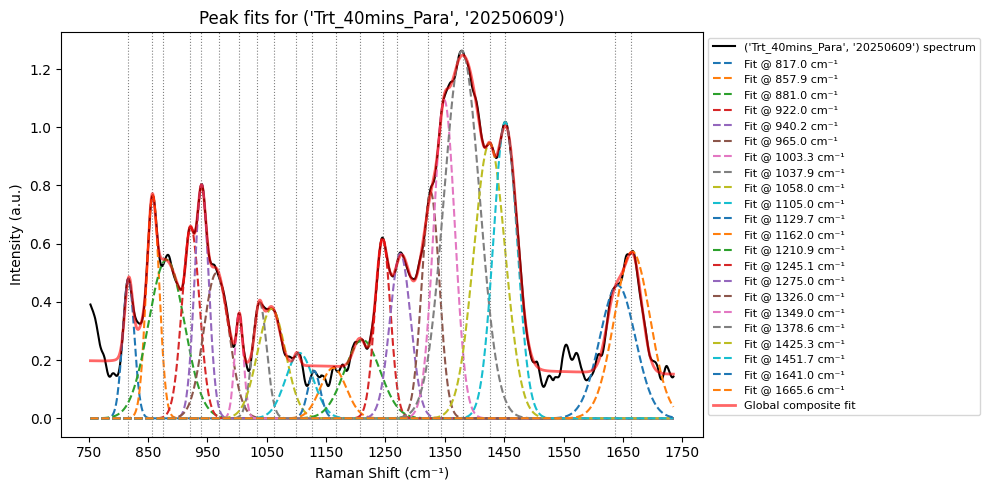

('Trt_40mins_Para', '20250612') R² of global fit: 0.9821


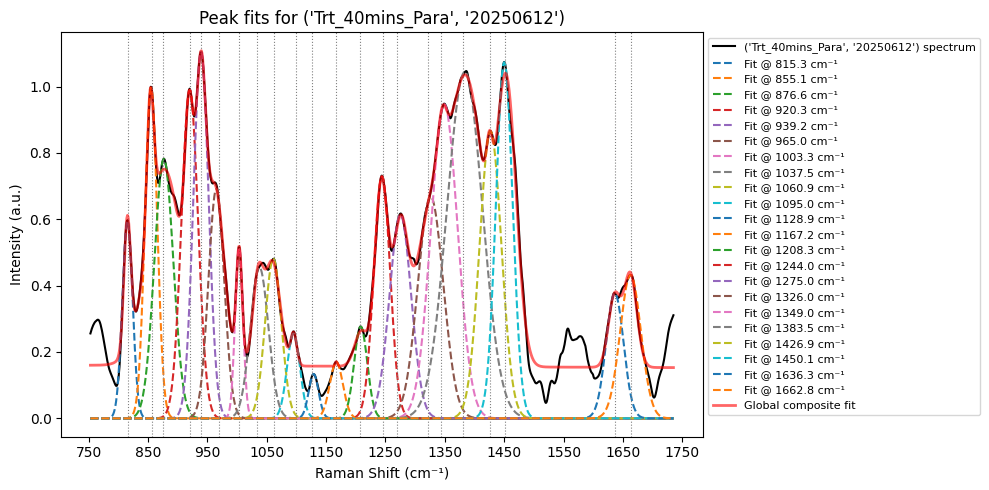

('Trt_40mins_Para', '20250616') R² of global fit: 0.9932


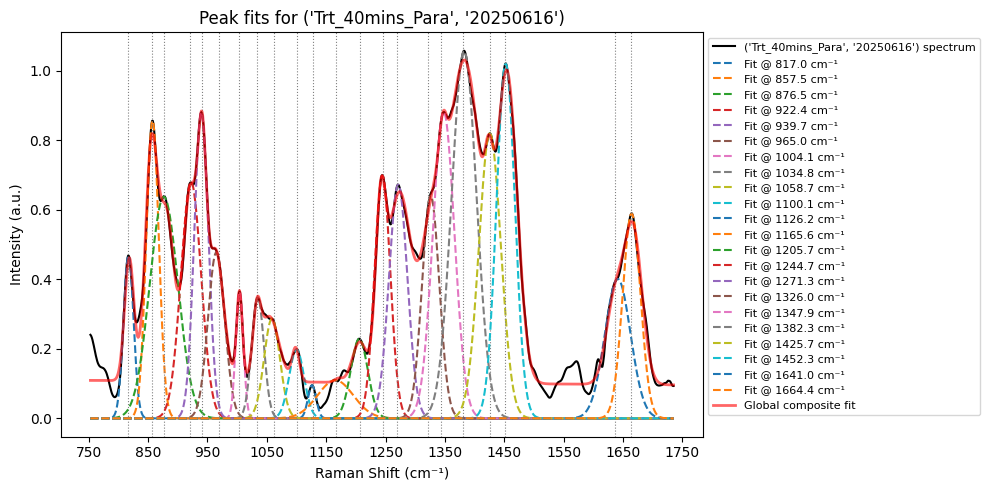

('Trt_60mins24h_Orth', '20250429') R² of global fit: 0.9956


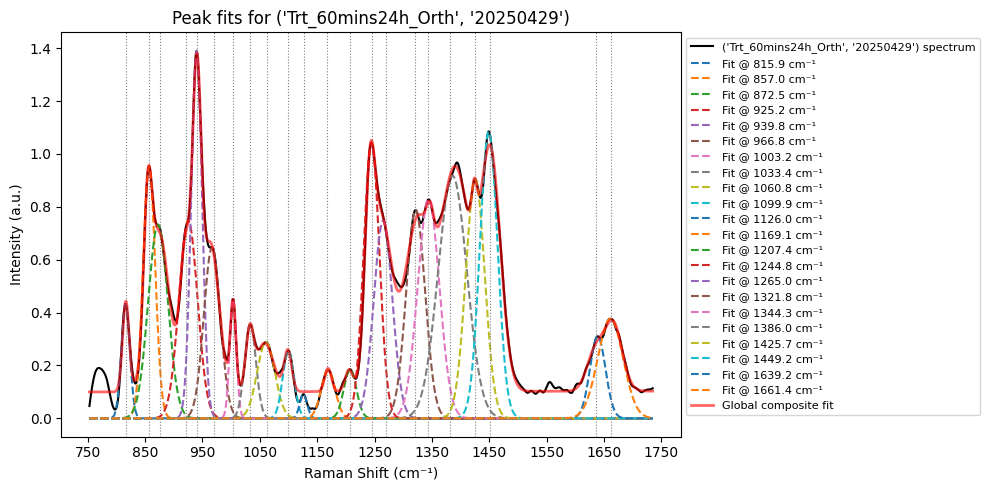

('Trt_60mins24h_Orth', '20250501') R² of global fit: 0.9953


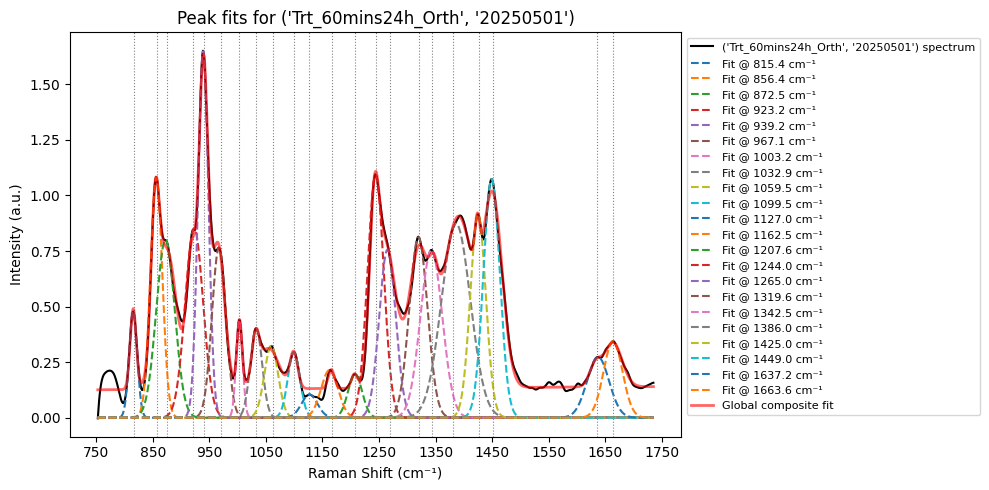

('Trt_60mins24h_Orth', '20250609') R² of global fit: 0.9949


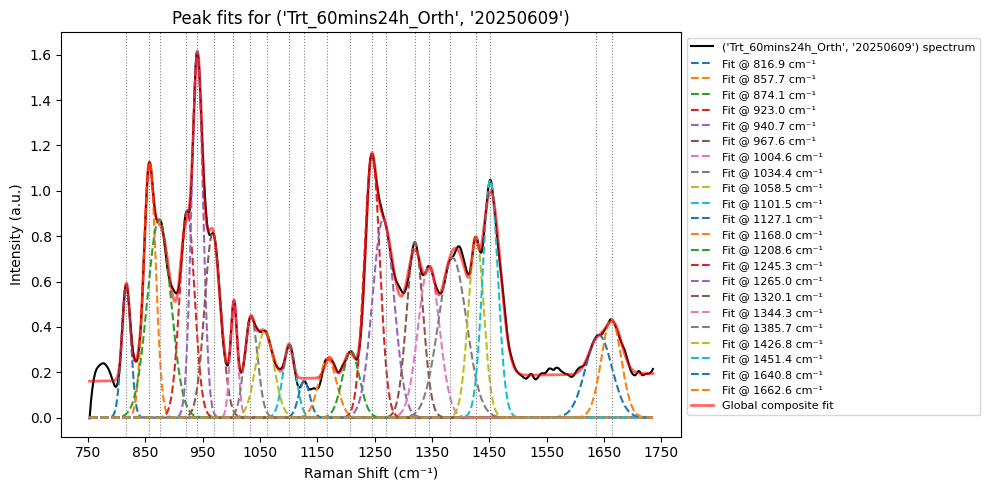

('Trt_60mins24h_Orth', '20250612') R² of global fit: 0.9955


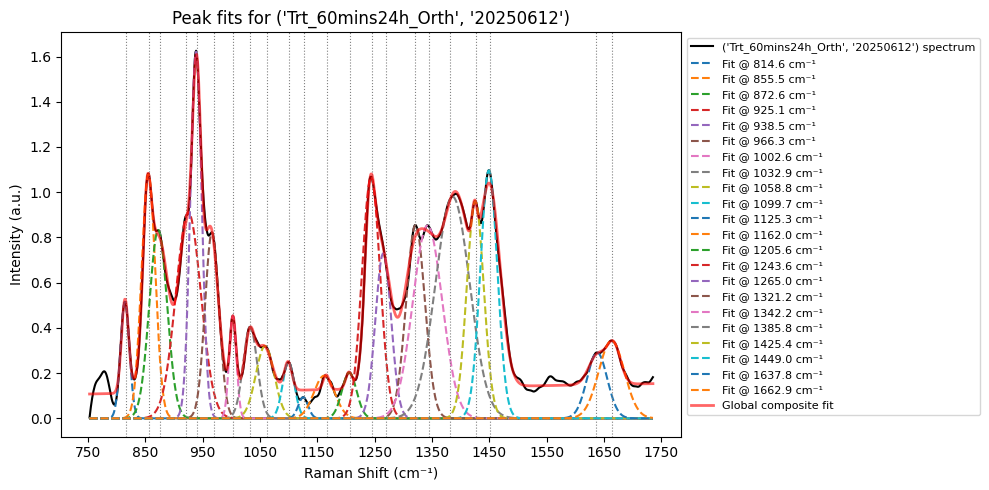

('Trt_60mins24h_Orth', '20250616') R² of global fit: 0.9965


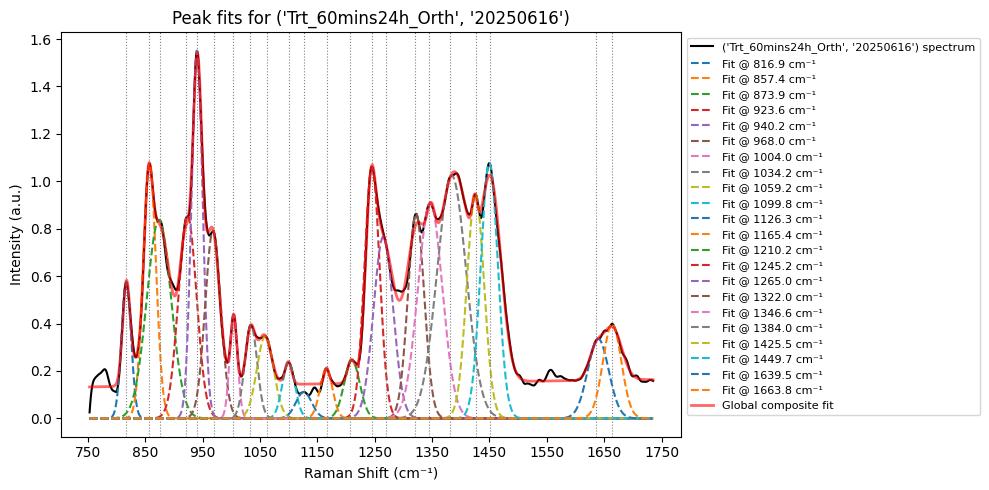

('Trt_60mins24h_Para', '20250429') R² of global fit: 0.9957


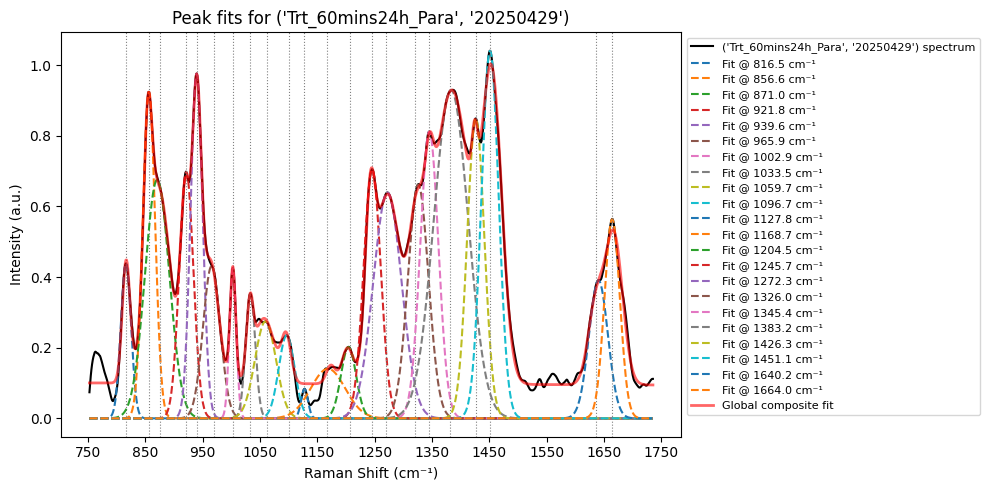

('Trt_60mins24h_Para', '20250501') R² of global fit: 0.9965


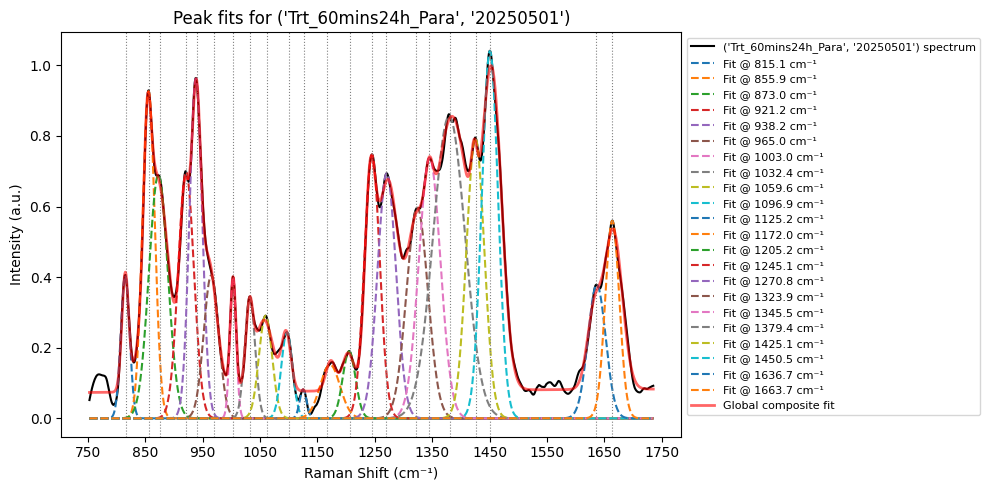

('Trt_60mins24h_Para', '20250609') R² of global fit: 0.9949


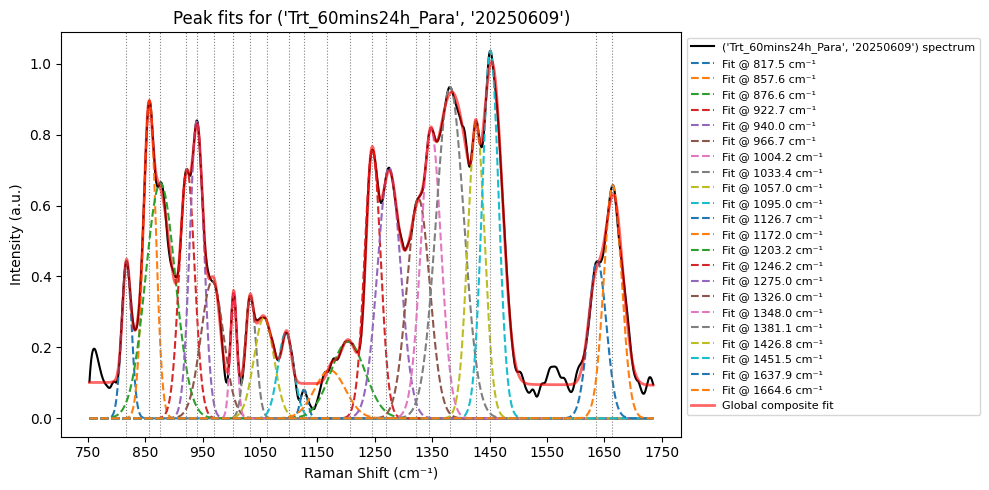

('Trt_60mins24h_Para', '20250612') R² of global fit: 0.9953


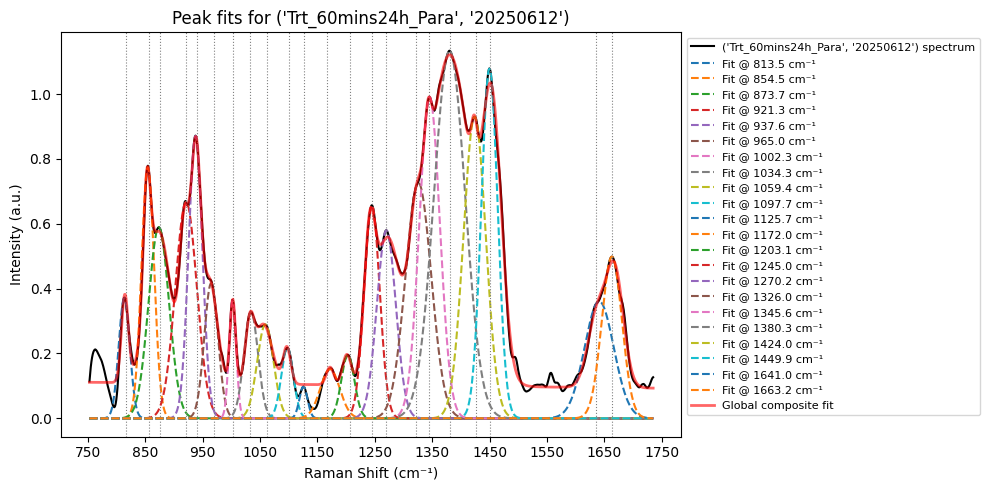

('Trt_60mins24h_Para', '20250616') R² of global fit: 0.9942


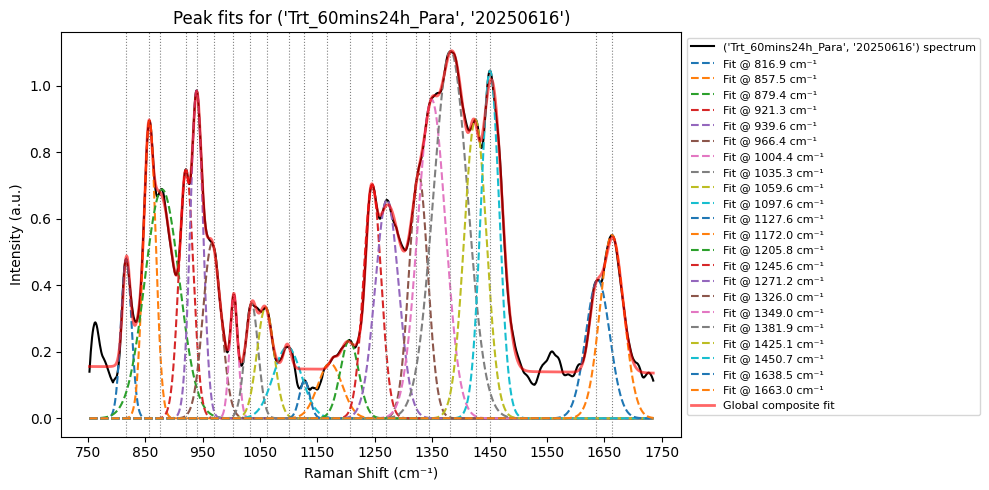

('Trt_60mins_Orth', '20250429') R² of global fit: 0.9952


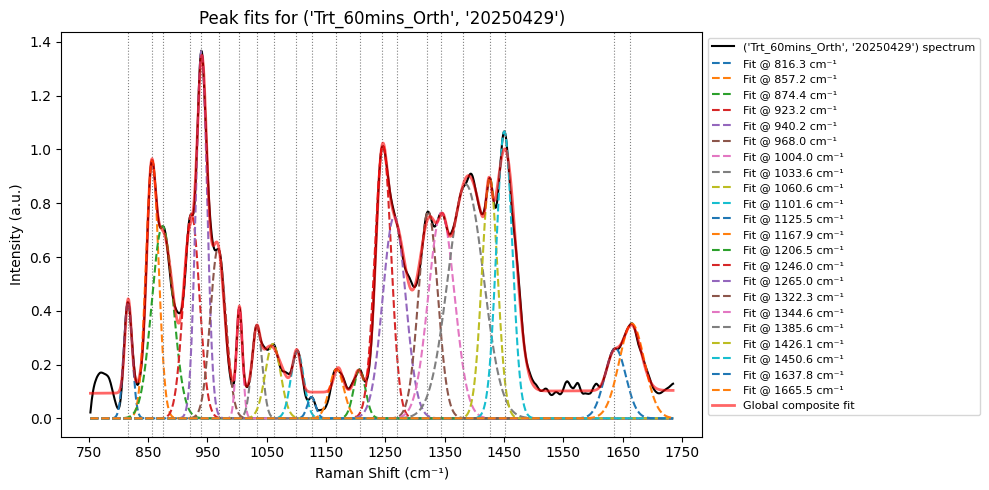

('Trt_60mins_Orth', '20250501') R² of global fit: 0.9959


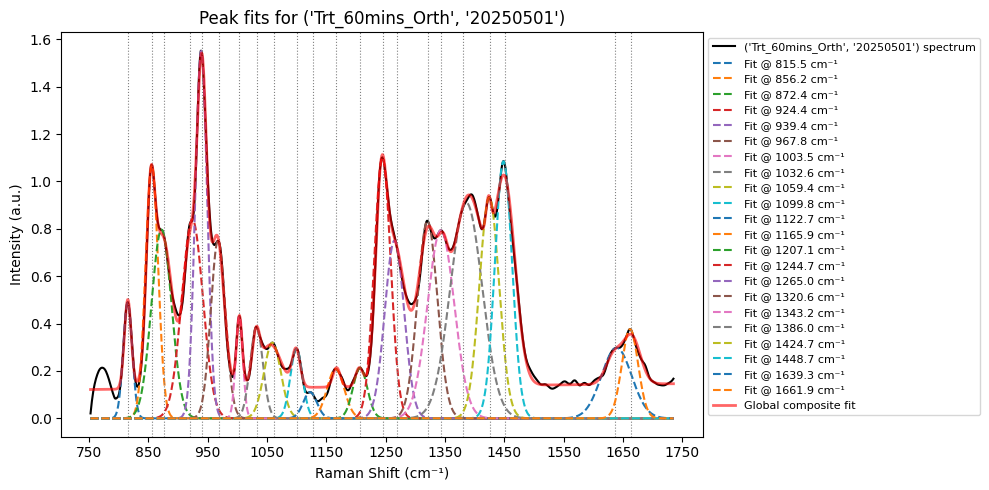

('Trt_60mins_Orth', '20250609') R² of global fit: 0.9946


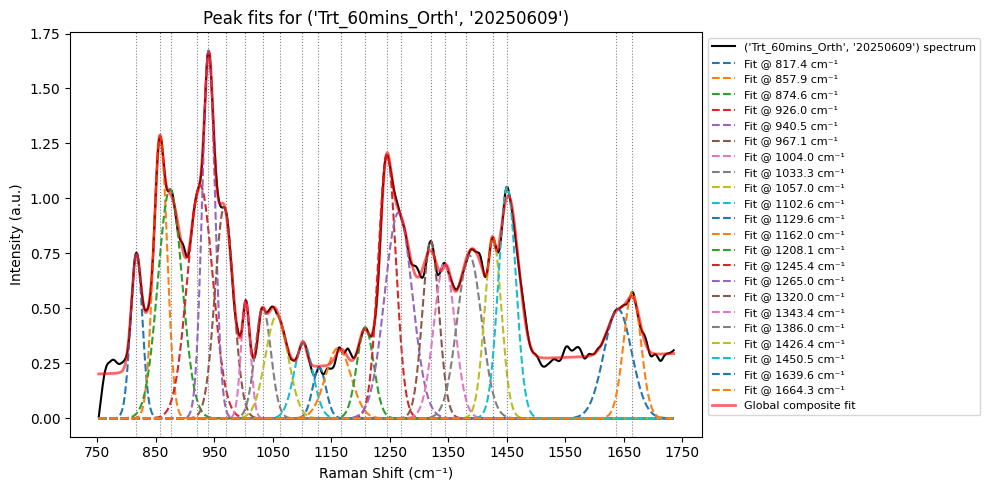

('Trt_60mins_Orth', '20250612') R² of global fit: 0.9955


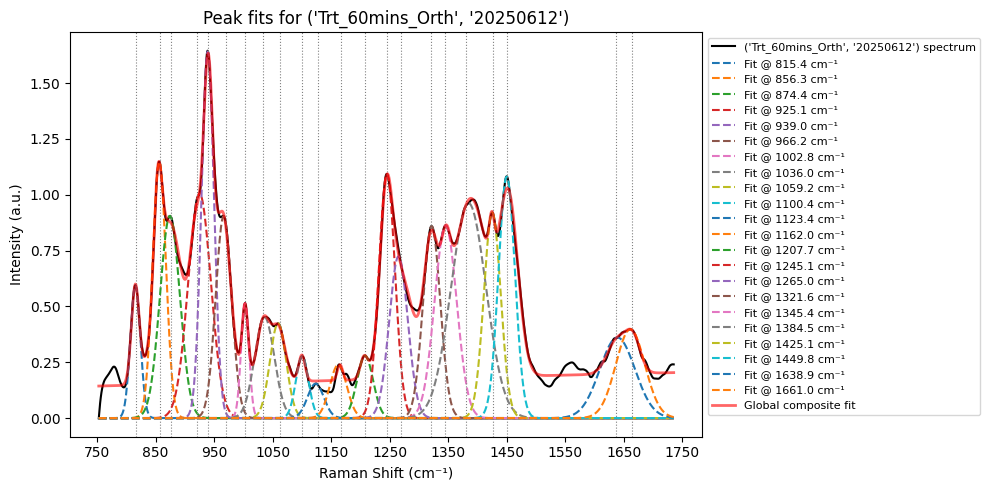

('Trt_60mins_Orth', '20250616') R² of global fit: 0.9966


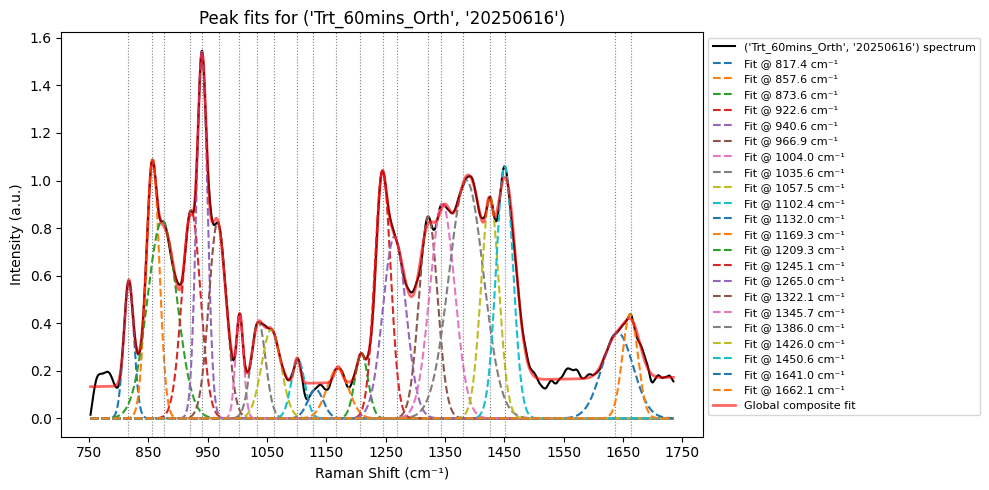

('Trt_60mins_Para', '20250429') R² of global fit: 0.9944


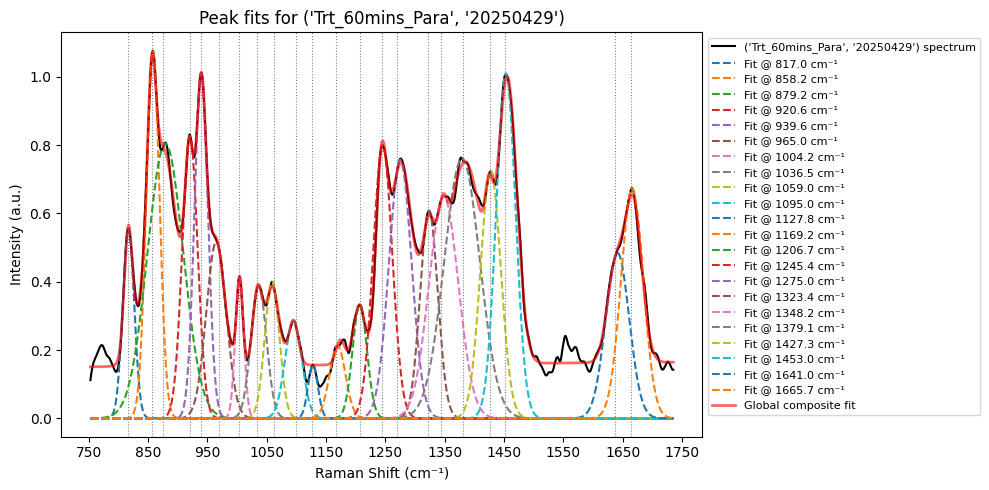

('Trt_60mins_Para', '20250501') R² of global fit: 0.9964


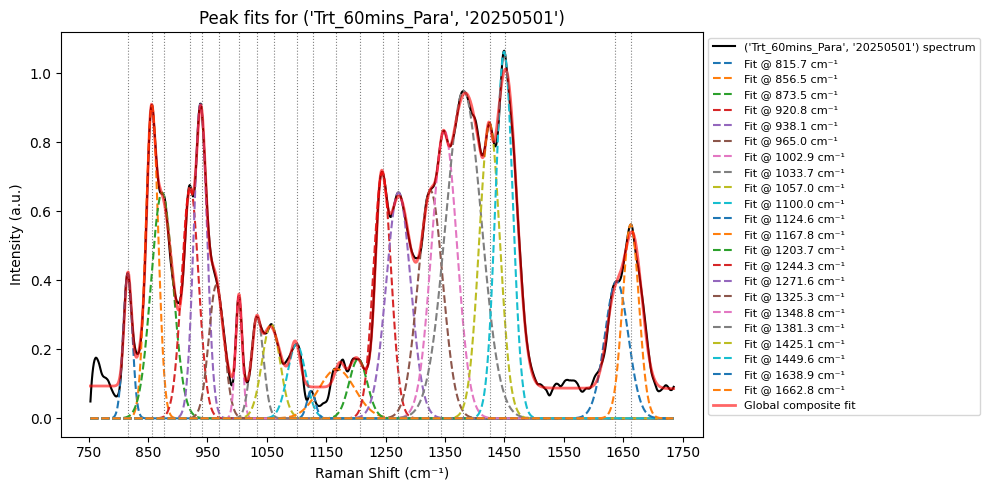

('Trt_60mins_Para', '20250609') R² of global fit: 0.9953


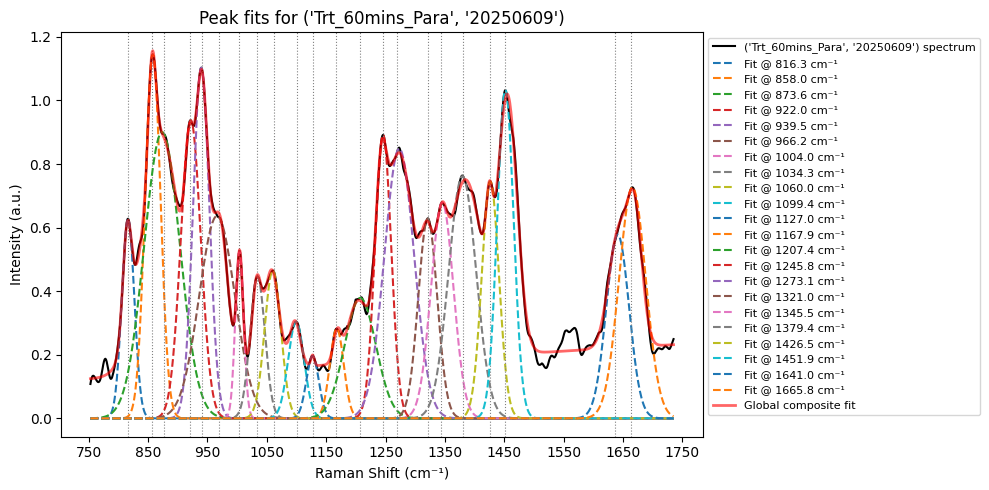

('Trt_60mins_Para', '20250612') R² of global fit: 0.9935


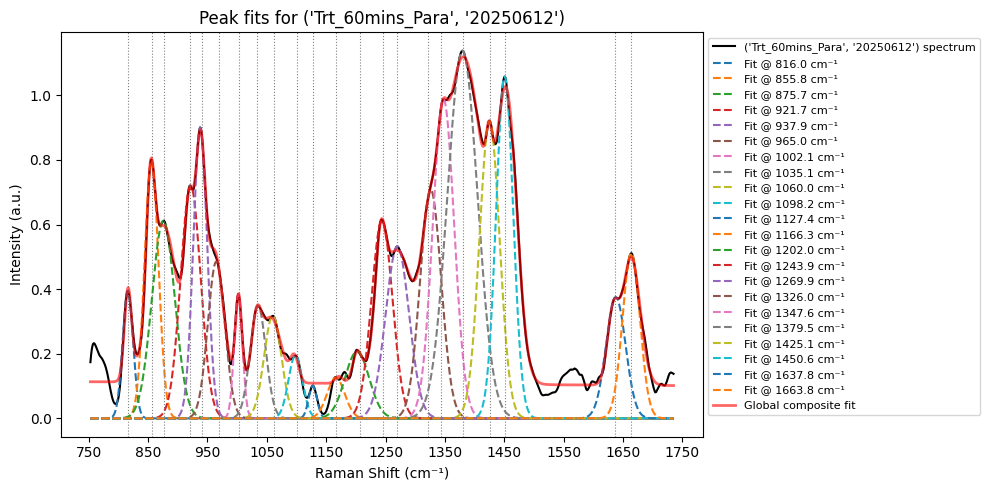

('Trt_60mins_Para', '20250616') R² of global fit: 0.9879


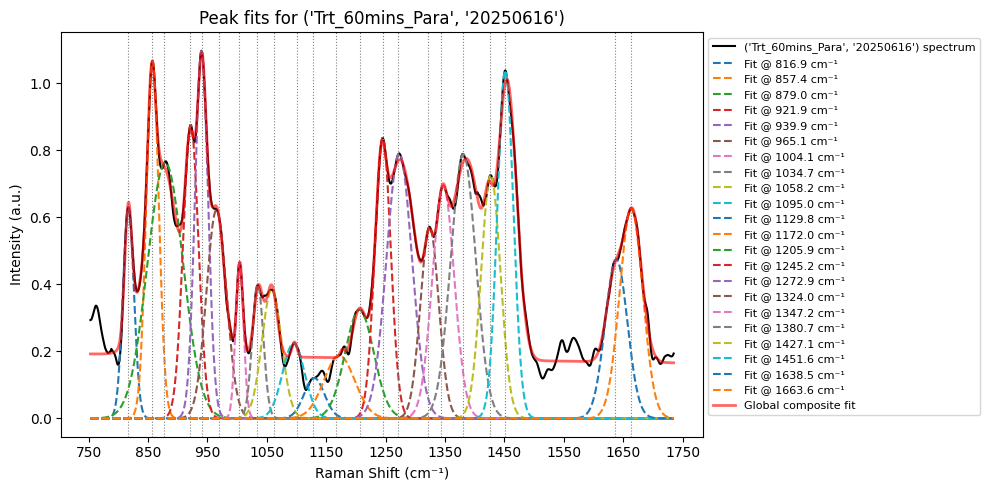

In [74]:
peak_positions = [816, 857, 876, 921, 940, 970, 1003, 1033, 1062, 1100, #1381, 1393, 
                  1127, 1167, 1207, 1245, 1270, 1321, 1344, 1381, 1426, 1451, 1636, 1663]
results = plot_spectra(df, peak_positions)#, model="gaussian"

In [35]:
# --- Example usage ---
#df = pd.read_csv("raman_spectra.csv")  # must include a 'details' column peak_positions = [1000, 1200, 1450, 1650]
peak_positions = [816, 857, 876, 921, 940, 970, 1003, 1033, 1062, 1100, 
                  1127, 1167, 1207, 1245, 1270, 1321, 1344, 1381, 1426, 1451, 1636, 1663]
results = analyze_spectra(df, peak_positions)#, model="gaussian"
#print(results)

In [75]:
result_df#['peak_pos'].unique()

,sample,trt_time,orient,peak_pos,fit_pos,amp,fwhm,area,group
0,Ctrl,20mins,Orth,816,816.680101,0.415721,15.127667,6.694370,Ctrl_20mins_Orth
1,Ctrl,20mins,Orth,816,817.708363,0.421044,16.336997,7.322099,Ctrl_20mins_Orth
2,Ctrl,20mins,Orth,816,817.874865,0.622597,21.997707,14.578747,Ctrl_20mins_Orth
3,Ctrl,20mins,Orth,816,816.442692,0.478246,23.490519,11.958598,Ctrl_20mins_Orth
4,Ctrl,20mins,Orth,816,817.644789,0.609244,18.770113,12.172895,Ctrl_20mins_Orth
...,...,...,...,...,...,...,...,...,...
19311,Trt,60mins,Para,1663,1668.000000,0.605345,39.143665,25.223208,Trt_60mins_Para
19312,Trt,60mins,Para,1663,1665.572641,0.861517,47.670691,43.717066,Trt_60mins_Para
19313,Trt,60mins,Para,1663,1664.357403,0.823978,32.121751,28.174131,Trt_60mins_Para
19314,Trt,60mins,Para,1663,1667.161043,0.626750,46.415556,30.966606,Trt_60mins_Para


In [37]:
dt = results['group'].str.split('_', expand=True).rename({0: 'sample', 1: 'trt_time', 2: 'orient'}, axis=1)
result_df = pd.concat([dt, results], axis=1)

In [64]:
t24[
                (t24['trt_time'].str.contains(tt)) 
                    & (t24['orient']==tp)  
                    & (t24['peak_pos']==p)
                    ].groupby(['sample', 'trt_time']).mean(numeric_only=True)#.iloc[0, :]

,,peak_pos,fit_pos,amp,fwhm,area
sample,trt_time,,,,,
Ctrl,24h,1663.0,1663.346254,0.377064,54.827689,22.123813
Trt,24h,1663.0,1661.756485,0.436839,54.143043,25.970538


In [65]:
t24 = result_df[result_df['trt_time'].str.contains('s24h')==False]

diff_results = []
for p in peak_positions:
    for tp in ['Para', 'Orth']:
        for tt in ['2min','20min', '40min', '60min', '24h']:#, '24h'
            '''treated = result_df[(result_df['trt_time'].str.contains(tt)) 
                    & (result_df['orient']==tp)  
                    & (result_df['peak_pos']==p)
                    ].groupby(['sample', 'trt_time']).mean(numeric_only=True).iloc[2, :]'''
            treated = t24[
                (t24['trt_time'].str.contains(tt)) 
                    & (t24['orient']==tp)  
                    & (t24['peak_pos']==p)
                    ].groupby(['sample', 'trt_time']).mean(numeric_only=True).iloc[1, :]
            ctrl = result_df[
                        (result_df['trt_time'].str.contains(tt)) 
                    & (result_df['orient']==tp)  
                    & (result_df['peak_pos']==p)
                    ].groupby(['sample', 'trt_time']).mean(numeric_only=True).iloc[0, :]
            #print(treated)
            diff_amp = treated['amp'] - ctrl['amp']
            diff_fwhm = treated['fwhm'] - ctrl['fwhm']
            diff_area = treated['area'] - ctrl['area']
            results = {'peak_pos': p,
                       'trt_time': tt,
                       'orient': tp,
                       'diff_amp': diff_amp,
                       'diff_fwhm': diff_fwhm,
                       'diff_area': diff_area
                       }
            diff_results.append(results)

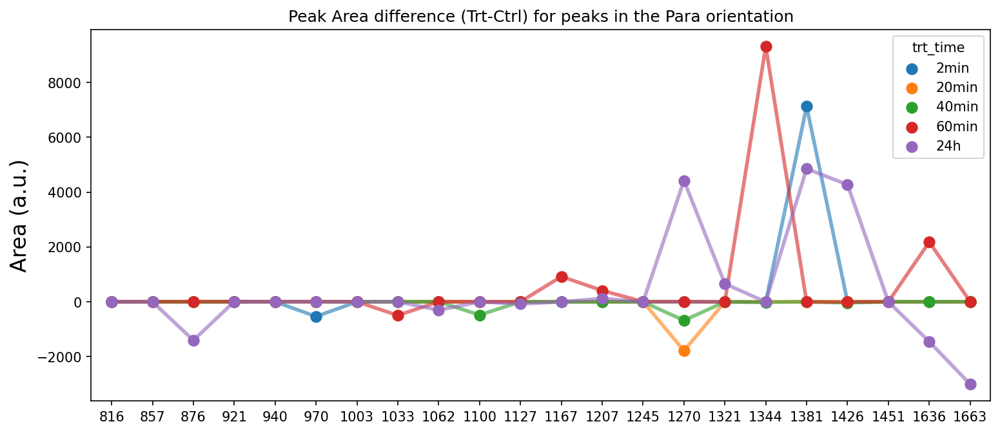

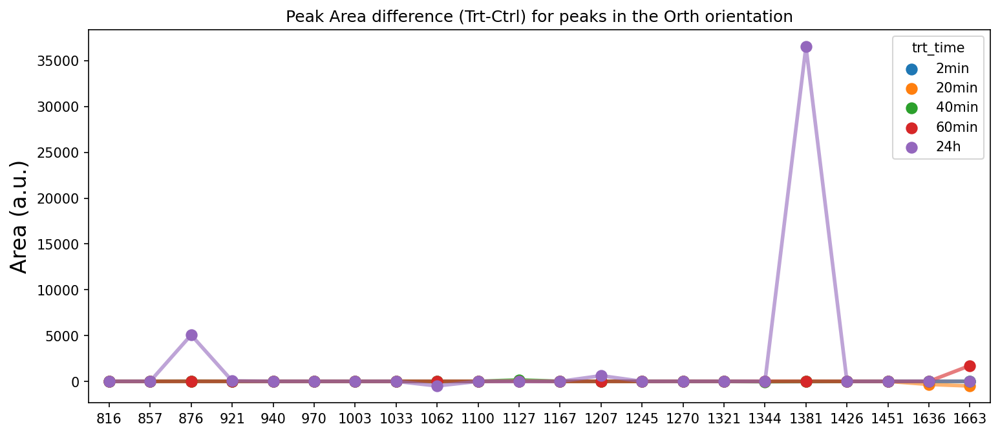

In [66]:
diff_result_df = pd.DataFrame(diff_results)


#for p in peak_positions:
for tp in diff_result_df['orient'].unique():
    plt.figure(figsize = (12, 5), dpi = 150);
    ax = sns.pointplot(
                    data = diff_result_df[(diff_result_df['orient']==tp) 
                                         # & (diff_result_df['peak_pos'].isin([1344, 1381]) == False)
                                          ],
                        x = 'peak_pos',
                        y = 'diff_area',
                        hue = 'trt_time',
                        order = [ 816,  857,  876,  921,  940,  970, 1003, 1033, 1062, 1100, 1127,
                                  1167, 1207, 1245, 1270, 1321, 1344, 1381, 1426, 1451, 1636, 1663],#1344,
                        #['2mins','20mins', '40mins', '60mins', '24h'],
                           # width = .5,
                            #dodge = .5, 
                            #linewidth = 2,
                            #marker_kws={'edgecolor': 'gray', 'linewidth': 1},
                           #alpha = .6,
                           errorbar='se'
                    );
    for line in ax.lines:
      line.set_alpha(0.6)
    plt.title(f'Peak Area difference (Trt-Ctrl) for peaks in the {tp} orientation')
    plt.ylabel('Area (a.u.)', fontsize = 16)
    plt.xlabel('')

C:\Users\oadeji01\AppData\Local\Temp\ipykernel_1376\874550747.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize = (10, 5), dpi = 150);


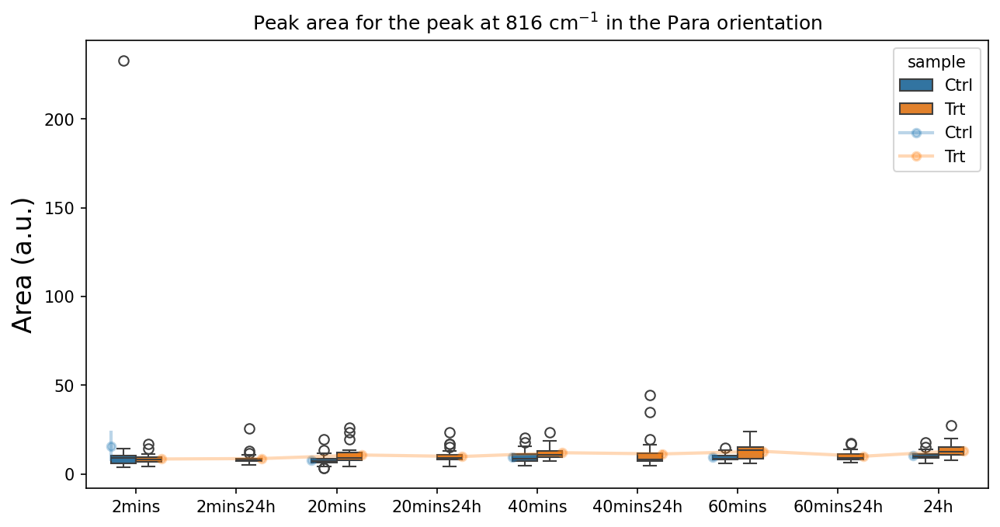

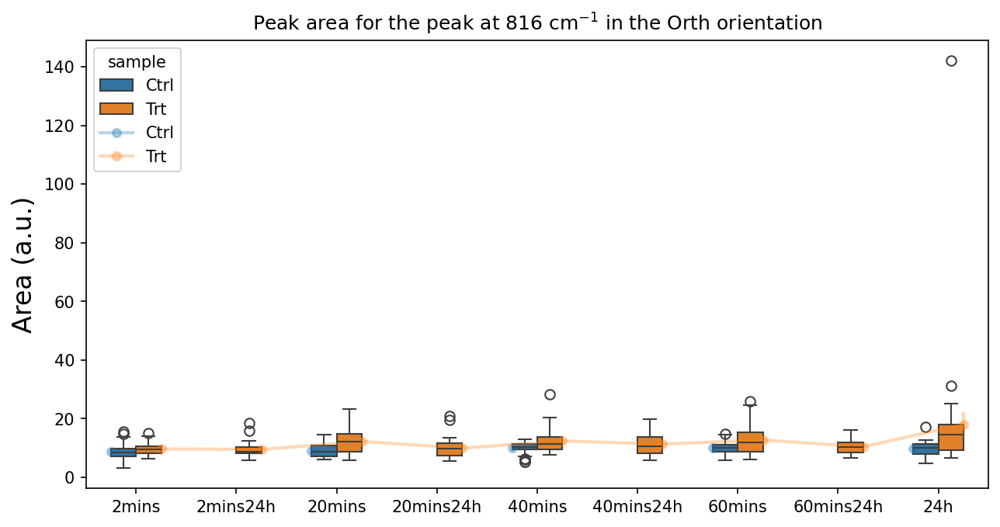

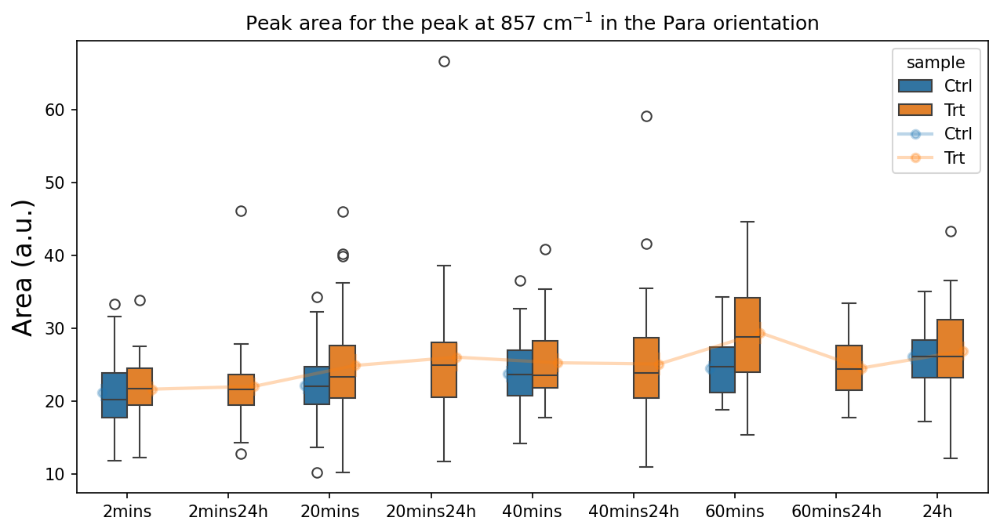

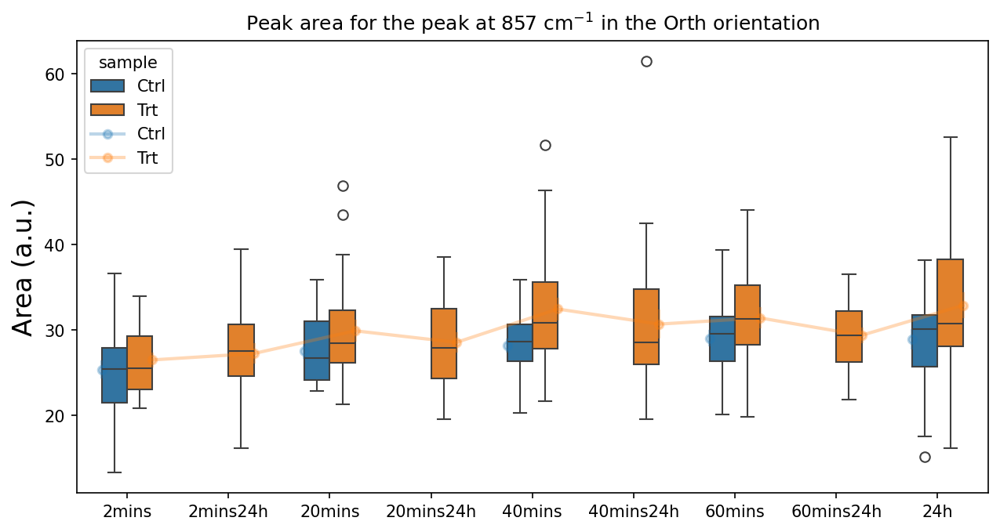

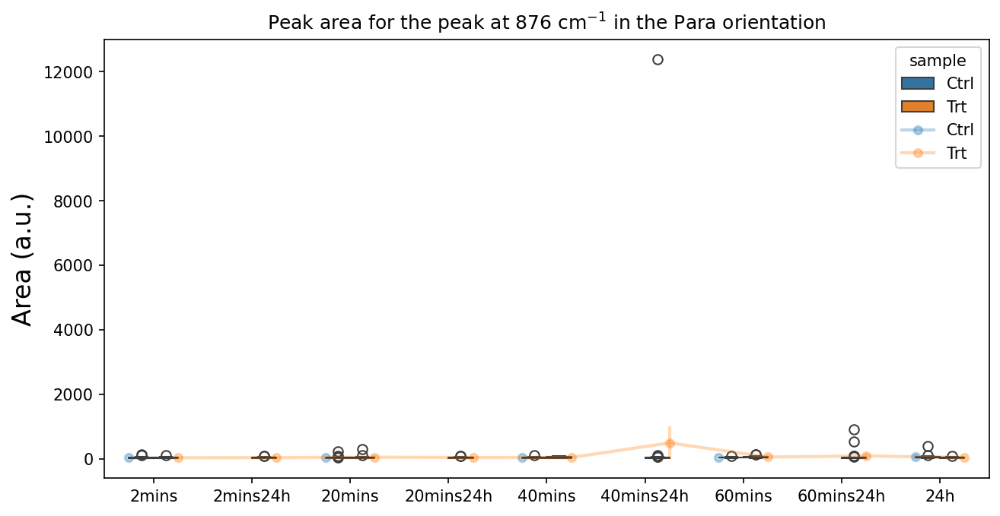

...

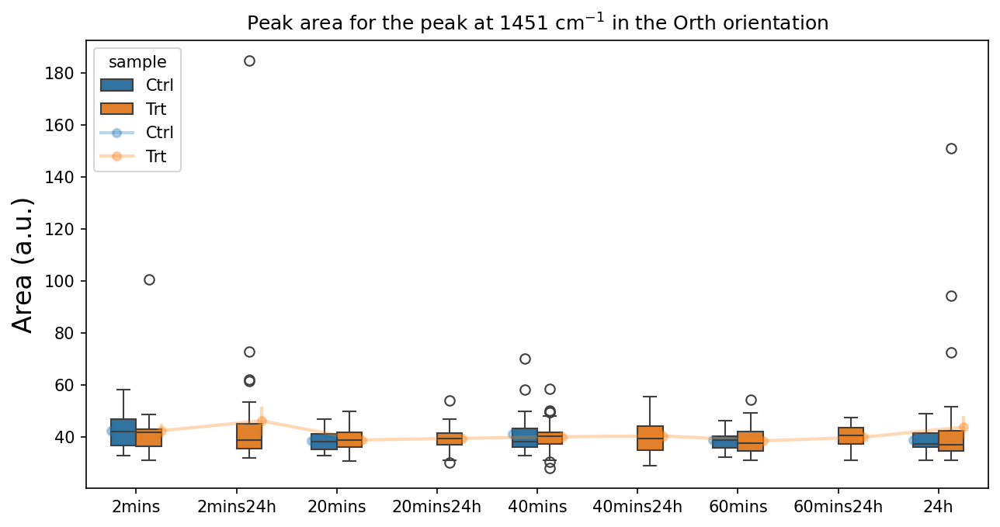

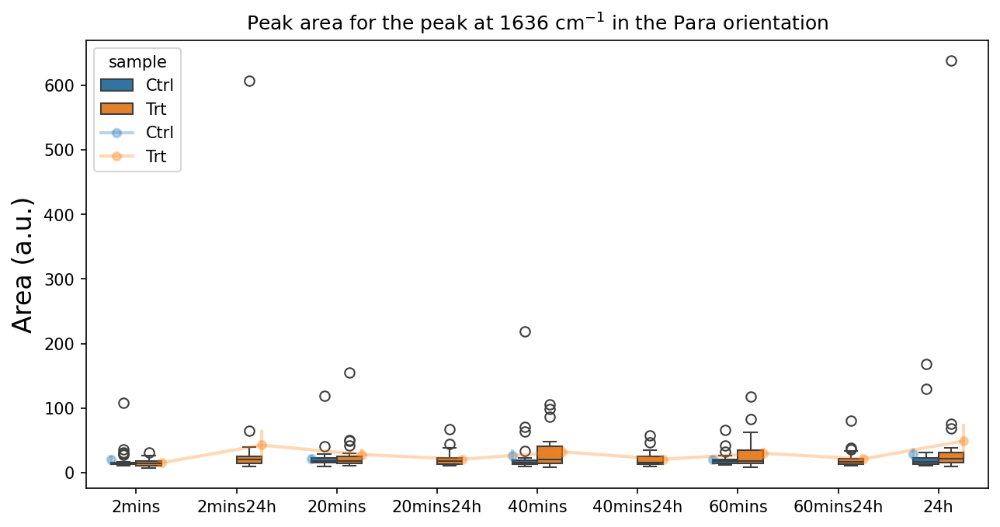

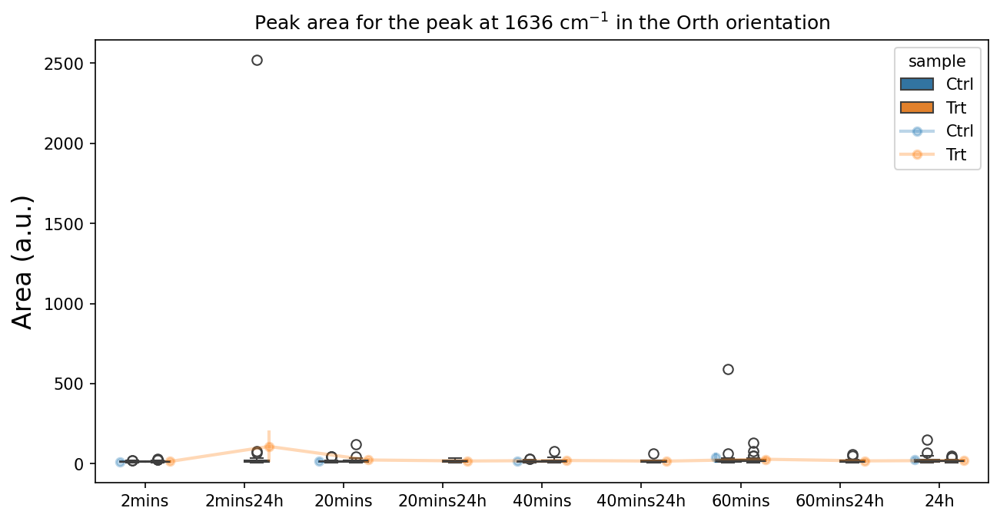

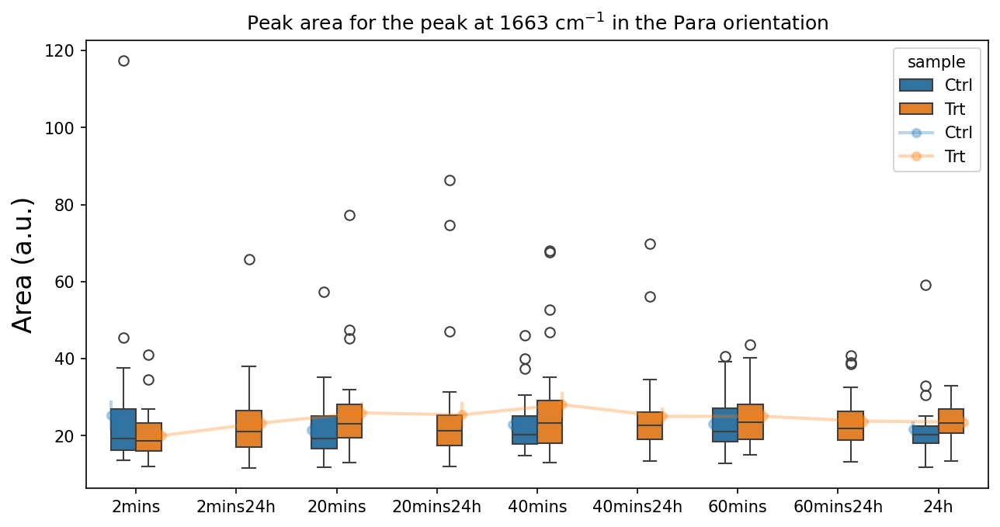

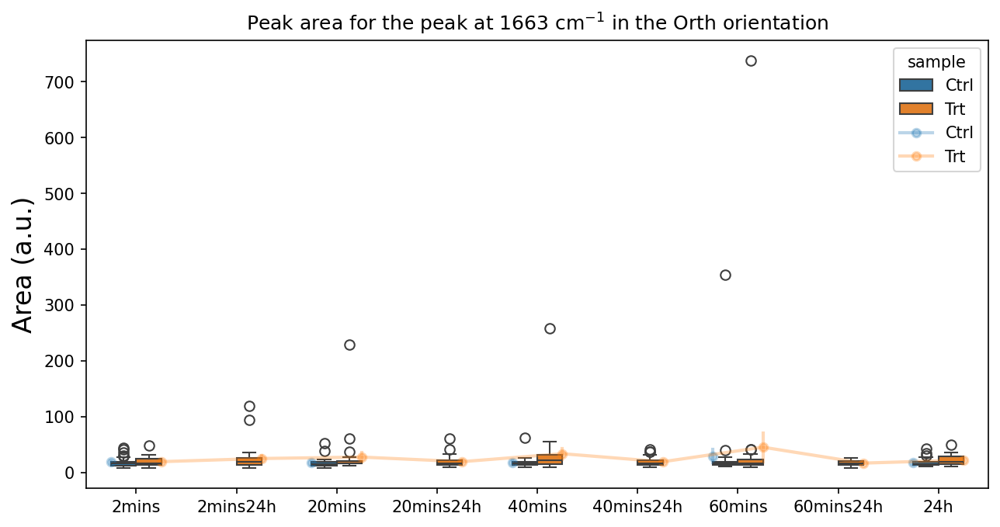

In [ ]:
for p in peak_positions:
    for j, tp in enumerate(['Para', 'Orth']):
        plt.figure(figsize = (10, 5), dpi = 150);
        dtt = result_df[(result_df['orient'].str.contains(tp)) & 
                                    (result_df['peak_pos'] == p) &
                                    (result_df['area']<= 100) #&
                                    #(result_df[''])
                                    ]
                #plt.figure(figsize = (15, 9), dpi = 150);
        sns.boxplot(
                    data = dtt,
                        x = 'trt_time',
                        y = 'area',
                        hue = 'sample',
                        order = ['2mins','2mins24h','20mins', '20mins24h','40mins', '40mins24h',  '60mins', 
                            '60mins24h', '24h'],
                            width = .5,
                           #alpha = .5
                    );
        sns.pointplot(
                    data = dtt,
                        x = 'trt_time',
                        y = 'area',
                        hue = 'sample',
                        order = ['2mins','2mins24h','20mins', '20mins24h','40mins', '40mins24h',  '60mins', 
                            '60mins24h', '24h'],
                            dodge = .5, linewidth = 2,
                            #marker_kws={'edgecolor': 'gray', 'linewidth': 1},
                           alpha = .3,
                           errorbar='se'
                    );
        plt.title(f'Peak area for the peak at {p} cm$^{{-1}}$ in the {tp} orientation')
        plt.ylabel('Area (a.u.)', fontsize = 16)
        plt.xlabel('')

In [141]:
from statsmodels.stats.multicomp import pairwise_tukeyhsd
for p in peak_positions:
    dtt = result_df[(result_df['orient'].str.contains('Orth')) & 
                                    (result_df['peak_pos'] == p) #&
                                    #(result_df['area']<= 100)
                                    ]
    # perform Tukey's test
    tukey = pairwise_tukeyhsd(endog=dtt['area'],
                            groups=dtt['sample'],
                            alpha=0.05)

    #display results
    print(f'Tukey HSD results for peak at {p} cm$^{-1}$ in the Parallel Orientation')
    print(tukey)
    print('*******************************************************************************')

Tukey HSD results for peak at 857 cm$^-1$ in the Parallel Orientation
Multiple Comparison of Means - Tukey HSD, FWER=0.05 
group1 group2 meandiff p-adj   lower   upper  reject
----------------------------------------------------
  Ctrl    Trt   4.8435 0.1107 -1.1118 10.7988  False
----------------------------------------------------
*******************************************************************************
Tukey HSD results for peak at 921 cm$^-1$ in the Parallel Orientation
 Multiple Comparison of Means - Tukey HSD, FWER=0.05 
group1 group2 meandiff p-adj   lower   upper   reject
-----------------------------------------------------
  Ctrl    Trt   89.452 0.0611 -4.2016 183.1055  False
-----------------------------------------------------
*******************************************************************************
Tukey HSD results for peak at 940 cm$^-1$ in the Parallel Orientation
Multiple Comparison of Means - Tukey HSD, FWER=0.05
group1 group2 meandiff p-adj lower  upper  

In [62]:
fit_mean = result_df.groupby(['sample', 'trt_time', 'orient', 'peak_pos']).mean(numeric_only=True).reset_index()
fit_mean[fit_mean]

,sample,trt_time,orient,peak_pos,fit_pos,amp,fwhm,area
0,Ctrl,20mins,Orth,816,816.271744,0.477713,17.637239,9.019748
1,Ctrl,20mins,Orth,857,857.371105,1.044817,24.732490,27.517565
2,Ctrl,20mins,Orth,876,869.636035,0.800166,48.502113,42.369207
3,Ctrl,20mins,Orth,921,931.829312,1.040894,43.102532,86.034180
4,Ctrl,20mins,Orth,940,939.909825,1.518372,22.142293,35.774184
...,...,...,...,...,...,...,...,...
499,Trt,60mins24h,Para,1381,1380.639999,1.006521,78.969080,85.305304
500,Trt,60mins24h,Para,1426,1426.009176,0.867564,46.439438,42.961632
501,Trt,60mins24h,Para,1451,1450.422534,1.048991,38.113217,42.530575
502,Trt,60mins24h,Para,1636,1638.059460,0.413491,48.799765,21.181013


C:\Users\oadeji01\AppData\Local\Temp\ipykernel_27900\2422181490.py:23: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([label.get_text()[9:] for label in ax.get_xticklabels()]);
C:\Users\oadeji01\AppData\Local\Temp\ipykernel_27900\2422181490.py:23: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([label.get_text()[9:] for label in ax.get_xticklabels()]);
C:\Users\oadeji01\AppData\Local\Temp\ipykernel_27900\2422181490.py:23: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([label.get_text()[9:] for label in ax.get_xticklabels()]);
C:\Users\oadeji01\AppData\Local\Temp\ipykernel_27900\2422181490.py:23: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after s

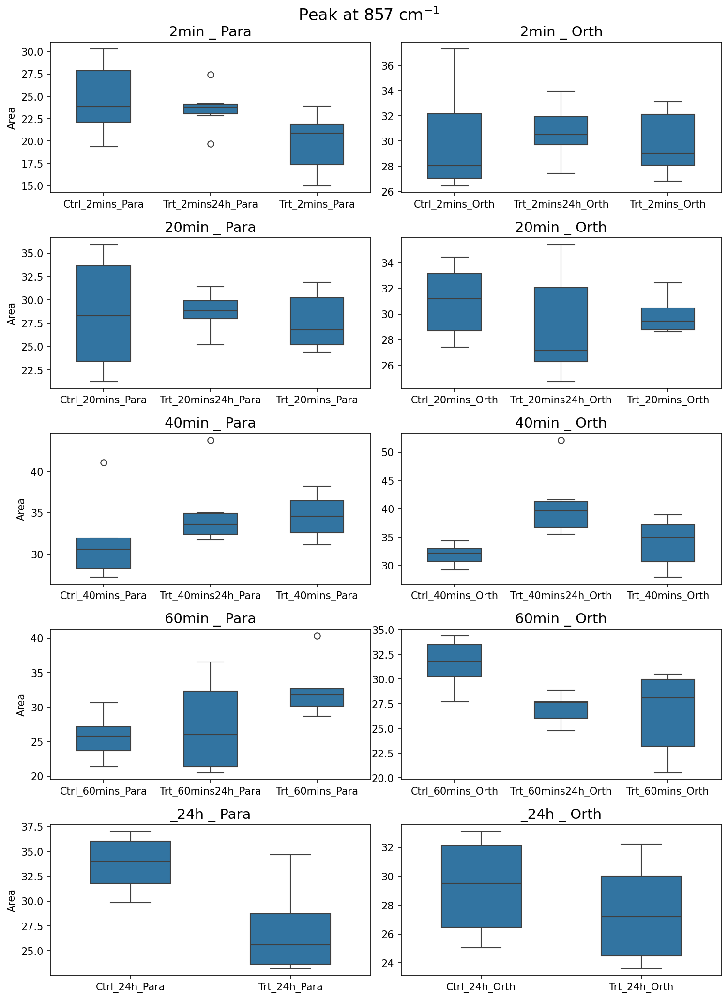

C:\Users\oadeji01\AppData\Local\Temp\ipykernel_27900\2422181490.py:23: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([label.get_text()[9:] for label in ax.get_xticklabels()]);
C:\Users\oadeji01\AppData\Local\Temp\ipykernel_27900\2422181490.py:23: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([label.get_text()[9:] for label in ax.get_xticklabels()]);
C:\Users\oadeji01\AppData\Local\Temp\ipykernel_27900\2422181490.py:23: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([label.get_text()[9:] for label in ax.get_xticklabels()]);
C:\Users\oadeji01\AppData\Local\Temp\ipykernel_27900\2422181490.py:23: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after s

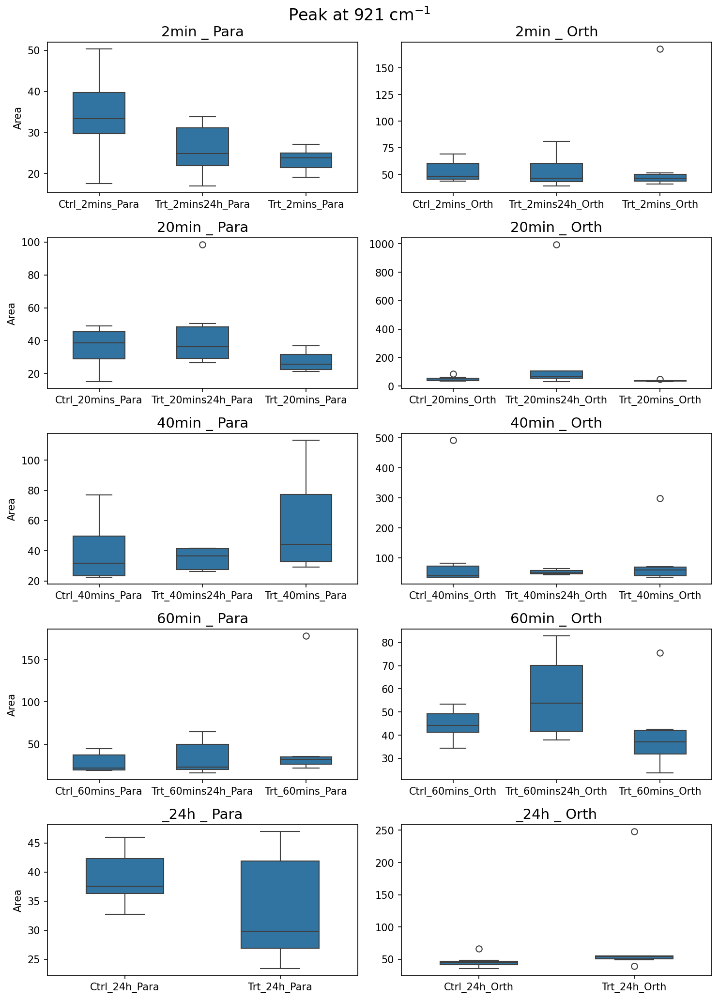

C:\Users\oadeji01\AppData\Local\Temp\ipykernel_27900\2422181490.py:23: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([label.get_text()[9:] for label in ax.get_xticklabels()]);
C:\Users\oadeji01\AppData\Local\Temp\ipykernel_27900\2422181490.py:23: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([label.get_text()[9:] for label in ax.get_xticklabels()]);
C:\Users\oadeji01\AppData\Local\Temp\ipykernel_27900\2422181490.py:23: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([label.get_text()[9:] for label in ax.get_xticklabels()]);
C:\Users\oadeji01\AppData\Local\Temp\ipykernel_27900\2422181490.py:23: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after s

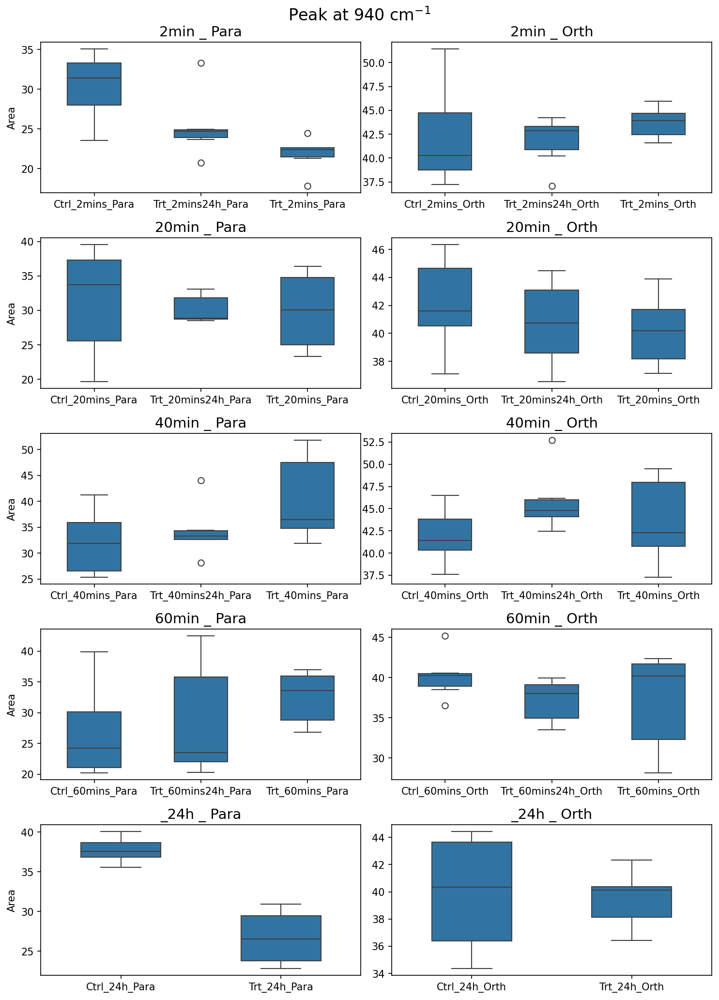

C:\Users\oadeji01\AppData\Local\Temp\ipykernel_27900\2422181490.py:23: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([label.get_text()[9:] for label in ax.get_xticklabels()]);
C:\Users\oadeji01\AppData\Local\Temp\ipykernel_27900\2422181490.py:23: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([label.get_text()[9:] for label in ax.get_xticklabels()]);
C:\Users\oadeji01\AppData\Local\Temp\ipykernel_27900\2422181490.py:23: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([label.get_text()[9:] for label in ax.get_xticklabels()]);
C:\Users\oadeji01\AppData\Local\Temp\ipykernel_27900\2422181490.py:23: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after s

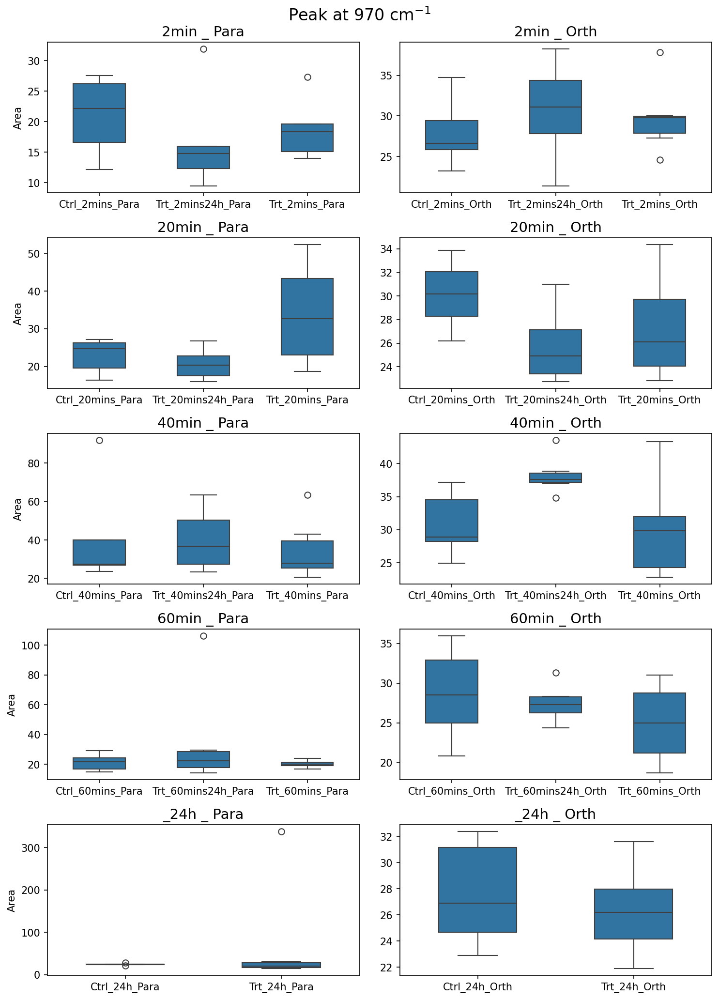

C:\Users\oadeji01\AppData\Local\Temp\ipykernel_27900\2422181490.py:23: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([label.get_text()[9:] for label in ax.get_xticklabels()]);
C:\Users\oadeji01\AppData\Local\Temp\ipykernel_27900\2422181490.py:23: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([label.get_text()[9:] for label in ax.get_xticklabels()]);
C:\Users\oadeji01\AppData\Local\Temp\ipykernel_27900\2422181490.py:23: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([label.get_text()[9:] for label in ax.get_xticklabels()]);
C:\Users\oadeji01\AppData\Local\Temp\ipykernel_27900\2422181490.py:23: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after s

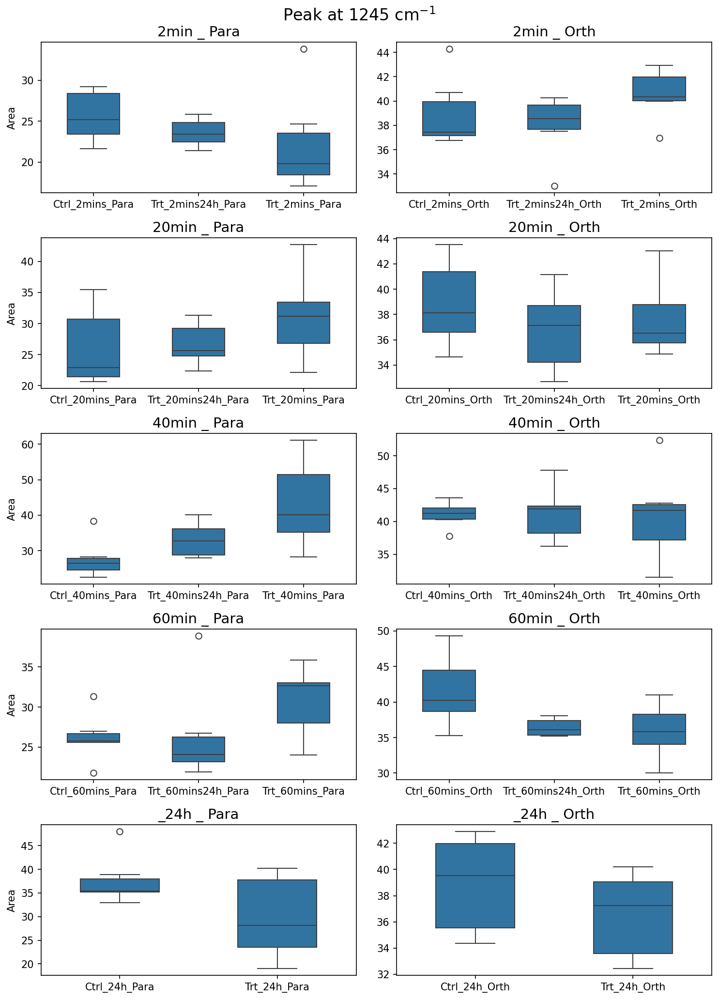

C:\Users\oadeji01\AppData\Local\Temp\ipykernel_27900\2422181490.py:23: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([label.get_text()[9:] for label in ax.get_xticklabels()]);
C:\Users\oadeji01\AppData\Local\Temp\ipykernel_27900\2422181490.py:23: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([label.get_text()[9:] for label in ax.get_xticklabels()]);
C:\Users\oadeji01\AppData\Local\Temp\ipykernel_27900\2422181490.py:23: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([label.get_text()[9:] for label in ax.get_xticklabels()]);
C:\Users\oadeji01\AppData\Local\Temp\ipykernel_27900\2422181490.py:23: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after s

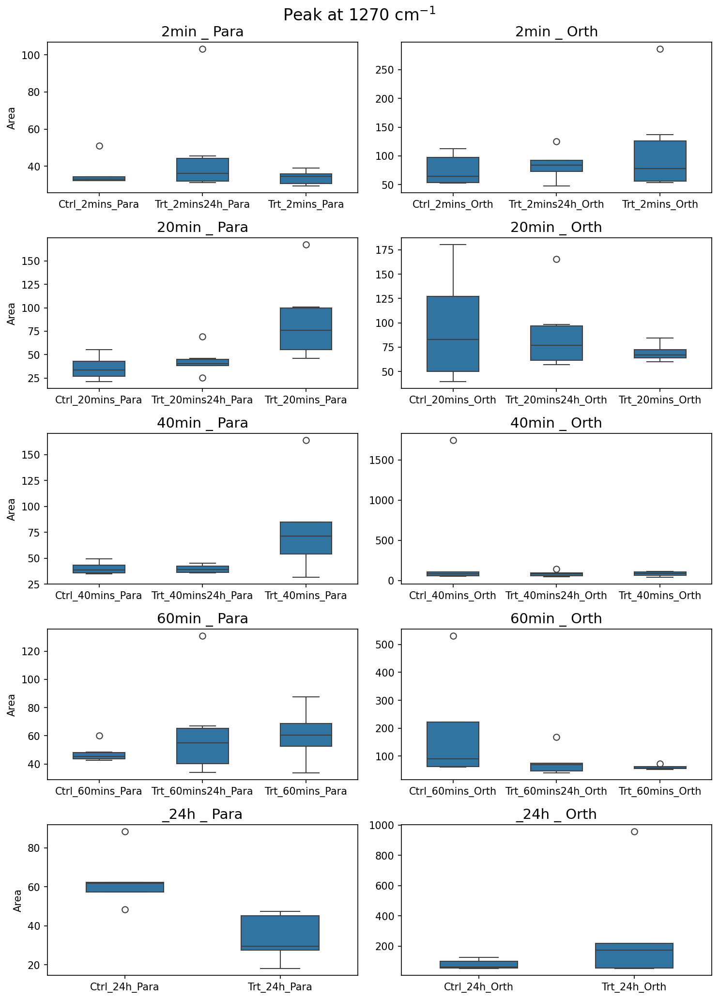

C:\Users\oadeji01\AppData\Local\Temp\ipykernel_27900\2422181490.py:23: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([label.get_text()[9:] for label in ax.get_xticklabels()]);
C:\Users\oadeji01\AppData\Local\Temp\ipykernel_27900\2422181490.py:23: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([label.get_text()[9:] for label in ax.get_xticklabels()]);
C:\Users\oadeji01\AppData\Local\Temp\ipykernel_27900\2422181490.py:23: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([label.get_text()[9:] for label in ax.get_xticklabels()]);
C:\Users\oadeji01\AppData\Local\Temp\ipykernel_27900\2422181490.py:23: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after s

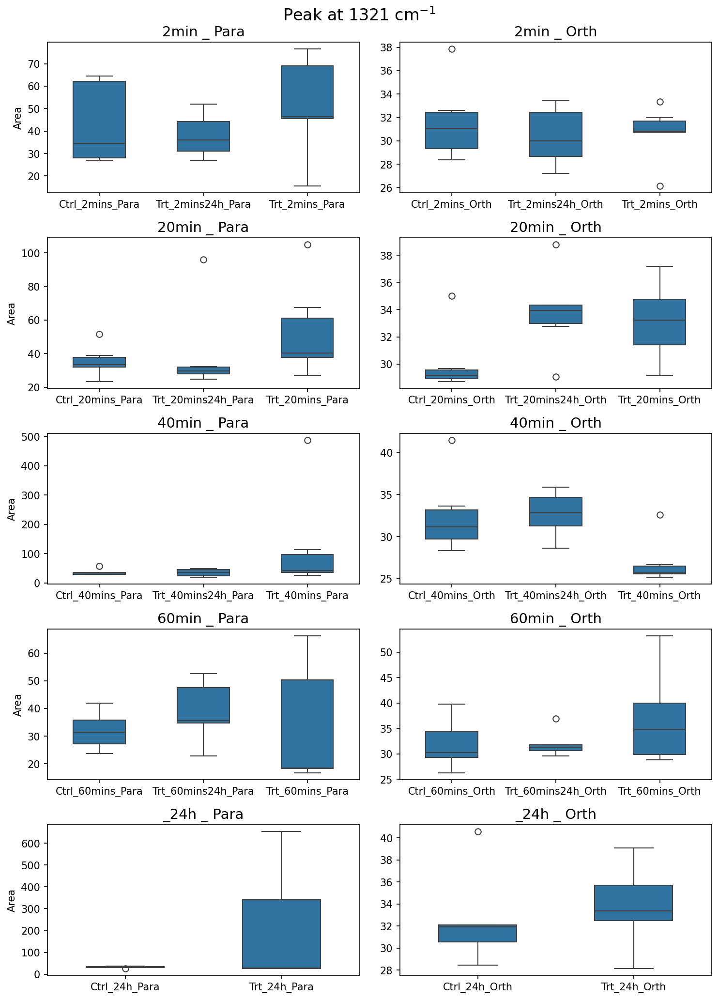

C:\Users\oadeji01\AppData\Local\Temp\ipykernel_27900\2422181490.py:23: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([label.get_text()[9:] for label in ax.get_xticklabels()]);
C:\Users\oadeji01\AppData\Local\Temp\ipykernel_27900\2422181490.py:23: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([label.get_text()[9:] for label in ax.get_xticklabels()]);
C:\Users\oadeji01\AppData\Local\Temp\ipykernel_27900\2422181490.py:23: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([label.get_text()[9:] for label in ax.get_xticklabels()]);
C:\Users\oadeji01\AppData\Local\Temp\ipykernel_27900\2422181490.py:23: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after s

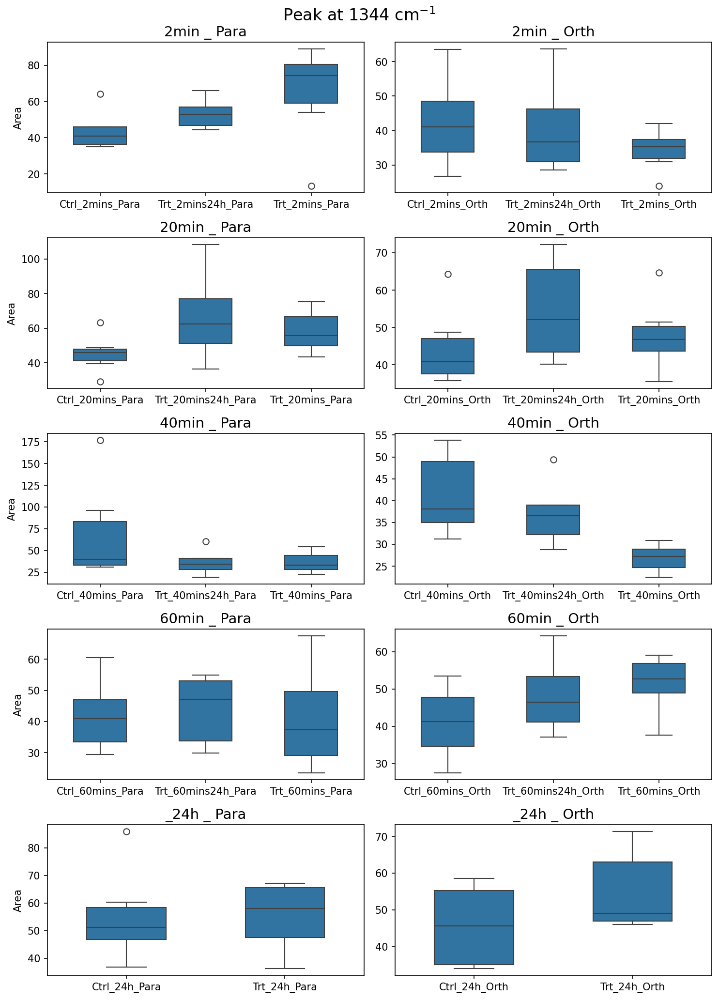

C:\Users\oadeji01\AppData\Local\Temp\ipykernel_27900\2422181490.py:23: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([label.get_text()[9:] for label in ax.get_xticklabels()]);
C:\Users\oadeji01\AppData\Local\Temp\ipykernel_27900\2422181490.py:23: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([label.get_text()[9:] for label in ax.get_xticklabels()]);
C:\Users\oadeji01\AppData\Local\Temp\ipykernel_27900\2422181490.py:23: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([label.get_text()[9:] for label in ax.get_xticklabels()]);
C:\Users\oadeji01\AppData\Local\Temp\ipykernel_27900\2422181490.py:23: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after s

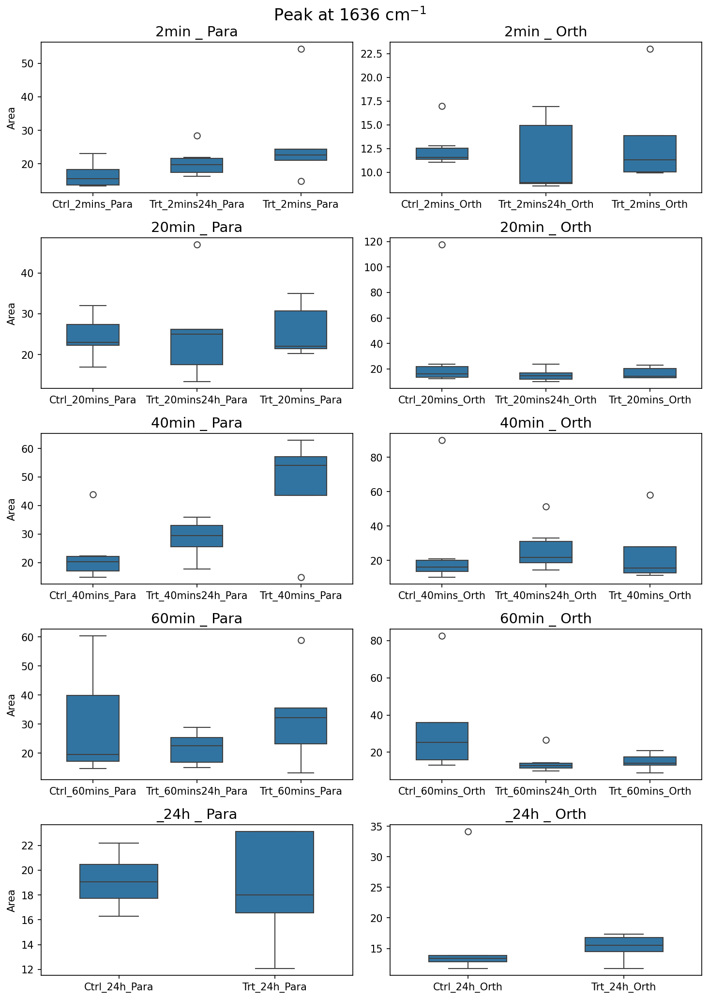

C:\Users\oadeji01\AppData\Local\Temp\ipykernel_27900\2422181490.py:23: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([label.get_text()[9:] for label in ax.get_xticklabels()]);
C:\Users\oadeji01\AppData\Local\Temp\ipykernel_27900\2422181490.py:23: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([label.get_text()[9:] for label in ax.get_xticklabels()]);
C:\Users\oadeji01\AppData\Local\Temp\ipykernel_27900\2422181490.py:23: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([label.get_text()[9:] for label in ax.get_xticklabels()]);
C:\Users\oadeji01\AppData\Local\Temp\ipykernel_27900\2422181490.py:23: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after s

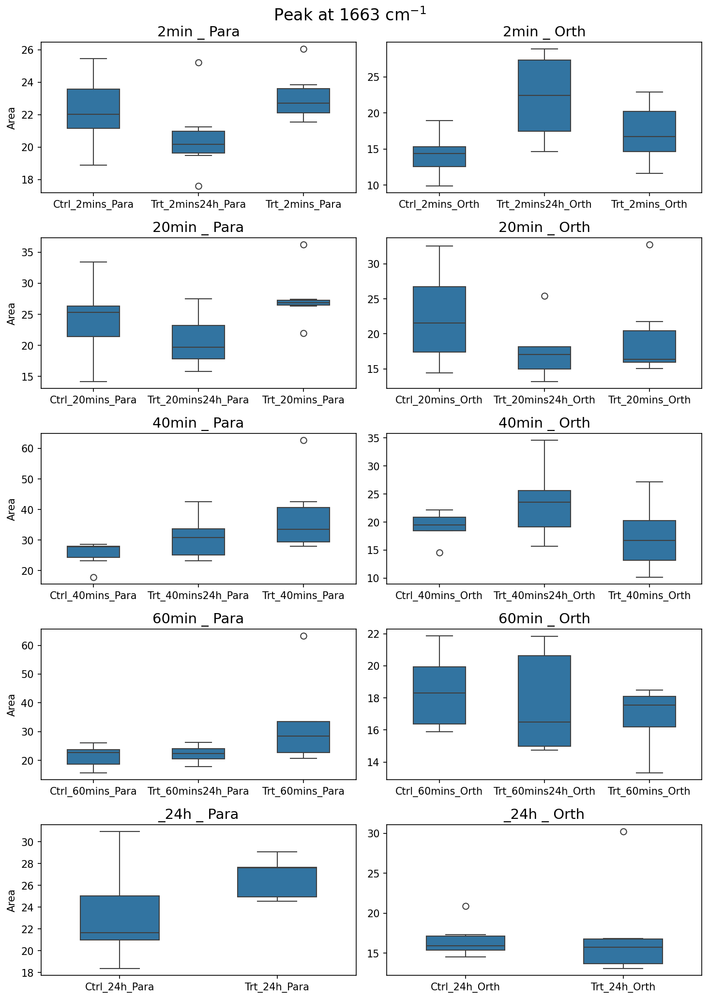

In [ ]:
for p in peak_positions:
    fig, axes = plt.subplots(5, 2, figsize = (10, 14), dpi = 150)
#axes = axes.flatten()


    for i, ort in enumerate(['2min', '20min', '40min', '60min', '_24h']):
        for j, tp in enumerate(['Para', 'Orth']):
            
            ax = axes[i, j]
            subset =  results[
                (results['group'].str.contains(ort)) & 
                (results['group'].str.contains(tp)) & 
                (results['peak_pos'] == p)
                ]
            #print(subset)
            sns.boxplot(
                        data = subset,
                        x = 'group',
                        y = 'area',
                        ax = ax,
                        width = .5
                        );
            ax.set_xticklabels([label.get_text()[9:] for label in ax.get_xticklabels()]);
            ax.set_title(f"{ort} _ {tp}", fontsize=14);
            ax.set_xlabel("");
            ax.set_ylabel("Area" if j == 0 else "");  # only left column shows y-axis label
    plt.suptitle(f"Peak at {p} cm$^{{-1}}$", fontsize = 16);

    plt.tight_layout();
    plt.show();